# <center><b>Tarea 6</b></center>

___

<center><h2><b>Deep Learning with Tensorflow 2 and Keras</b></h2></center>

___

<center><b>Por</b>: Miguel Angel Soto Hernandez</center>

## <center><b>¿Qué es TensorFlow (TF)?</b></center>
<p>TensorFlow es una potente biblioteca de software de código abierto desarrollada por el equipo de Google Brain para redes neuronales profundas, el tema que se trata en este libro. Se puso a disposición por primera vez bajo la Licencia Apache 2.0 en noviembre de 2015 y desde entonces ha crecido rápidamente; en mayo de 2019, su repositorio de GitHub (https://github.com/tensorflow/tensorflow) tiene más de 51.000 commits, con aproximadamente 1.830 colaboradores. Esto en sí mismo proporciona una medida de la popularidad de TensorFlow.

## <center><b>¿Qué es Keras?</b></center>

<p>Keras es una hermosa API para componer bloques de construcción para crear y entrenar modelos de aprendizaje profundo. Keras puede integrarse con múltiples motores de aprendizaje profundo, como Google TensorFlow, Microsoft CNTK, Amazon MxNet y Theano. A partir de TensorFlow 2.0, Keras ha sido adoptado como la API estándar de alto nivel, simplificando en gran medida la codificación y haciendo que la programación sea más intuitiva.

## <center><b>Importaciones necesarias</b></center>

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import cv2, numpy as np
import os
import time
import tensorflow.keras as K
from tensorflow import keras
from tensorflow.keras import Model
from tensorflow.keras.losses import mean_squared_error, mean_absolute_error
from tensorflow.keras import layers, models, datasets, preprocessing
from keras.preprocessing.image import load_img
from keras.utils.vis_utils import plot_model
from keras.preprocessing.image import img_to_array
from keras.applications.vgg16 import VGG16, preprocess_input, decode_predictions
import tensorflow_datasets as tfds
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, UpSampling2D
import argparse
import gensim.downloader as api
import shutil
import gensim.downloader as api
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import shutil
import random
import gym
import matplotlib.animation as animation
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import accuracy_score, confusion_matrix
plt.style.use('dark_background')

## <center><b>Capítulo 1: Fundamentos de redes neuronales con Tensorflow 2.0</b></center>

#### <center><b>Perceptron</b></center>
Es un algoritmo sencillo que, dado un vector de entrada x de m valores $(x_1, x_2, ..., x_m)$, a menudo llamado características de entrada o simplemente características, da como resultado un 1 ("sí") o un 0 ("no").

#### <center><b>Perceptron Multicapa</b></center>
Obsérvese que las capas de entrada y de salida son visibles desde el exterior, mientras que todas las demás capas del centro están ocultas, de ahí el nombre de capas ocultas. En este contexto, una sola capa es simplemente una función lineal y el MLP se obtiene, por tanto, apilando múltiples capas simples una tras otra:

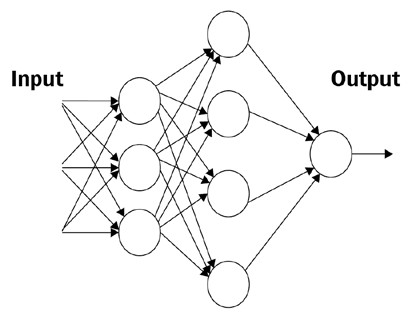

### <center><b>Red neuronal simple</b></center>

In [ ]:
# Parametros de la red y del entrenamiento
epocas = 200
tamano_lote = 128
verbose = 1
#numero de salidas = numero de digitos
num_clases = 10
num_capas_ocultas = 128
# parte del dataset que sera reservado para validacion
division_validacion = 0.2

In [ ]:
# Cargando el dataset MNIST
'''
Se puede comprobar que la división entre datos de entrenamiento y de prueba es 
de 60.000, y 10.000 respectivamente.
Las etiquetas tienen una representación de un solo punto.se aplica automática-
mente mnist = keras.datasets.mnist
'''
mnist = keras.datasets.mnist
(X_train, Y_train), (X_test, Y_test) = mnist.load_data()

In [ ]:
# X_train es 60000 filas de valores de 28x28; nosotros --> lo remodelamos para
# 60000 x 784.
remodelado = 784
X_train = X_train.reshape(60000, remodelado)
X_test = X_test.reshape(10000, remodelado)
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Normalizamos las entradas para que estén dentro de [0, 1].
X_train /= 255
X_test /= 255
print(X_train.shape[0], 'muestras de entrenamiento')
print(X_test.shape[0], 'muestras de prueba')

60000 muestras de entrenamiento
10000 muestras de prueba


In [ ]:
# Representacion one-hot de las etiquetas
Y_train = tf.keras.utils.to_categorical(Y_train, num_clases)
Y_test = tf.keras.utils.to_categorical(Y_test, num_clases)

In [ ]:
# Creamos el modelo
modelo = tf.keras.models.Sequential()
modelo.add(keras.layers.Dense(num_clases, input_shape=(remodelado,),
                              name='dense_layer', activation='softmax'))

In [ ]:
# Compilando el modelo
modelo.compile(optimizer='SGD', loss='categorical_crossentropy', 
              metrics=['accuracy'])

In [ ]:
# Entrenando el modelo
modelo.fit(X_train, Y_train, batch_size=tamano_lote, epochs=epocas,
               verbose=verbose, validation_split=division_validacion)

In [ ]:
# Evaluando el modelo
perdida_test, exactitud_test = modelo.evaluate(X_test, Y_test)
print('Exactitud del test:', exactitud_test)
print(modelo.summary())

313/313 [==============================] - 1s 2ms/step - loss: 0.2778 - accuracy: 0.9215
Exactitud del test: 0.921500027179718
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 10)                7850      
Total params: 7,850
Trainable params: 7,850
Non-trainable params: 0
_________________________________________________________________
None


### <center><b>Mejorando la red simple con dropout</b></center>

Decidimos descartar aleatoriamente con la probabilidad **_DROPOUT_** algunos de los valores propagados dentro de nuestra red densa interna de capas ocultas durante el entrenamiento. En el aprendizaje automático, ésta es una forma bien conocida de regularización. Sorprendentemente, esta idea de descartar aleatoriamente algunos valores puede mejorar nuestro rendimiento. La idea que subyace a esta mejora es que el abandono aleatorio obliga a la red a aprender patrones redundantes que son útiles para una mejor generalización

In [ ]:
# Parametros de la red y del entrenamiento
epocas = 20
tamano_lote = 512
verbose = 1
#numero de salidas = numero de digitos
num_clases = 10
num_capas_ocultas = 128
# parte del dataset que sera reservado para validacion
division_validacion = 0.2
dropout = 0.3

In [ ]:
# Creando el modelo
modelo_mejorado = tf.keras.models.Sequential()
modelo_mejorado.add(keras.layers.Dense(num_capas_ocultas, input_shape=(remodelado,), 
                                       name='dense_layer', activation='relu'))
modelo_mejorado.add(keras.layers.Dropout(dropout))
modelo_mejorado.add(keras.layers.Dense(num_capas_ocultas, name='dense_layer_2', 
                                       activation='relu'))
modelo_mejorado.add(keras.layers.Dropout(dropout))
modelo_mejorado.add(keras.layers.Dense(num_clases, name='dense_layer_3', 
                                       activation='softmax'))

In [ ]:
# Resumen del modelo
modelo_mejorado.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 128)               100480    
_________________________________________________________________
dropout (Dropout)            (None, 128)               0         
_________________________________________________________________
dense_layer_2 (Dense)        (None, 128)               16512     
_________________________________________________________________
dropout_1 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_layer_3 (Dense)        (None, 10)                1290      
Total params: 118,282
Trainable params: 118,282
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# Compilando el modelo
modelo_mejorado.compile(optimizer='Adam', loss='categorical_crossentropy', 
                        metrics=['accuracy'])

In [ ]:
# Entrenando el modelo
modelo_mejorado.fit(X_train, Y_train, batch_size=tamano_lote, epochs=epocas,
          verbose=verbose, validation_split=division_validacion)

In [ ]:
# Evaluando el modelo
perdida_test_1, exactitud_test_1 = modelo_mejorado.evaluate(X_test, Y_test)
print('Exactitud test:', exactitud_test_1)

313/313 [==============================] - 1s 2ms/step - loss: 0.0738 - accuracy: 0.9780
Exactitud test: 0.9779999852180481


### <center><b>Comparación entre ambos modelos</b></center>

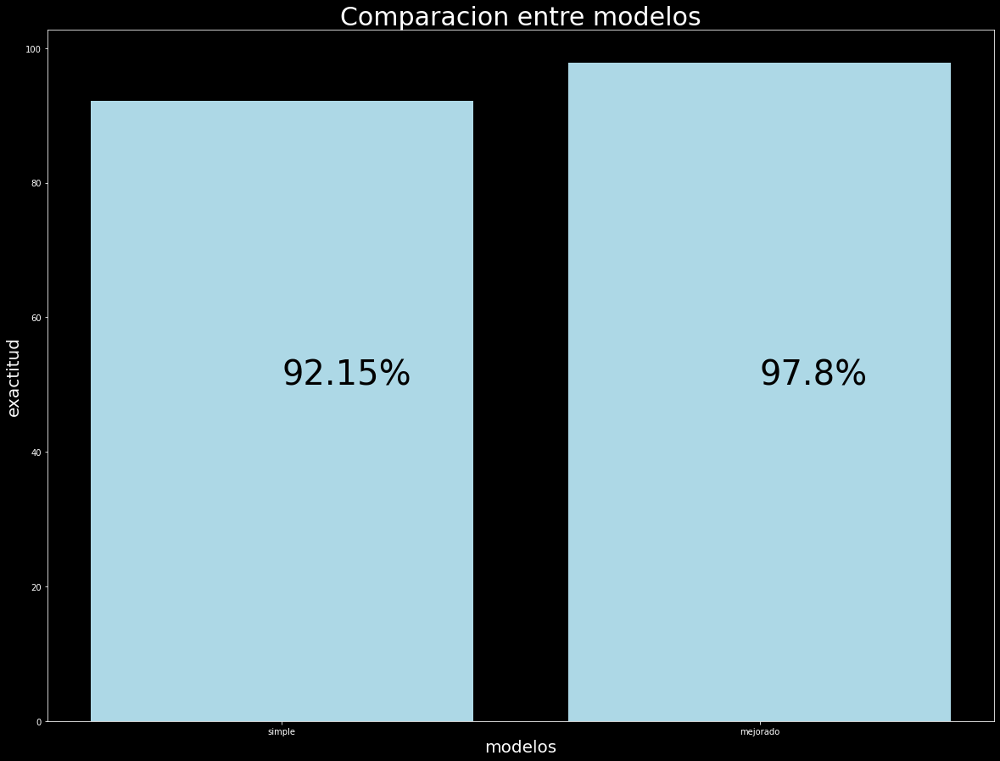

In [ ]:
figura = plt.figure(figsize=(20, 15))
ax = figura.add_subplot()
modelos = ['simple', 'mejorado']
y = [exactitud_test * 100, exactitud_test_1 * 100]
plt.title('Comparacion entre modelos', fontsize=30)
plt.bar(modelos, y, color='lightblue')
ax.text(modelos[0], 50, f'{round(exactitud_test * 100, 2)}%', color='black', 
        fontsize=40)
ax.text(modelos[1], 50, f'{round(exactitud_test_1 * 100, 2)}%', color='black', 
        fontsize=40)
ax.set_xlabel('modelos', fontsize=20)
ax.set_ylabel('exactitud', fontsize=20)
plt.show()

## <center><b>Capítulo 2: Tensorflow 1.0 y 2.0</b></center>

### <center><b>Entendiendo TensorFlow 1.x</b><center>
Es tradición que el primer programa que uno aprende a escribir en cualquier lenguaje informático sea "hola mundo". ¡Mantenemos la convención en este libro! Comencemos con un programa "Hola Mundo":

```
import tensorflow as tf
mensaje = tf.constant('Biendenido al exitante mundo de las redes neuronales profundas!')
with tf.Session() as sesion:
    print(sesion.run(mensaje).decode())
```

#### <center><b>Estructura del programa de grafos computacionales TensorFlow 1.x</b></center>

TensorFlow 1.x es diferente a otros lenguajes de programación. Primero tenemos que construir un plano de la red neuronal que queremos crear. Esto se logra dividiendo el programa en dos partes separadas: la definición de un grafo computacional y su ejecución.

#### <center><b>Grafos computacionales</b></center>
Un grafo computacional es una red de nodos y aristas. En él, todos los datos que se van a utilizar, es decir, los objetos tensoriales (constantes, variables, marcadores de posición), y todos los cálculos que se van a realizar, es decir, los objetos de operación. Cada nodo puede tener cero o más entradas pero sólo una salida. Los nodos del grafo representan objetos (tensores y operaciones), y las aristas representan los tensores que fluyen entre operaciones. El grafo computacional define el esquema de la red neuronal, pero pero los tensores que contiene aún no tienen ningún "valor" asociado.

Para construir un gráfico computacional, definimos todas las constantes, variables y operaciones que necesitamos realizar. En las siguientes secciones describimos la estructura utilizando un ejemplo sencillo de definición y ejecución de un grafo para sumar dos vectores.

#### <center><b>Ejecución del grafo</b></center>
La ejecución del grafo se realiza mediante el objeto sesión, que encapsula el entorno en el que se evalúan los objetos tensor y operación. Este es el lugar donde se realizan los cálculos y las transferencias de información de una capa a otra. de una capa a otra. Los valores de los diferentes objetos tensoriales se inicializan, acceden y se guardan sólo en un objeto de sesión. Hasta este punto, los objetos tensoriales eran sólo definiciones abstractas. Aquí, cobran vida.

### <center><b>Entendiendo TensorFlow 2.x</b><center>

TensorFlow 2.x recomienda el uso de una API de alto nivel como tf.keras, pero deja las APIs de bajo nivel típicas de TensorFlow 1.x para cuando haya necesidad de tener más control sobre los detalles internos. tf.keras y TensorFlow 2.x vienen con algunos grandes beneficios.

#### <center><b>APIs de Keras - tres modelos de programación</b></center>

TensorFlow 1.x proporciona una API de nivel inferior. Se construyen modelos creando primero un gráfico de operaciones, que luego se compila y ejecuta. ```tf.keras``` ofrece un nivel superior de API de nivel superior, con tres modelos de programación diferentes: API secuencial, API funcional y Subclasificación de modelos. Los modelos de aprendizaje se crean tan fácilmente como "poner LEGO ® ladrillos juntos", donde cada "ladrillo de lego" es una capa específica de Keras. Veamos cuándo es mejor cuando es mejor usar Secuencial, Funcional, y Subclasificación, y nota que puedes mezclar y combinar los tres estilos de acuerdo a sus necesidades específicas.

La **API Secuencial** es un modelo muy elegante, intuitivo y conciso que es apropiado en el 90% de los casos. En el capítulo anterior, cubrimos un ejemplo de uso de la API Secuencial cuando discutimos el código MNIST, así que vamos a crear el ladrillo con: ```tf.keras.utils.plot_model(model, to_file="model.png")```

La **API Funcional** es útil cuando se quiere construir un modelo con topologías más complejas (no lineales), incluyendo múltiples entradas, múltiples salidas, conexiones residuales con flujos no secuenciales, y capas compartidas y reutilizables. Cada capa es invocable (con un tensor en la entrada), y cada capa devuelve un tensor como salida. Veamos un ejemplo en el que tenemos dos entradas separadas, dos regresiones logísticas separadas como salidas, y un módulo compartido en el medio.

La **subclasificación de modelos** ofrece la mayor flexibilidad y se utiliza generalmente cuando necesita definir su propia capa. En otras palabras, es útil cuando usted está en construir su propio ladrillo lego especial en lugar de componer ladrillos más ladrillos estándar y conocidos. En efecto, tiene un coste mayor en términos de complejidad y, por lo tanto, la subclasificación debe utilizarse sólo cuando sea realmente necesario. En la mayoría de de las situaciones, las APIs secuenciales y funcionales son más apropiadas, pero se puede utilizar la subclasificación de modelos si se prefiere pensar de forma orientada a objetos, como el desarrollador típico de Python/NumPy.

 Secuencial | Funcional
 --- | ---
 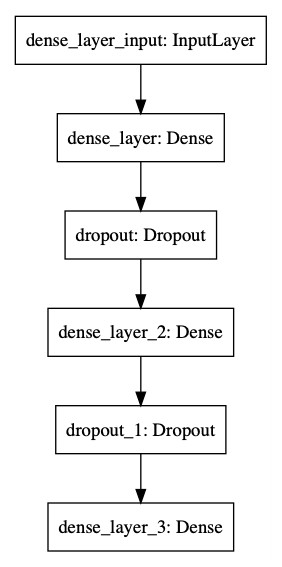| 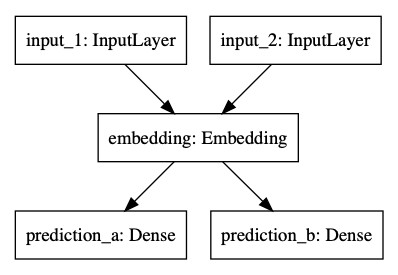

### Ejemplo

In [ ]:
num_ejemplos_entrenamiento = 1024 * 1024
num_caracteristicas = 10
tamano_lotes = 256

In [ ]:
# 10 floats aleatorios en el intervalo semiabierto [0,0, 1,0).
x = np.random.random((num_ejemplos_entrenamiento, num_caracteristicas))
y = np.random.randint(2, size=(num_ejemplos_entrenamiento, 1))
x = tf.dtypes.cast(x, tf.float32)
print(x)
dataset = tf.data.Dataset.from_tensor_slices((x, y))
dataset = dataset.shuffle(buffer_size=num_ejemplos_entrenamiento).batch(tamano_lotes)

tf.Tensor(
[[0.0209894  0.6761049  0.6530124  ... 0.1553956  0.70707166 0.64202416]
 [0.6383323  0.37810874 0.341289   ... 0.33808923 0.4330578  0.16530506]
 [0.7176862  0.9420092  0.41493842 ... 0.36268577 0.23151688 0.75904804]
 ...
 [0.9948152  0.11786634 0.949553   ... 0.66389066 0.08679943 0.8436418 ]
 [0.5946469  0.1208947  0.37768248 ... 0.61912566 0.6538369  0.95585364]
 [0.593012   0.41849777 0.38041112 ... 0.1589678  0.96458066 0.15822788]], shape=(1048576, 10), dtype=float32)


In [ ]:
# esta es la estrategia de distribución
distribucion = tf.distribute.MirroredStrategy()

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# este fragmento de código se distribuye a múltiples GPUs
with distribucion.scope():
  modelo = tf.keras.Sequential()
  modelo.add(tf.keras.layers.Dense(16, activation='relu', input_shape=(num_caracteristicas,)))
  modelo.add(tf.keras.layers.Dense(1, activation='sigmoid'))
  optimizer = tf.keras.optimizers.SGD(0.2)
  modelo.compile(loss='binary_crossentropy', optimizer=optimizer)

modelo.summary()

INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16)                176       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 193
Trainable params: 193
Non-trainable params: 0
________________________

In [ ]:
# Optimiza de la forma habitual, pero en realidad estás usando GPUs
modelo.fit(dataset, epochs=5, steps_per_epoch=100)

Epoch 1/5
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
100/100 [==============================] - 3s 3ms/step - loss: 0.6976
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
Epoch 2/5
100/100 [==============================] - 0s 3ms/step - loss: 0.6950


## <center><b>Capitulo 3: Regresión</b></center>
La regresión es una de las herramientas más antiguas para el modelado matemático, la clasificación y la predicción, pero sigue siendo muy potente. La regresión se aplica en diversos campos que van desde la ingeniería, las ciencias físicas, la biología y el mercado financiero hasta las ciencias sociales. Es una herramienta fundamental en manos de los estadísticos y los científicos de datos. En este capítulo, trataremos los siguientes temas:
- Regresión lineal
- Diferentes tipos de regresión lineal
- Regresión logística
- Aplicar la regresión lineal para estimar el precio de una casa
- Aplicar la regresión logística para identificar dígitos escritos a mano

### <center><b>¿Qué es la regresión?</b></center>
La regresión es normalmente el primer algoritmo con el que trabaja la gente en el aprendizaje automático. Nos permite hacer predicciones a partir de los datos aprendiendo sobre la relación entre un conjunto dado de variables dependientes e independientes. Se utiliza en casi todos los campos; cualquier lugar que tenga interés en establecer relaciones entre dos o más cosas encontrará un uso para la regresión.

*   List item
*   List item



### <center><b>Predicción mediante regresión lineal</b></center>
La regresión lineal es una de las técnicas de modelización más conocidas. Existe desde hace más de 200 años y se ha explorado desde casi todos los ángulos posibles. La regresión lineal supone una relación lineal entre la variable de entrada (X) y la variable de salida (Y). Se trata de encontrar una ecuación lineal para el valor predicho Y de la forma:

<center>$Y_{hat} = W^TX+B$</center>

Donde $X = {x_1, x_2, ..., x_n}$ son las n variables de entrada, y $W = {w_1, w_2, ...w_n}$ son los coeficientes lineales, con b como término de sesgo. El término de sesgo permite que nuestro modelo de regresión proporcione una salida incluso en ausencia de cualquier entrada; nos proporciona una opción para desplazar nuestros datos a la izquierda o a la derecha para ajustarlos mejor. El error entre los valores observados (Y) y los valores predichos (Yhat) para una muestra de entrada i es:

<center>$e_i = Y_i-Y_{hat_i}$</center>

### <center><b>Estimadores de TensorFlow</b></center>
TensorFlow proporciona Estimadores como APIs de alto nivel, para proporcionar soluciones escalables y escalables y orientadas a la producción. Se encargan de todas las actividades detrás de la escena como como la creación de gráficos computacionales, la inicialización de las variables, el entrenamiento del modelo guardar los puntos de control y registrar los archivos TensorBoard. TensorFlow proporciona dos tipos de Estimadores:
- **Estimadores enlatados**: Se trata de estimadores prefabricados disponibles en el módulo de estimadores de módulo de estimadores de TensorFlow. Son modelos en una caja; sólo hay que pasarles las características de entrada y están listos para ser utilizados. Algunos ejemplos son Linear Classifier, Linear Regressor, DNN Classifier, etc.
- **Estimadores personalizados**: Los usuarios también pueden crear sus propios estimadores a partir de los modelos que construyen en TensorFlow Keras. Estos son Estimadores definidos por el usuario.

### <center><b>Tareas de clasificación y decisión límites de decisión</b></center>
- En la clasificación los datos se agrupan en clases/categorías, mientras que en la regresión el objetivo es obtener un valor numérico continuo para unos datos dados.
- Por ejemplo, identificar el número de dígitos escritos a mano es una tarea de clasificación; todos los dígitos escritos a mano pertenecerán a uno de los diez números comprendidos entre [0-9]. La tarea de predecir el precio de la vivienda en función de diferentes variables de entrada es una tarea de regresión.
-En la tarea de clasificación, el modelo encuentra los límites de decisión que separan una clase de otra. En la tarea de regresión, el modelo aproxima una función que se ajusta a la relación entrada-salida.
- La clasificación es un subconjunto de la regresión; aquí estamos prediciendo clases. La regresión es mucho más general.

### Ejemplo

In [ ]:
# cargar y entrenar los datos
((data_entrenamiento, etiquetas_entrenamiento), 
 (data_evaluacion, etiquetas_evaluacion)) = tf.keras.datasets.mnist.load_data()

In [ ]:
# Pre-procesar los datos
etiquetas_entrenamiento = etiquetas_entrenamiento.astype(np.int32)  

data_evaluacion = data_evaluacion / np.float32(255)
etiquetas_evaluacion = etiquetas_evaluacion.astype(np.int32)

In [ ]:
# Utilizar el módulo feature_column de TensorFlow para definir características 
# numéricas de tamaño 28×28
columnas_caracteristica = [tf.feature_column.numeric_column("x", shape=[28, 28])]

In [ ]:
'''
Crear el estimador de regresión logística. Utilizamos un simple 
LinearClassifier. Le animamos a experimentar con DNNClassifier también
'''
clasificador = tf.estimator.LinearClassifier(
    feature_columns=columnas_caracteristica,
    n_classes=10,model_dir="mnist_model/")

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'mnist_model/', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_experimental_max_worker_delay_secs': None, '_session_creation_timeout_secs': 7200, '_checkpoint_save_graph_def': True, '_service': None, '_cluster_spec': ClusterSpec({}), '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}


In [ ]:
# Creando una funcion de entrada para alimentar el estimador
func_entrenamiento_entrada = tf.compat.v1.estimator.inputs.numpy_input_fn(
        x={"x": data_entrenamiento}, y=etiquetas_entrenamiento, batch_size=100, 
        num_epochs=None, shuffle=True)

In [ ]:
# Entrenando el clasificador
clasificador.train(input_fn=func_entrenamiento_entrada, steps=10)

Instructions for updating:
Use Variable.read_value. Variables in 2.X are initialized automatically both in eager and graph (inside tf.defun) contexts.
Instructions for updating:
To construct input pipelines, use the `tf.data` module.
Instructions for updating:
To construct input pipelines, use the `tf.data` module.
INFO:tensorflow:Calling model_fn.


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Instructions for updating:
To construct input pipelines, use the `tf.data` module.
INFO:tensorflow:Calling checkpoint listeners before saving checkpoint 0...
INFO:tensorflow:Saving checkpoints for 0 into mnist_model/model.ckpt.
INFO:tensorflow:Calling checkpoint listeners after saving checkpoint 0...
INFO:tensorflow:loss = 2.3025851, step = 0
INFO:tensorflow:Calling checkpoint listeners before saving checkpoint 10...
INFO:tensorflow:Saving checkpoints for 10 into mnist_model/model.ckpt.
INFO:tensorflow:Calling checkpoint listeners after saving checkpoint 10...
INFO:tensorflow:Loss for final step: 173.70601.


In [ ]:
# Creamos la funcion de entrada para los datos de validacion
func_validacion_entrada =  tf.compat.v1.estimator.inputs.numpy_input_fn(
        x={"x": data_evaluacion}, y=etiquetas_evaluacion, num_epochs=1, 
        shuffle=False)

In [ ]:
# Evaluamos el clasificador lineal con la data de validacion
resultados_evaluacion = clasificador.evaluate(input_fn=func_validacion_entrada)
print(resultados_evaluacion)

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2021-04-14T04:02:06Z


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from mnist_model/model.ckpt-10
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Inference Time : 0.35223s
INFO:tensorflow:Finished evaluation at 2021-04-14-04:02:06
INFO:tensorflow:Saving dict for global step 10: accuracy = 0.8108, average_loss = 0.8457345, global_step = 10, loss = 0.8383269
INFO:tensorflow:Saving 'checkpoint_path' summary for global step 10: mnist_model/model.ckpt-10
{'accuracy': 0.8108, 'average_loss': 0.8457345, 'loss': 0.8383269, 'global_step': 10}


## <center><b>Capítulo 4: Redes Neuronales Convolucionales Profundas (DCNN)</b></center>
Una red neuronal convolucional profunda (DCNN) consta de muchas capas de red neuronal. Normalmente se alternan dos tipos de capas diferentes, las convolucionales y las de agrupación (es decir, de submuestreo). La profundidad de cada filtro aumenta de izquierda a derecha en la red. La última etapa suele estar formada por una o varias capas totalmente conectadas:
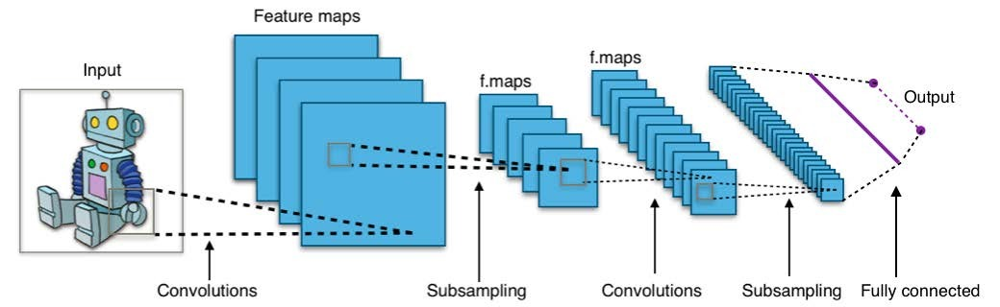


### <center><b>Un ejemplo de DCNN - LeNet</b></center>
Yann LeCun, que ha ganado recientemente el premio Turing, propuso una familia de redes de convolución llamada LeNet, entrenada para reconocer los caracteres manuscritos MNIST con robustez a las transformaciones geométricas simples y a la distorsión. La idea central de las LeNets es tener capas inferiores que alternan operaciones de convolución con operaciones de maxpooling. Las operaciones de convolución se basan en campos receptivos locales cuidadosamente elegidos con pesos compartidos para múltiples mapas de características. A continuación, los niveles superiores están totalmente conectados y se basan en un MLP tradicional con capas ocultas y softmax como capa de salida.

### <center><b>Recognizing CIFAR-10 images with deep learning</b><?center>
The CIFAR-10 dataset contains 60,000 color images of 32×32 pixels in 3 channels, divided in 10 classes. Each class contains 6,000 images. The training set contains 50,000 images, while the test sets provides 10,000 images.

El objetivo es reconocer imágenes no vistas anteriormente y asignarlas a una de las 10 clases, las cuales son:
* airplane
* automobile
* bird
* cat
* deer
* dog
* frog
* horse
* ship
* truck


### <center><b>Redes convolucionales muy profundas para el reconocimiento de imágenes a gran escala</b></center>

Durante 2014, se presentó una interesante contribución al reconocimiento de imágenes con el artículo Very Deep Convolutional Networks for Large-Scale Image Recognition, K.Simonyan y A. Zisserman. El documento mostró que una "mejora significativa en las configuraciones del arte anterior se puede lograr empujando la profundidad a 16-19 capas de peso." Uno de los modelos del artículo, denominado D o VGG-16, tenía 16 capas de profundidad. 

Se utilizó una implementación en Java Caffe
para entrenar el modelo en el conjunto de datos ImageNet ILSVRC-2012, que incluye imágenes de 1.000 clases y está dividido en tres conjuntos: entrenamiento (1,3 millones de imágenes), validación (50.000 imágenes) y prueba (100.000 imágenes). Cada imagen es de (224×224) en 3 canales. El modelo alcanza un error del 7,5% en el ILSVRC-2012-val, y un error del 7,4% en el ILSVRC-2012-test.

Según el sitio de ImageNet, "el objetivo de esta competición es estimar el contenido de las fotografías con fines de recuperación y anotación automática utilizando un subconjunto del gran conjunto de datos ImageNet etiquetado a mano (10.000.000 de imágenes etiquetadas que representan más de 10.000 categorías de objetos) como entrenamiento. Las imágenes de prueba se presentarán con sin anotación inicial -sin segmentación ni etiquetas- y los algoritmos tendrán que etiquetados que especifiquen qué objetos están presentes en las imágenes".


### <center><b>Ejemplo: Reconociendo imagenes con una red VGG16</b></center>

El modelo VGG16, es un modelo con multiples capas y el poder computacional que requiere para entrenarlo es muy alto, por lo que para poder realizar un ejemplo es necesario descargar el modelo pre-entrenado o importarlo directamente de los modelos de Keras. 
Sin embargo, si tiene curiosidad, el código del modelo es el siguiente:
```
def VGG_16(ruta_de_pesos=None):
    modelo = models.Sequential()
    modelo.add(layers.ZeroPadding2D((1,1),input_shape=(224,224, 3)))
    modelo.add(layers.Convolution2D(64, (3, 3), activation='relu'))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(64, (3, 3), activation='relu'))
    modelo.add(layers.MaxPooling2D((2,2), strides=(2,2)))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(128, (3, 3), activation='relu'))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(128, (3, 3), activation='relu'))
    modelo.add(layers.MaxPooling2D((2,2), strides=(2,2)))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(256, (3, 3), activation='relu'))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(256, (3, 3), activation='relu'))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(256, (3, 3), activation='relu'))
    modelo.add(layers.MaxPooling2D((2,2), strides=(2,2)))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(512, (3, 3), activation='relu'))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(512, (3, 3), activation='relu'))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(512, (3, 3), activation='relu'))
    modelo.add(layers.MaxPooling2D((2,2), strides=(2,2)))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(512, (3, 3), activation='relu'))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(512, (3, 3), activation='relu'))
    modelo.add(layers.ZeroPadding2D((1,1)))
    modelo.add(layers.Convolution2D(512, (3, 3), activation='relu'))
    modelo.add(layers.MaxPooling2D((2,2), strides=(2,2)))
    modelo.add(layers.Flatten())

    # capa superior de la red VGG
    modelo.add(layers.Dense(4096, activation='relu'))
    modelo.add(layers.Dropout(0.5))
    modelo.add(layers.Dense(4096, activation='relu'))
    modelo.add(layers.Dropout(0.5))
    modelo.add(layers.Dense(1000, activation='softmax'))

    # por si tenemos el modelo pre-entrenado
    if ruta_de_pesos:
      modelo.load_weights(ruta_de_pesos)

    return modelo
```

In [ ]:
# Creamos nuestro modelo
modelo = VGG16()

553467904/553467096 [==============================] - 3s 0us/step


In [ ]:
# Imprimimos el resumen del modelo para observar que capas contiene
print(modelo.summary())

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

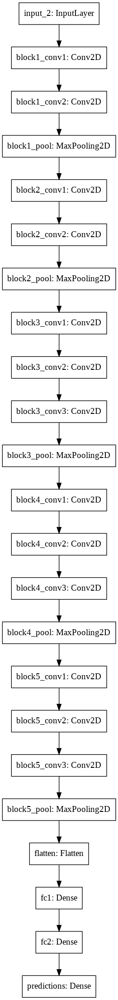

In [ ]:
# Ploteamos el gradico correspondiente a nuestro modelo
plot_model(modelo, to_file='vgg.png')


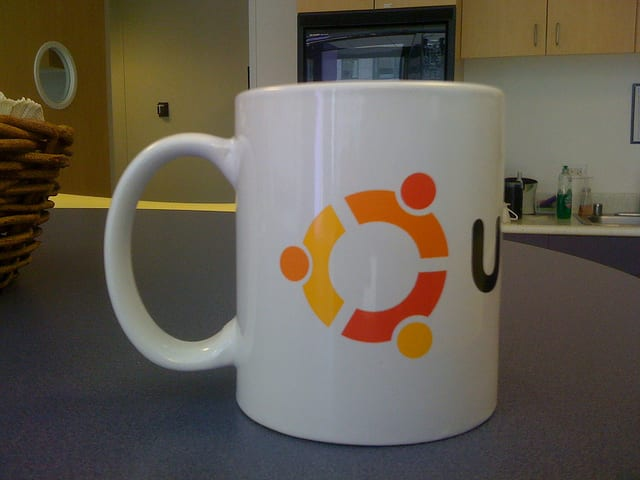

In [ ]:
# cargar una imagen
image = load_img('/content/Coffee-Mug.jpg', target_size=(224, 224))
# convertit los pixeles de la imagen a un array de numpy
image = img_to_array(image)
# reformar los datos para el modelo
image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
# preparar la imagen para el modelo VGG16
image = preprocess_input(image)
# predecir la probabilidad a traves de todas las clases de salida
yhat = modelo.predict(image)
# convertir las probabilidades a las etiquetas de la clase
label = decode_predictions(yhat)
# regresar el calor con mayor probabilidad
label = label[0][0]
# imprimir la clasificacion del modelo
print('%s (%.2f%%)' % (label[1], label[2]*100))

coffee_mug (70.11%)


## <center><b>Capítulo 5: Redes Neuronales Convolucionales Avanzadas</b></center>

### <center><b>Composición de las CNN para tareas complejas</b></center>
A estas alturas, probablemente esté convencido de la eficacia de la arquitectura de las CNN para las tareas de clasificación de imágenes. Sin embargo, lo que puede sorprenderte es que la arquitectura básica de las CNN puede componerse y ampliarse de varias maneras para resolver una variedad de tareas más complejas.


### <center><b>Visión por computadora</b></center>
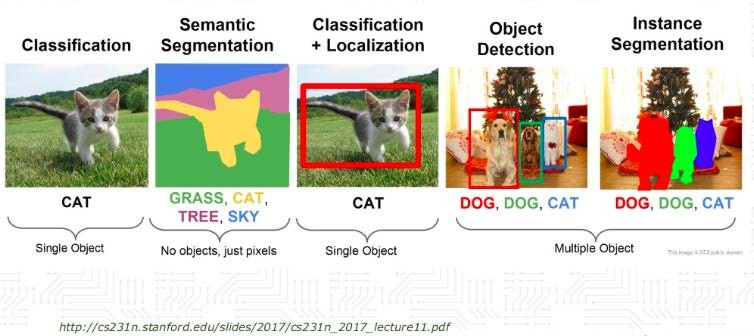

### <center><b>Video</b></center>

La clasificación de vídeos es un área de investigación activa debido a la gran cantidad de datos necesarios para procesar este tipo de medios. Los requisitos de memoria alcanzan con frecuencia los límites de las GPU modernas y podría ser necesaria una forma distribuida de entrenamiento en múltiples máquinas. Actualmente, los investigadores están explorando diferentes direcciones de investigación, con niveles de complejidad crecientes desde el primer enfoque hasta el sexto, descritos a continuación:

* El primer enfoque consiste en clasificar un fotograma de vídeo a la vez considerando cada uno de ellos como una imagen independiente procesada con una CNN 2D. Este enfoque simplemente reduce el problema de clasificación de vídeo a un problema de clasificación de imágenes. Cada fotograma de vídeo "emite" una salida de clasificación, y el vídeo se clasifica teniendo en cuenta la categoría más frecuentemente elegida para cada fotograma.

* El segundo enfoque consiste en crear una única red en la que se combina una CNN 2D con una RNN. La idea es que la CNN tenga en cuenta los componentes de la imagen y la RNN tenga en cuenta la información de la secuencia de cada vídeo. Este tipo de red puede ser muy difícil de entrenar debido al elevado número de parámetros que hay que optimizar.

* El tercer enfoque consiste en utilizar una ConvNet 3D, donde las ConvNets 3D son una extensión de las ConvNets 2D que operan sobre un tensor 3D (tiempo, ancho_de_imagen, alto_de_imagen). Este enfoque es otra extensión natural de la clasificación de imágenes. De nuevo, las ConvNets 3D pueden ser difíciles de entrenar.

* El cuarto enfoque se basa en una idea inteligente: en lugar de utilizar las CNN directamente para la clasificación, pueden utilizarse para almacenar características fuera de línea para cada fotograma del vídeo. La idea es que la extracción de características se puede hacer muy eficiente con el aprendizaje de transferencia, como se muestra en un capítulo anterior. Una vez extraídas todas las características, se pueden pasar como un conjunto de entradas a una RNN, que aprenderá secuencias a través de múltiples fotogramas y emitirá la clasificación final.

* El quinto enfoque es una simple variante del cuarto, donde la capa final es un MLP en lugar de una RNN. En ciertas situaciones, este enfoque puede ser más sencillo y menos costoso en términos de requisitos computacionales.

* El sexto enfoque es una variante del cuarto, en el que la fase de extracción de características se realiza con una CNN 3D que extrae características espaciales y visuales. Estas características se pasan a una RNN o a un MLP.


### <center><b>Documentos de texto</b></center>
¿Qué tienen en común el texto y las imágenes? A primera vista: muy poco. Sin embargo, si representamos representamos una frase o un documento como una matriz, esta matriz no es muy diferente de una matriz de imagen en la que cada celda es un píxel. Así que la siguiente pregunta es: ¿cómo podemos representar un texto como una matriz?

Pues es bastante sencillo: cada fila de una matriz es un vector que representa una unidad básica del texto. Por supuesto, ahora tenemos que definir qué es una unidad básica. Una opción sencilla podría ser decir que la unidad básica es un carácter. Otra opción sería decir que una unidad básica es una palabra, y otra opción es agregar palabras similares juntas y luego denotar cada agregación (a veces llamada agrupación o incrustación) con un símbolo representativo.

Tenga en cuenta que, independientemente de la elección específica adoptada para nuestras unidades básicas, necesitamos tener un mapa 1:1 de las unidades básicas en IDs enteros para que un texto pueda ser visto como una matriz. Por ejemplo, si tenemos un documento con 10 líneas de texto y cada línea es una incrustación de 100 dimensiones, entonces representaremos nuestro texto con una matriz de 10×100. En esta "imagen" tan particular, un "píxel" se enciende si esa frase, X, contiene la incrustación, representada por la posición Y

También puede observar que un texto no es realmente una matriz, sino más bien un vector, porque dos palabras situadas en filas adyacentes del texto tienen muy poco en común. De hecho, esta es una diferencia importante si la comparamos con las imágenes, en las que dos píxeles situados en columnas adyacentes pueden tener cierto grado de correlación.

Ahora te preguntarás: Entiendo que se represente el texto como un vector, pero al hacerlo, perdemos la posición de las palabras. Esta posición debería ser importante, ¿no es así? Pues bien, resulta que en muchas aplicaciones reales, saber que una frase contiene una unidad básica concreta (un carácter, una palabra, un agregado) o no es es una información muy útil, incluso si no sabemos en qué parte de la frase se encuentra esta unidad básica.

### <center><b>Audio y música</b></center>
Entonces, te preguntarás por qué aprender a sintetizar audio es tan difícil. Pues bien, cada sonido digital que oímos se basa en 16.000 muestras por segundo (a veces 48.000 o más) y construir un modelo predictivo en el que aprendamos a reproducir una muestra basándonos en todas las anteriores es un reto muy difícil.


#### <center><b> WaveNet</b></center>
WaveNet es un modelo generativo profundo para producir formas de onda de audio en bruto. Esta tecnología innovadora ha sido introducida por Google DeepMind para enseñar a los ordenadores a hablar, uno de los experimentos mostrados por WaveNet es Text-to-Speech (TTS).

Los sistemas TTS suelen dividirse en dos clases diferentes: Concatenativos y paramétricos.

El TTS concatenado consiste en memorizar primero fragmentos de voz individuales y luego se recombinan cuando hay que reproducir la voz. Sin embargo, este enfoque no no es escalable porque sólo es posible reproducir los fragmentos de voz memorizados y no es posible reproducir nuevos locutores o diferentes tipos de audio sin memorizar los fragmentos desde el principio.

El TTS paramétrico consiste en crear un modelo para almacenar todos los rasgos característicos del audio que se va a sintetizar. Antes de WaveNet, el audio generado con TTS paramétrico TTS paramétrico era menos natural que el TTS concatenado. WaveNet permitió una mejora significativa de audio, en lugar de utilizar algoritmos intermedios de procesamiento de señales, como se hacía antes. algoritmos intermedios de procesamiento de señales como en el pasado.

### Ejemplo

In [ ]:
# Variables 
max_logitud = 200
num_palabras = 10000
dim_embedding = 256
epocas = 20
tamano_lote = 500

In [ ]:
def cargar_data():
	# cargar datos
	(X_train, y_train), (X_test, y_test) = datasets.imdb.load_data(
      num_words=num_palabras)
	# secuencias pad con max_logitud
	X_train = preprocessing.sequence.pad_sequences(X_train, maxlen=max_logitud)
	X_test = preprocessing.sequence.pad_sequences(X_test, maxlen=max_logitud)
	return (X_train, y_train), (X_test, y_test)

In [ ]:
def crear_modelo():
	modelo = models.Sequential()
	# Entrada - Capa de Emedida
	# el modelo tomará como entrada una matriz entera de tamaño (batch, input_length)
	# el modelo tendrá como salida una dimensión (input_length, dim_embedding)
    # el mayor número entero de la entrada no debe ser mayor
    # que n_palabras (tamaño del vocabulario).
	modelo.add(layers.Embedding(num_palabras, dim_embedding, 
                             input_length=max_logitud))
	modelo.add(layers.Dropout(0.3))
	modelo.add(layers.Conv1D(256, 3, padding='valid', activation='relu'))

	#toma el valor máximo de cualquiera de los vectores de características de 
  # cada una de las características de num_palabras
	modelo.add(layers.GlobalMaxPooling1D())
	modelo.add(layers.Dense(128, activation='relu'))
	modelo.add(layers.Dropout(0.5))
	modelo.add(layers.Dense(1, activation='sigmoid'))

	return modelo

In [ ]:
# Cargar data y crear el modelo
(X_train, y_train), (X_test, y_test) = cargar_data()
modelo = crear_modelo()
modelo.summary()

17465344/17464789 [==============================] - 0s 0us/step


<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/datasets/imdb.py:159: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  x_train, y_train = np.array(xs[:idx]), np.array(labels[:idx])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/datasets/imdb.py:160: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 200, 256)          2560000   
_________________________________________________________________
dropout (Dropout)            (None, 200, 256)          0         
_________________________________________________________________
conv1d (Conv1D)              (None, 198, 256)          196864    
_________________________________________________________________
global_max_pooling1d (Global (None, 256)               0         
_________________________________________________________________
dense (Dense)                (None, 128)               32896     
_________________________________________________________________
dropout_1 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 1

In [ ]:
# Compilar el modelo
modelo.compile(optimizer = "adam", loss = "binary_crossentropy",
              metrics = ["accuracy"])

In [ ]:
# Entrenar el modelo
score = modelo.fit(X_train, y_train, epochs= epocas, batch_size = tamano_lote, 
                  validation_data = (X_test, y_test))

Epoch 1/20
50/50 [==============================] - 40s 147ms/step - loss: 0.6810 - accuracy: 0.5558 - val_loss: 0.5055 - val_accuracy: 0.7744
Epoch 2/20
50/50 [==============================] - 7s 143ms/step - loss: 0.4398 - accuracy: 0.8063 - val_loss: 0.3001 - val_accuracy: 0.8722
Epoch 3/20
50/50 [==============================] - 7s 144ms/step - loss: 0.2593 - accuracy: 0.8978 - val_loss: 0.2732 - val_accuracy: 0.8840
Epoch 4/20
50/50 [==============================] - 7s 143ms/step - loss: 0.1622 - accuracy: 0.9462 - val_loss: 0.2634 - val_accuracy: 0.8918
Epoch 5/20
50/50 [==============================] - 7s 144ms/step - loss: 0.0973 - accuracy: 0.9728 - val_loss: 0.2829 - val_accuracy: 0.8886
Epoch 6/20
50/50 [==============================] - 7s 145ms/step - loss: 0.0502 - accuracy: 0.9892 - val_loss: 0.3169 - val_accuracy: 0.8870
Epoch 7/20
50/50 [==============================] - 7s 143ms/step - loss: 0.0274 - accuracy: 0.9955 - val_loss: 0.3452 - val_accuracy: 0.8859
Epoch

In [ ]:
# probar el modelo con los datos de prueba
score = modelo.evaluate(X_test, y_test, batch_size=tamano_lote)
print("\nTest score:", score[0])
print('Test accuracy:', score[1])

50/50 [==============================] - 2s 37ms/step - loss: 0.5572 - accuracy: 0.8839

Test score: 0.5572116374969482
Test accuracy: 0.8839200139045715


## <center><b>Capítulo 6: Redes Generativas Adversariales</b></center>
Los GAN han sido definidos como la idea más interesante de los últimos 10 años en ML por Yann LeCun, uno de los padres del aprendizaje profundo. Los GAN son capaces de aprender a reproducir datos sintéticos que parecen reales. Por ejemplo, los ordenadores pueden aprender a pintar y crear imágenes realistas.
La idea fue propuesta originalmente por Ian Goodfellow (para más información, consulte el tutorial del NIPS 2016): Generative Adversarial Networks, por I. Goodfellow, 2016).

### <center><b>¿Qué es una GAN?</b></center>
La idea clave de la GAN puede entenderse fácilmente si se considera análoga a la "falsificación de obras de arte", que es el proceso de creación de obras de arte que se atribuyen falsamente a a otros artistas, normalmente más famosos. Los GAN entrenan dos redes neuronales simultáneamente. El generador $G(Z)$ es el que realiza la falsificación, y el discriminador $D(Y)$ es el que que puede juzgar el grado de realismo de las reproducciones, basándose en sus observaciones de de las obras de arte auténticas y de las copias. $D(Y)$ toma una entrada Y (por ejemplo, una imagen) y expresa un voto para juzgar cómo de real es la entrada. En general, un valor cercano a 1 denota "real", mientras que un valor cercano a 0 denota "falsificación". $G(Z)$ toma una entrada de ruido aleatorio Z y se entrena para engañar a D y hacerle creer que lo que produce $G(Z)$ es real.

El objetivo del entrenamiento del discriminador $D(Y)$ es maximizar $D(Y)$ para cada imagen de la distribución de datos verdadera, y minimizar $D(Y)$ para cada imagen que no sea de la distribución de datos verdadera. Por lo tanto, $G$ y $D$ juegan juegos opuestos: de ahí el nombre entrenamiento adverso. Obsérvese que entrenamos a $G$ y a $D$ de forma alternativa, donde cada uno de sus objetivos se expresa como una función de pérdida optimizada a través de un gradiente gradiente. El modelo generativo sigue mejorando sus capacidades de falsificación, y el modelo discriminativo sigue mejorando su capacidad de reconocimiento de falsificaciones. La red discriminadora (normalmente una red neuronal convolucional estándar) intenta clasificar si una imagen de entrada es real o generada. La nueva idea importante es La nueva idea importante es retropropagar tanto el discriminador como el generador para ajustar los los parámetros del generador de tal manera que éste pueda aprender a engañar al discriminador más a menudo. Al final, el generador aprenderá a producir imágenes que son indistinguibles de las reales:

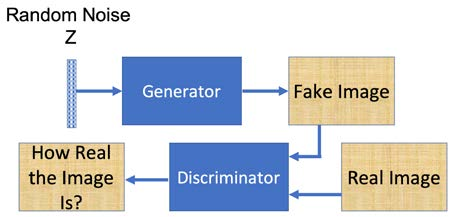

### <center><b>GAN convolucional profunda (DCGAN)</b></center>
Propuestas en 2016, las DCGAN se han convertido en una de las más populares y exitosas arquitecturas GAN. La idea principal del diseño era utilizar capas convolucionales sin el uso de capas de agrupación o las capas de clasificación final. Las capas convolucionales convolucionales y convoluciones transpuestas se emplean para el downsampling y de las imágenes.

Antes de entrar en los detalles de la arquitectura DCGAN y sus capacidades señalemos los principales cambios que se introdujeron en el trabajo:
- La red estaba formada por todas las capas convolucionales. Las capas de agrupación fueron de agrupación se sustituyeron por convoluciones estriadas en el discriminador y convoluciones en el generador.
- Se eliminaron las capas clasificadoras totalmente conectadas después de las convoluciones.
- Para ayudar con el flujo de gradiente, la normalización por lotes se realiza después de cada capa convolucional.

La idea básica de los DCGANs es la misma que la de los GANs vainilla: tenemos un generador que que toma un ruido de 100 dimensiones; el ruido es proyectado y reformado, y luego es se pasa a través de las capas convolucionales. El siguiente diagrama muestra la arquitectura del generador arquitectura:

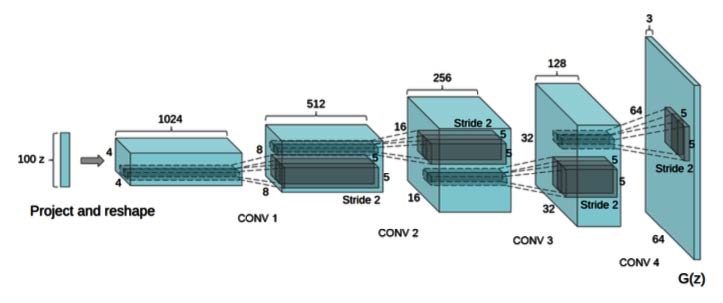

La red discriminadora recibe las imágenes (generadas por el generador o procedentes del conjunto de datos reales) y las somete a una convolución seguida de una normalización por lotes. En cada paso de la convolución, las imágenes se reducen de tamaño mediante pasos. La salida final de la capa convolucional se aplana y alimenta una capa clasificadora de una neurona. En el siguiente diagrama se puede ver el discriminador:

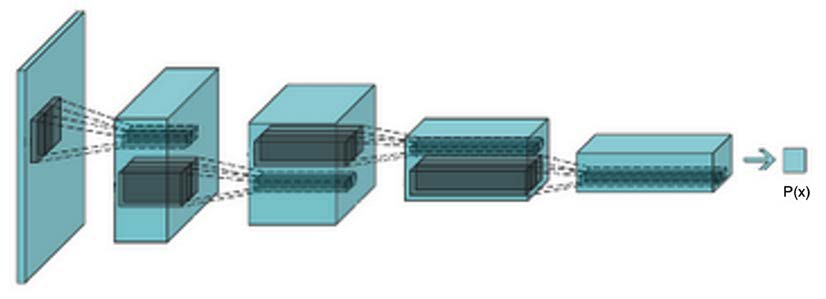

El generador y el discriminador se combinan para formar el DCGAN. El entrenamiento de El entrenamiento se realiza de la misma manera que antes; es decir, primero entrenamos el discriminador en un minilote, luego congelamos el discriminador y entrenamos el generador. El proceso se El proceso se repite de forma iterativa durante unos cuantos miles de épocas. Los autores descubrieron que se obtienen resultados más resultados más estables con el optimizador Adam y una tasa de aprendizaje de 0,002.

### Ejercicio

La API de conjuntos de datos de TensorFlow contiene una lista de conjuntos de datos. Tiene muchos conjuntos de datos emparejados para CycleGANs, como caballo a cebra, manzanas a naranjas, etc. Puede acceder a la lista completa aquí: https://www.tensorflow.org/datasets/catalog/cycle_gan. 

Para nuestro código utilizaremos summer2winter_yosemite, que contiene imágenes de Yosemite (EE.UU.) en verano (conjunto de datos A) y en invierno (conjunto de datos B). Vamos a entrenar el CycleGAN para convertir una imagen de entrada de verano a invierno y viceversa.

In [ ]:
dataset, metadata = tfds.load('cycle_gan/summer2winter_yosemite', 
                              with_info=True, as_supervised=True)
train_A, train_B = dataset['trainA'], dataset['trainB']
test_A, test_B = dataset['testA'], dataset['testB']

Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/2.0.0.incompleteOK2CSX/cycle_gan-trainA.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/2.0.0.incompleteOK2CSX/cycle_gan-trainB.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/2.0.0.incompleteOK2CSX/cycle_gan-testA.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/2.0.0.incompleteOK2CSX/cycle_gan-testB.tfrecord


Dataset cycle_gan downloaded and prepared to /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/2.0.0. Subsequent calls will reuse this data.


In [ ]:
# definimos nuestros parámetros 
tamano_buffer = 1000
tamano_lote = 1
img_ancho = 256
img_alto = 256
epocas = 50

In [ ]:
# normalizamos las imagens antes de entrenar nuestra red
# para un mejor performance podemos agregar jitter a las imagenes
def normalizar(imagen_entrada, etiqueta): 
  imagen_entrada = tf.cast(imagen_entrada, tf.float32)
  imagen_entrada = (imagen_entrada / 127.5) - 1
  return imagen_entrada

La función anterior, aplicada a las imágenes, las normalizará en el rango [-1,1]. Apliquemos esto a nuestros conjuntos de datos de entrenamiento y prueba y creemos un generador de datos que proporcione imágenes para el entrenamiento en lotes

In [ ]:
'''
En el código anterior el argumento num_parallel_calls permite beneficiarse de 
múltiples núcleos de CPU en el sistema, se debe establecer su valor al número 
de núcleos de CPU en su sistema. Si no estás seguro, utiliza el valor 
AUTOTUNE = tf.data. experimental.AUTOTUNE para que TensorFlow determine 
dinámicamente el número correcto para ti.
'''

autotune = tf.data.experimental.AUTOTUNE

train_A = train_A.map(normalizar, num_parallel_calls=autotune).cache().shuffle(tamano_buffer).batch(tamano_lote)
train_B = train_B.map(normalizar, num_parallel_calls=autotune).cache().shuffle(tamano_buffer).batch(tamano_lote)

test_A = test_A.map(normalizar, num_parallel_calls=autotune).cache().shuffle(tamano_buffer).batch(tamano_lote)
test_B = test_B.map(normalizar, num_parallel_calls=autotune).cache().shuffle(tamano_buffer).batch(tamano_lote)

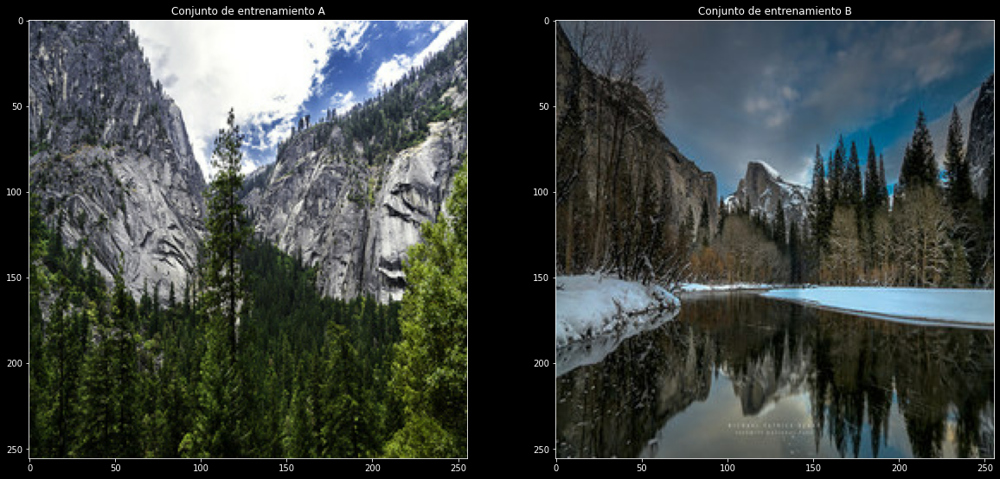

In [ ]:
# antes de continuar, mostremos las imágenes 
plt.style.use('dark_background')
inpA = next(iter(train_A))
inpB = next(iter(train_B))

figura = plt.figure(figsize=(20, 15))
plt.subplot(121)
plt.title("Conjunto de entrenamiento A")
plt.imshow(inpA[0]*0.5 + 0.5)

plt.subplot(122)
plt.title("Conjunto de entrenamiento B")
plt.imshow(inpB[0]*0.5 + 0.5)

Para construir el generador y el discriminador necesitaremos tres submódulos: la capa de upsampling, que tomará una imagen y realizará una operación de convolución de transposición; una capa de downsampling, que realizará la operación de convolución de convención, y una capa residual para que podamos tener un modelo suficientemente profundo. Estas capas se definen en las funciones ```downsample()```, ```upsample()```, y clase basada en la API ResnetIdentityBlock de TensorFlow Keras Model. 

In [ ]:
def downsample(filtros, tamano=3, apply_batchnorm=True):
  inicializador = tf.random_normal_initializer(0., 0.02)

  resultado = tf.keras.Sequential()
  resultado.add(
    tf.keras.layers.Conv2D(filtros, tamano, strides=2, padding='same',
                           kernel_initializer=inicializador, use_bias=False))
  if apply_batchnorm:
      resultado.add(tf.keras.layers.BatchNormalization())
      
  resultado.add(tf.keras.layers.LeakyReLU())

  return resultado

In [ ]:
def upsample(filtros, tamano=3, apply_dropout=False):
  inicializador = tf.random_normal_initializer(0., 0.02)

  resultado = tf.keras.Sequential()
  resultado.add(tf.keras.layers.Conv2DTranspose(filtros, tamano, strides=2, 
                                padding='same',
                                kernel_initializer=inicializador,
                                use_bias=False))
  
  resultado.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      resultado.add(tf.keras.layers.Dropout(0.5))

  resultado.add(tf.keras.layers.ReLU())
  
  return resultado

In [ ]:
class ResnetIdentityBlock(tf.keras.Model):
  def __init__(self, tamano_kernel, filtros):
    super(ResnetIdentityBlock, self).__init__(name='')
    filtros1, filtros2, filtros3 = filtros

    self.conv2a = tf.keras.layers.Conv2D(filtros1, (1, 1))
    self.bn2a = tf.keras.layers.BatchNormalization()

    self.conv2b = tf.keras.layers.Conv2D(filtros2, tamano_kernel, 
                                         padding='same')
    self.bn2b = tf.keras.layers.BatchNormalization()

    self.conv2c = tf.keras.layers.Conv2D(filtros3, (1, 1))
    self.bn2c = tf.keras.layers.BatchNormalization()


  def call(self, tensor_entrada, entrenamiento=False):
    x = self.conv2a(tensor_entrada)
    x = self.bn2a(x, training=entrenamiento)
    x = tf.nn.relu(x)

    x = self.conv2b(x)
    x = self.bn2b(x, training=entrenamiento)
    x = tf.nn.relu(x)

    x = self.conv2c(x)
    x = self.bn2c(x, training=entrenamiento)

    x += tensor_entrada
    return tf.nn.relu(x)

    
bloque1 = ResnetIdentityBlock(3, [512, 512, 512])
bloque2 = ResnetIdentityBlock(3, [512, 512, 512])
bloque3 = ResnetIdentityBlock(3, [512, 512, 512])


resnet = [bloque1, bloque2, bloque3]
print(bloque1(tf.zeros([1, 16, 16, 512])).shape)
print([x.name for x in bloque1.trainable_variables])

(1, 16, 16, 512)
['resnet_identity_block/conv2d/kernel:0', 'resnet_identity_block/conv2d/bias:0', 'resnet_identity_block/batch_normalization/gamma:0', 'resnet_identity_block/batch_normalization/beta:0', 'resnet_identity_block/conv2d_1/kernel:0', 'resnet_identity_block/conv2d_1/bias:0', 'resnet_identity_block/batch_normalization_1/gamma:0', 'resnet_identity_block/batch_normalization_1/beta:0', 'resnet_identity_block/conv2d_2/kernel:0', 'resnet_identity_block/conv2d_2/bias:0', 'resnet_identity_block/batch_normalization_2/gamma:0', 'resnet_identity_block/batch_normalization_2/beta:0']


In [ ]:
# Ahora construimos nuestro generador
def generador():
  down_stack = [
    downsample(64, 4, apply_batchnorm=False),
    downsample(128, 4),
    downsample(256, 4),
    downsample(512, 4)
  ]

  up_stack = [
    upsample(256, 4),
    upsample(128, 4),
    upsample(64, 4),
  ]

  inicializador = tf.random_normal_initializer(0., 0.02)
  ultimo = tf.keras.layers.Conv2DTranspose(3, 4, strides=2, padding='same', 
                                         kernel_initializer=inicializador,
                                         activation='tanh') 
  
  entradas = tf.keras.layers.Input(shape=[256, 256, 3])
  x = entradas
  
  # Muestreo descendente a través del modelo
  saltados = []
  for down in down_stack:
    x = down(x)
    saltados.append(x)
     
  for block in resnet:
    x = block(x)
  saltados = reversed(saltados[:-1])

  # Muestreo y establecimiento de las conexiones de salto
  for up, skip in zip(up_stack, saltados):
    concatenar = tf.keras.layers.Concatenate()
    x = up(x)
    x = concatenar([x, skip])

  x = ultimo(x)
  return tf.keras.Model(inputs=entradas, outputs=x)

Ahora podemos definir también el discriminador. Seguimos la misma arquitectura de discriminador y discriminador que en el trabajo de Zhu et al.

In [ ]:
def discriminador():
  entradas = tf.keras.layers.Input(shape=[None,None,3])
  x = entradas
  g_filter = 64
  
  down_stack = [
      downsample(g_filter),
      downsample(g_filter * 2),
      downsample(g_filter * 4),
      downsample(g_filter * 8),
  ]
  
  for down in down_stack:
    x = down(x)

  #(bs, 30, 30, 1)
  ultimo = tf.keras.layers.Conv2D(1, 4, strides=1, padding='same') 
  x = ultimo(x)

  return tf.keras.Model(inputs=entradas, outputs=x)

In [ ]:
# Ahora, utilizando el generador y el discriminador definidos anteriormente, 
# construimos el CycleGAN
discriminador_A = discriminador()
discriminador_B = discriminador()

generador_AB = generador()
generador_BA = generador()

In [ ]:
# Definimos las perdidas y los optimizadores
perdida_objeto = tf.keras.losses.BinaryCrossentropy(from_logits=True)

@tf.function
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = perdida_objeto(tf.ones_like(disc_real_output), disc_real_output)
  generated_loss = perdida_objeto(tf.zeros_like(disc_generated_output), 
                              disc_generated_output)
  total_disc_loss = real_loss + generated_loss
  return total_disc_loss

optimizador = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)
optimizador_discriminador = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

In [ ]:
# Creamos placeholders para las etiquetas de las imagenes reales y falsas
real = np.ones((tamano_lote, 16, 16, 1)).astype('float32')
falsa = np.zeros((tamano_lote, 16, 16, 1)).astype('float32')

In [ ]:
'''
Ahora definimos la función que entrena el generador y el discriminador en un 
lote, un par de imágenes a la vez. Los dos discriminadores y los dos generadores
se entrenan a través de esta función con la ayuda del gradiente de la cinta
'''
@tf.function
def train_batch(imgs_A, imgs_B):
  with tf.GradientTape() as g, tf.GradientTape() as d_tape:
    b_falsa = generador_AB(imgs_A, training=True)
    a_falsa = generador_BA(imgs_B, training=True)
    
    logits_real_A = discriminador_A(imgs_A, training=True)
    logits_fake_A = discriminador_A(a_falsa, training=True)
    perdida_dA = discriminator_loss(logits_real_A, logits_fake_A)
    
    logits_real_B = discriminador_B(imgs_B, training=True)
    logits_fake_B = discriminador_B(b_falsa, training=True)
    perdida_dB = discriminator_loss(logits_real_B, logits_fake_B)
    
    perdida_d = (perdida_dA + perdida_dB) / 2
    # Translate images back to original domain
    reconstruir_A = generador_BA(b_falsa, training=True)
    reconstruir_B = generador_AB(a_falsa, training=True)
    
    id_A = generador_BA(imgs_A, training=True)
    id_B = generador_AB(imgs_B, training=True)

    generar_perdida = tf.math.reduce_sum([
      1 * tf.math.reduce_mean(mean_squared_error(logits_fake_A, real)),
      1 * tf.math.reduce_mean(mean_squared_error(logits_fake_B, real)),
      10 * tf.math.reduce_mean(mean_squared_error(reconstruir_A, imgs_A)),
      10 * tf.math.reduce_mean(mean_squared_error(reconstruir_B, imgs_B)),
      0.1 * tf.math.reduce_mean(mean_squared_error(id_A, imgs_A)),
      0.1 * tf.math.reduce_mean(mean_squared_error(id_B, imgs_B)),
    ])
      
  gradientes_de_b = d_tape.gradient(perdida_d, discriminador_A.trainable_variables + discriminador_B.trainable_variables)
  optimizador_discriminador.apply_gradients(zip(gradientes_de_b, discriminador_A.trainable_variables + discriminador_B.trainable_variables))

  gradients_of_generator = g.gradient(generar_perdida, generador_AB.trainable_variables + generador_BA.trainable_variables)
  optimizador.apply_gradients(zip(gradients_of_generator, generador_AB.trainable_variables + generador_BA.trainable_variables))
  
  return perdida_dA, perdida_dB, generar_perdida

In [ ]:
# Definimos los checkpionts ara guardar los pesos del modelo
checkpoint_dird_A = './training_checkpointsd_A'
checkpoint_prefixd_A = os.path.join(checkpoint_dird_A, "ckpt_{epoch}")

checkpoint_dird_B = './training_checkpointsd_B'
checkpoint_prefixd_B = os.path.join(checkpoint_dird_B, "ckpt_{epoch}")

checkpoint_dirg_AB = './training_checkpointsg_AB'
checkpoint_prefixg_AB = os.path.join(checkpoint_dirg_AB, "ckpt_{epoch}")

checkpoint_dirg_BA = './training_checkpointsg_BA'
checkpoint_prefixg_BA = os.path.join(checkpoint_dirg_BA, "ckpt_{epoch}")

In [ ]:
def entrenar(entrenamiento_A, entrenamiento_B, epocas):
  for epoca in range(epocas):
    start = time.time()
    
    for lote_i, (imgs_A, imgs_B) in enumerate(zip(entrenamiento_A, entrenamiento_B)):
      dA_loss, dB_loss, g_loss = train_batch(imgs_A, imgs_B)
      
      if lote_i % 1000 == 0:
        test_imgA = next(iter(test_A))
        test_imgB = next(iter(test_B))
        print ('Tiempo tomado para la epoca {} indice del lote {} es {} segundos\n'.format(epoca, lote_i, time.time()-start))
        print("discriminador A: ", dA_loss.numpy())
        print("discriminador B: ", dB_loss.numpy())
        print("generador: {}\n".format(g_loss))

        fig, axs = plt.subplots(2, 2, figsize=(10, 10), sharey=True, sharex=True)
        generador_a_salida = generador_AB(test_imgA, training=False)
        generador_b_salida = generador_BA(test_imgB, training=False)
        axs[0,0].imshow(test_imgA[0]*0.5 + 0.5)
        axs[0,0].set_title("Generador A Entrada")
        axs[0,1].imshow(generador_a_salida[0]*0.5 + 0.5)
        axs[0,1].set_title("Generador A Salida")
        axs[1,0].imshow(test_imgB[0]*0.5 + 0.5)
        axs[1,0].set_title("Generador B Entrada")
        axs[1,1].imshow(generador_b_salida[0]*0.5 + 0.5)
        axs[1,1].set_title("Generador B Salida")
        plt.show()

        discriminador_A.save_weights(checkpoint_prefixd_A.format(epoch=epoca))
        discriminador_B.save_weights(checkpoint_prefixd_B.format(epoch=epoca))
        generador_AB.save_weights(checkpoint_prefixg_AB.format(epoch=epoca))
        generador_BA.save_weights(checkpoint_prefixg_BA.format(epoch=epoca))

Tiempo tomado para la epoca 0 indice del lote 0 es 10.948097467422485 segundos

discriminador A:  1.6439111
discriminador B:  1.5310923
generador: 10.931047439575195



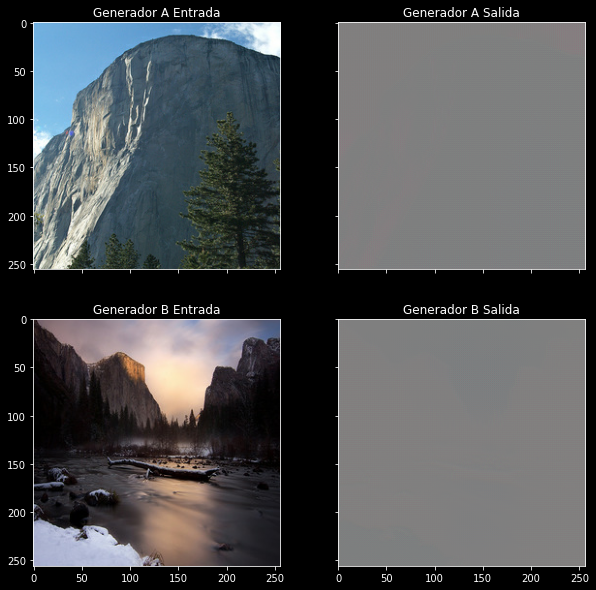

Tiempo tomado para la epoca 1 indice del lote 0 es 0.1888713836669922 segundos

discriminador A:  1.4166315
discriminador B:  1.3867835
generador: 3.4119763374328613



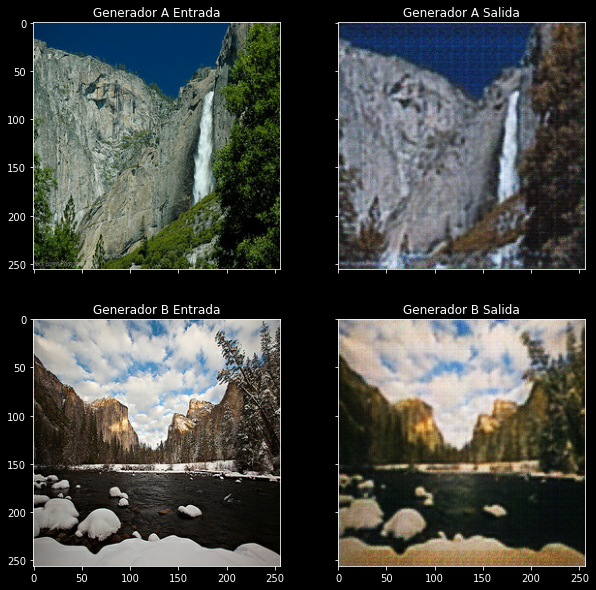

Tiempo tomado para la epoca 2 indice del lote 0 es 0.19015955924987793 segundos

discriminador A:  1.4150298
discriminador B:  1.4631162
generador: 2.4849812984466553



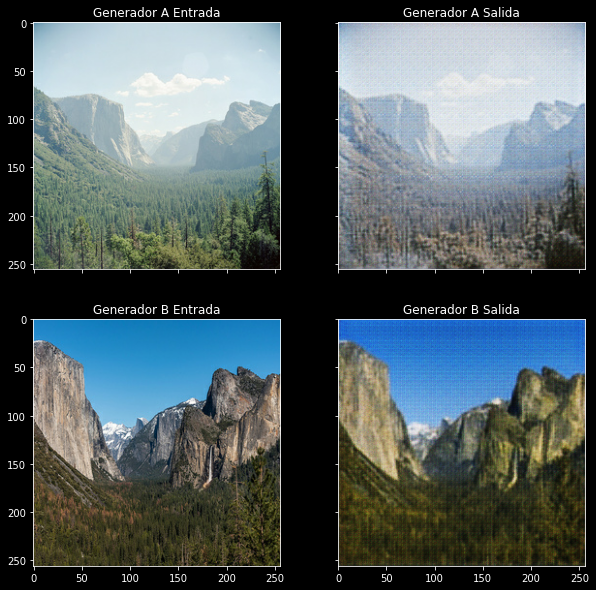

Tiempo tomado para la epoca 3 indice del lote 0 es 0.19154834747314453 segundos

discriminador A:  1.4036641
discriminador B:  1.3472381
generador: 2.5951225757598877



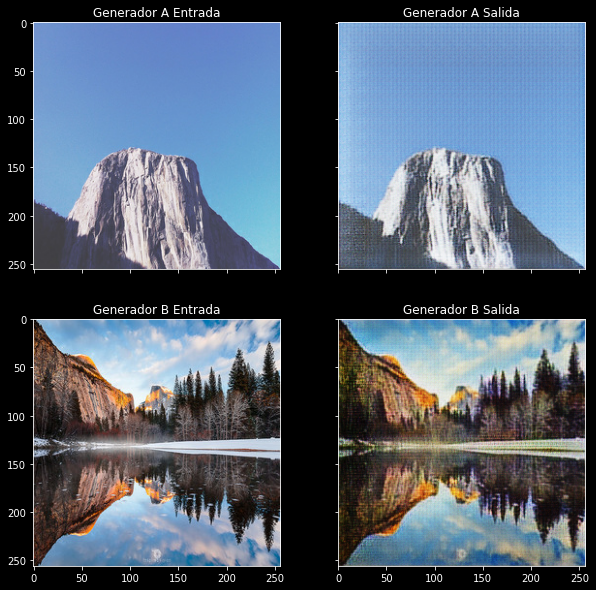

Tiempo tomado para la epoca 4 indice del lote 0 es 0.19099760055541992 segundos

discriminador A:  1.3956208
discriminador B:  1.3807296
generador: 2.445570230484009



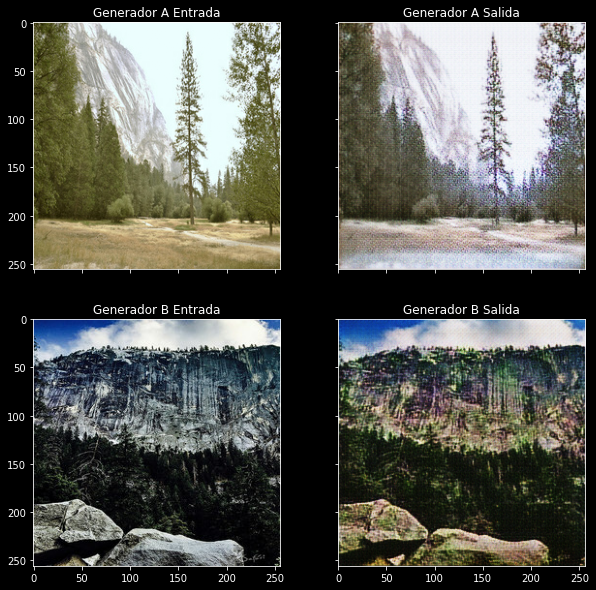

Tiempo tomado para la epoca 5 indice del lote 0 es 0.19091248512268066 segundos

discriminador A:  1.3972895
discriminador B:  1.4101171
generador: 2.2517106533050537



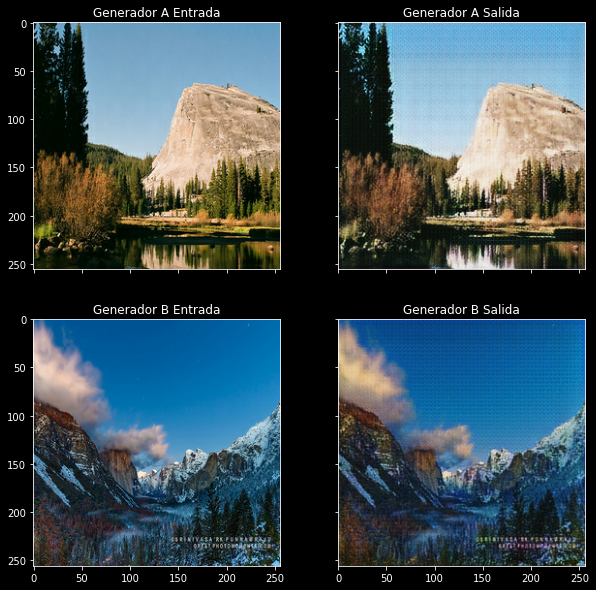

Tiempo tomado para la epoca 6 indice del lote 0 es 0.19394659996032715 segundos

discriminador A:  1.3788669
discriminador B:  1.3795519
generador: 2.3221888542175293



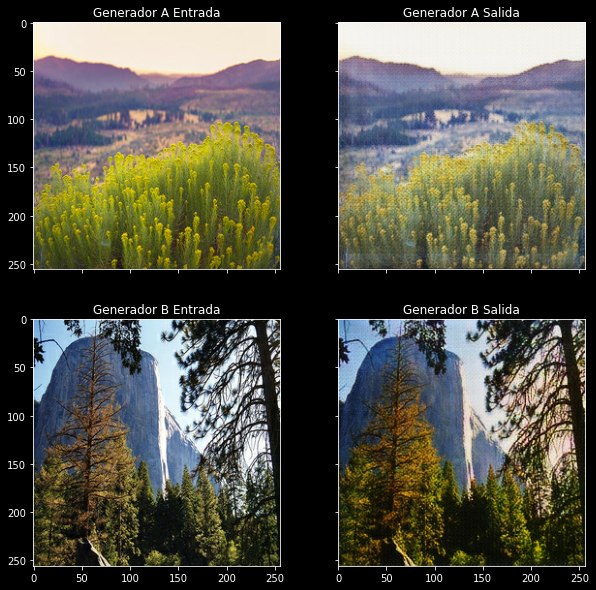

Tiempo tomado para la epoca 7 indice del lote 0 es 0.1923379898071289 segundos

discriminador A:  1.3949051
discriminador B:  1.374718
generador: 2.298637628555298



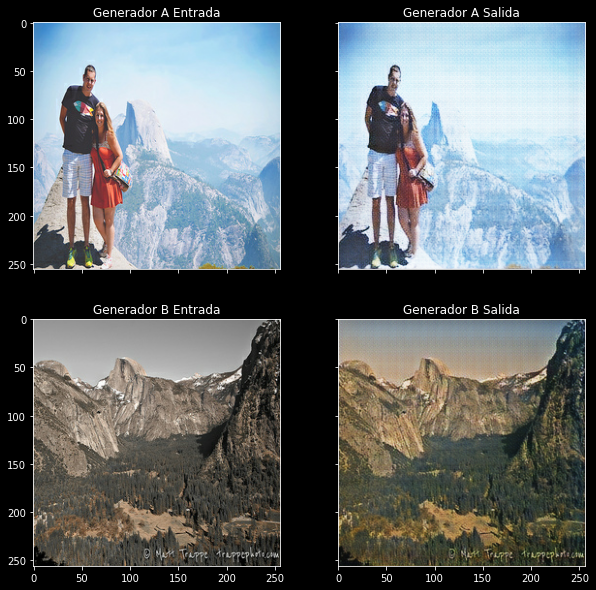

Tiempo tomado para la epoca 8 indice del lote 0 es 0.19278359413146973 segundos

discriminador A:  1.351313
discriminador B:  1.3830899
generador: 2.2619681358337402



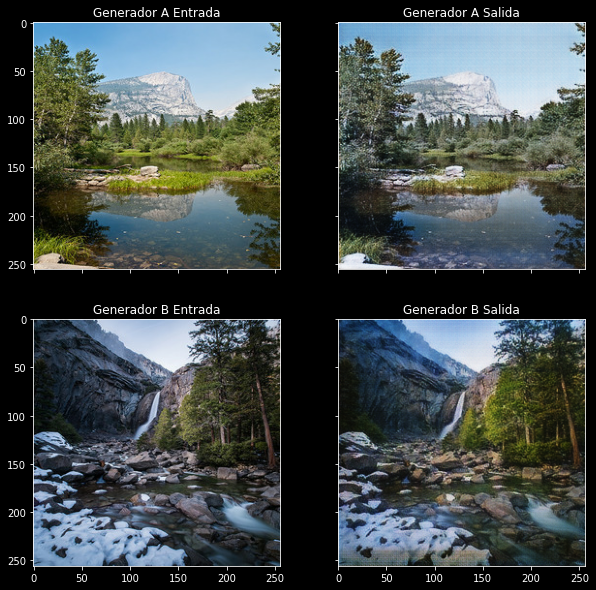

Tiempo tomado para la epoca 9 indice del lote 0 es 0.19098401069641113 segundos

discriminador A:  1.3786983
discriminador B:  1.3933182
generador: 2.2121782302856445



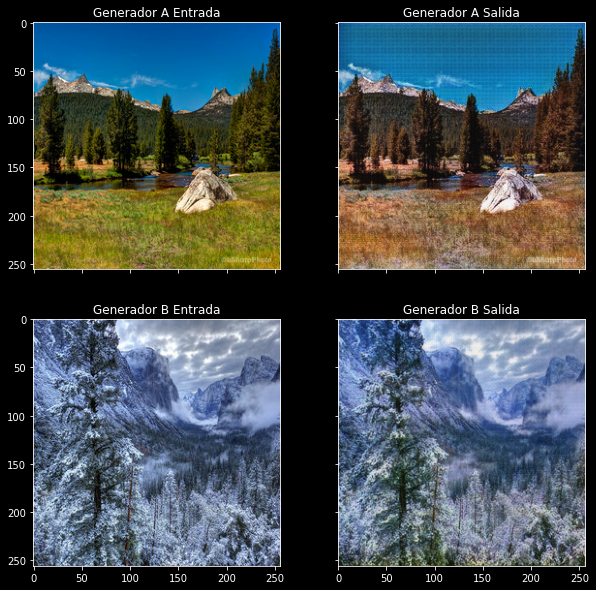

Tiempo tomado para la epoca 10 indice del lote 0 es 0.19257903099060059 segundos

discriminador A:  1.4055007
discriminador B:  1.411793
generador: 2.317559003829956



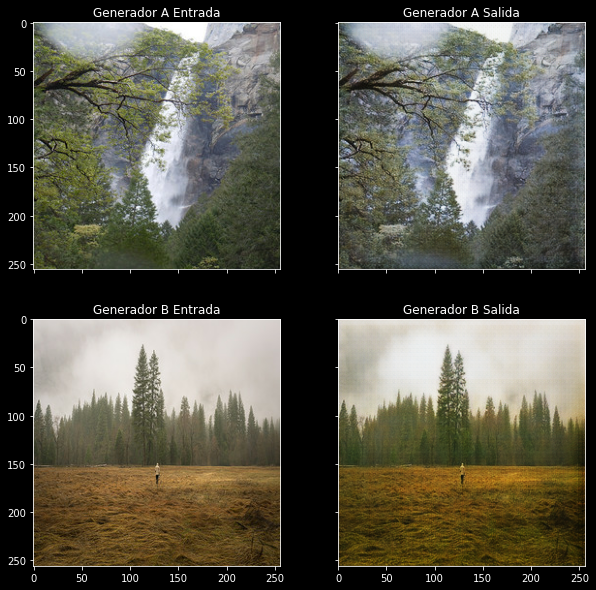

Tiempo tomado para la epoca 11 indice del lote 0 es 0.19812512397766113 segundos

discriminador A:  1.3713896
discriminador B:  1.3785237
generador: 2.3148679733276367



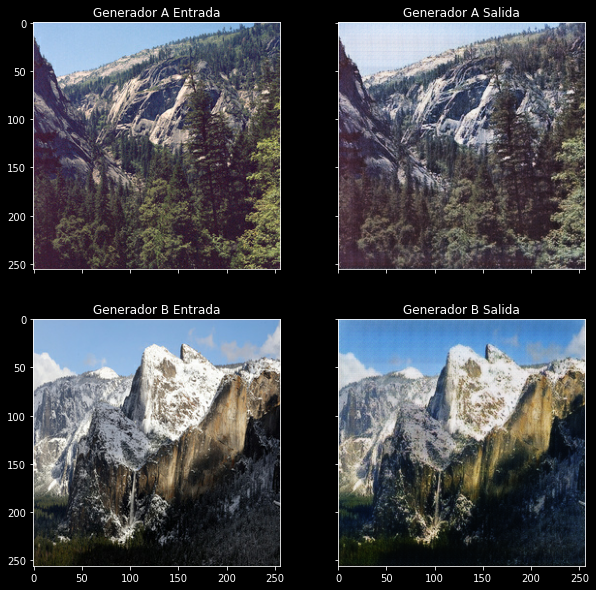

Tiempo tomado para la epoca 12 indice del lote 0 es 0.18914103507995605 segundos

discriminador A:  1.4157815
discriminador B:  1.3967916
generador: 2.3948066234588623



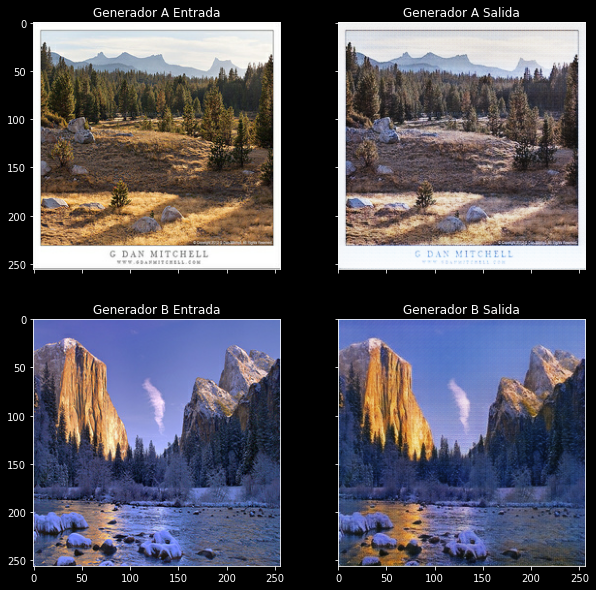

Tiempo tomado para la epoca 13 indice del lote 0 es 0.19060540199279785 segundos

discriminador A:  1.3401761
discriminador B:  1.3543532
generador: 2.4540536403656006



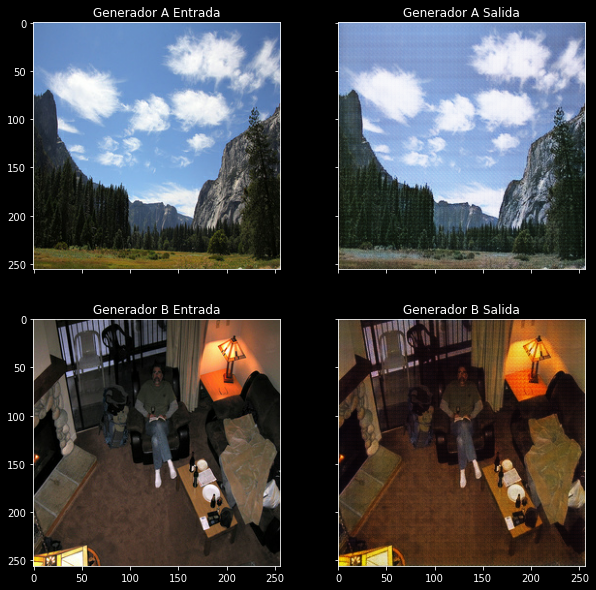

Tiempo tomado para la epoca 14 indice del lote 0 es 0.192427396774292 segundos

discriminador A:  1.4080327
discriminador B:  1.3837622
generador: 2.238812208175659



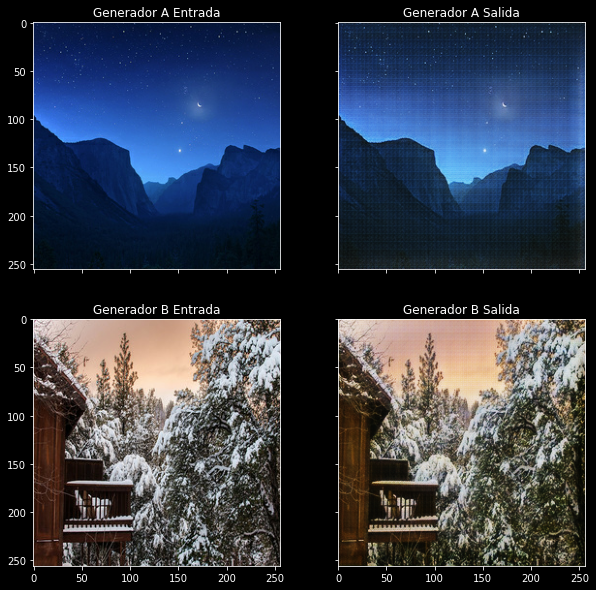

Tiempo tomado para la epoca 15 indice del lote 0 es 0.19408226013183594 segundos

discriminador A:  1.3883542
discriminador B:  1.4206988
generador: 2.0370543003082275



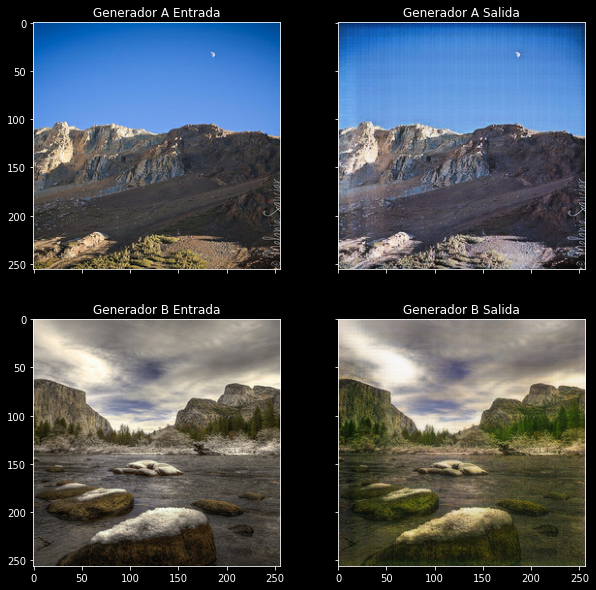

Tiempo tomado para la epoca 16 indice del lote 0 es 0.18954801559448242 segundos

discriminador A:  1.3933641
discriminador B:  1.4107554
generador: 2.4843900203704834



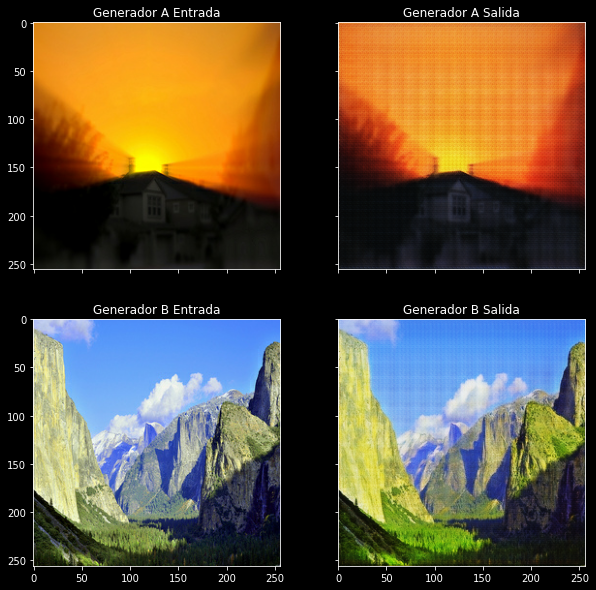

Tiempo tomado para la epoca 17 indice del lote 0 es 0.19045042991638184 segundos

discriminador A:  1.3698707
discriminador B:  1.3736397
generador: 2.2103819847106934



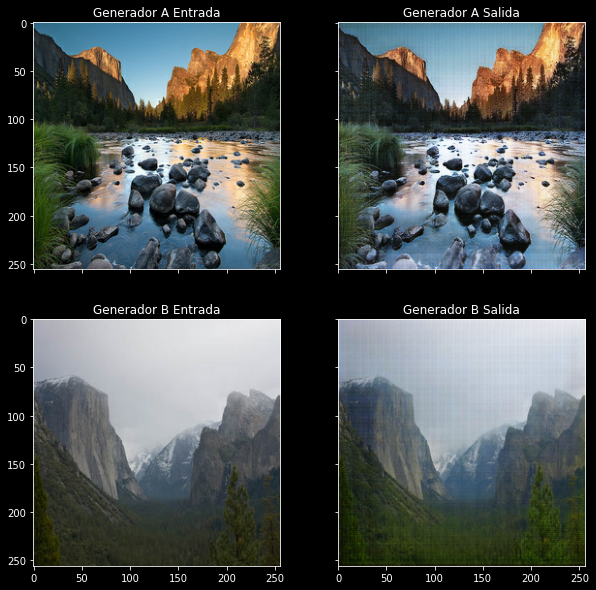

Tiempo tomado para la epoca 18 indice del lote 0 es 0.19038176536560059 segundos

discriminador A:  1.3772519
discriminador B:  1.3888183
generador: 2.2564303874969482



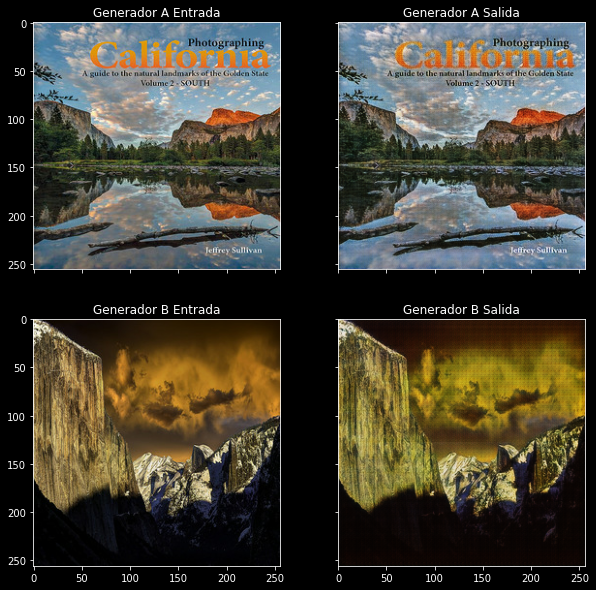

Tiempo tomado para la epoca 19 indice del lote 0 es 0.18998932838439941 segundos

discriminador A:  1.3798754
discriminador B:  1.3764179
generador: 2.079810380935669



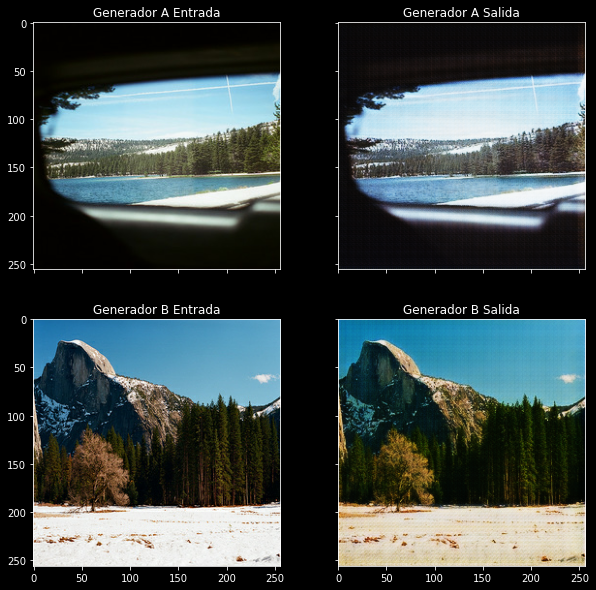

Tiempo tomado para la epoca 20 indice del lote 0 es 0.18979787826538086 segundos

discriminador A:  1.3815103
discriminador B:  1.3709456
generador: 2.3584635257720947



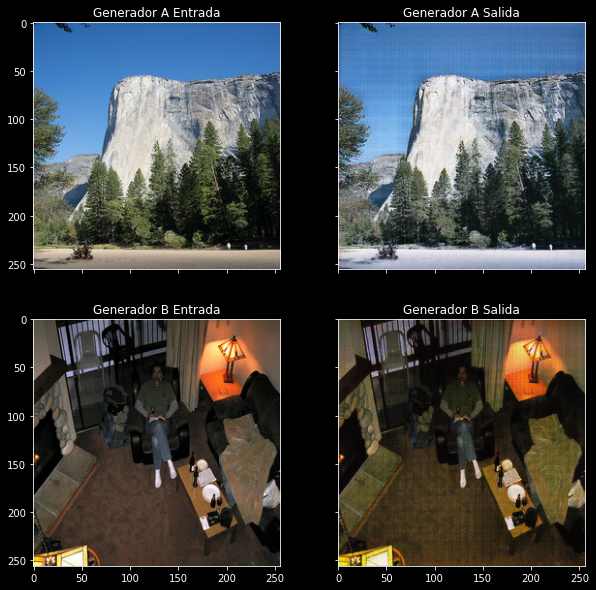

Tiempo tomado para la epoca 21 indice del lote 0 es 0.1920790672302246 segundos

discriminador A:  1.3683114
discriminador B:  1.3767009
generador: 2.613430976867676



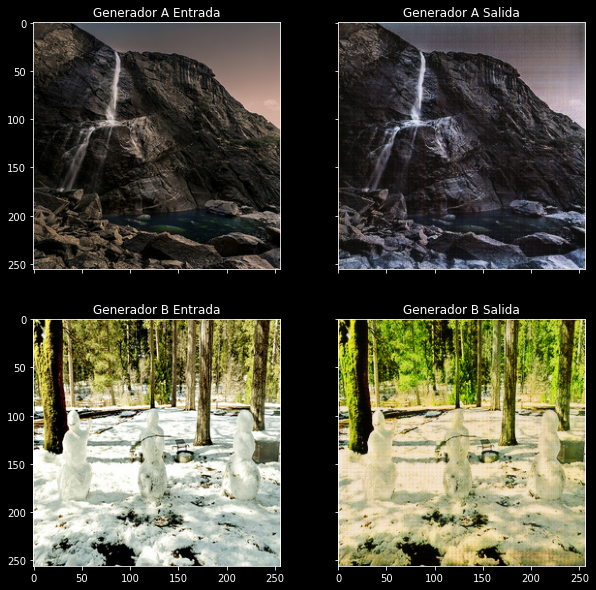

Tiempo tomado para la epoca 22 indice del lote 0 es 0.19036293029785156 segundos

discriminador A:  1.399457
discriminador B:  1.3886938
generador: 2.0904386043548584



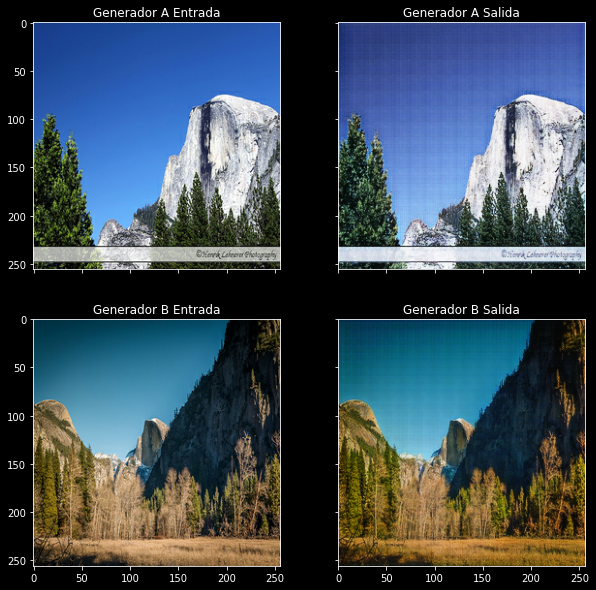

Tiempo tomado para la epoca 23 indice del lote 0 es 0.1900193691253662 segundos

discriminador A:  1.3858674
discriminador B:  1.40377
generador: 2.419144868850708



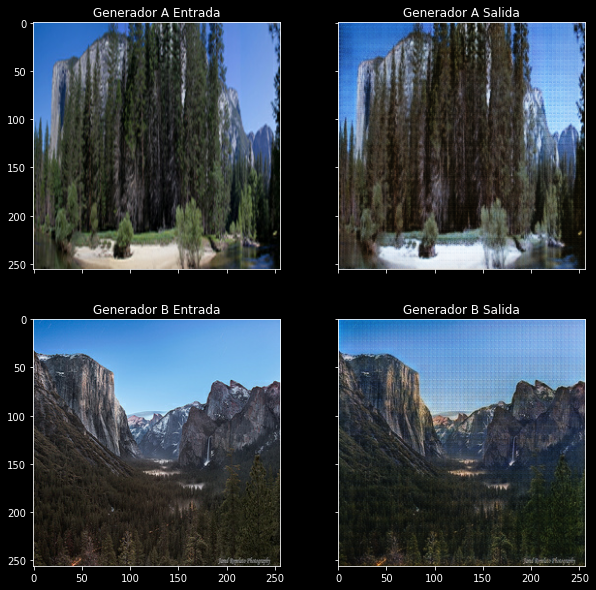

Tiempo tomado para la epoca 24 indice del lote 0 es 0.1914081573486328 segundos

discriminador A:  1.3952553
discriminador B:  1.3993309
generador: 2.2937209606170654



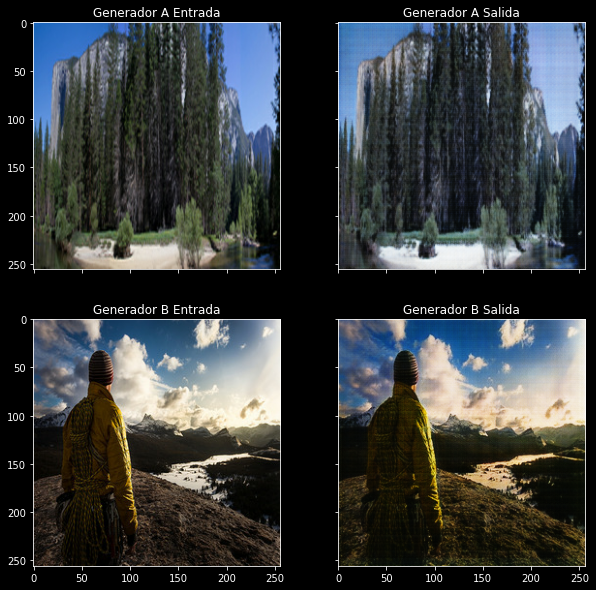

Tiempo tomado para la epoca 25 indice del lote 0 es 0.19174575805664062 segundos

discriminador A:  1.3833128
discriminador B:  1.393296
generador: 2.1140339374542236



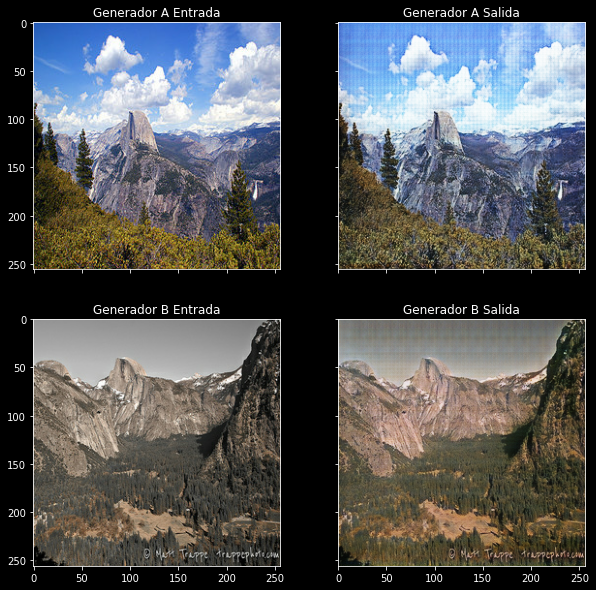

Tiempo tomado para la epoca 26 indice del lote 0 es 0.1851062774658203 segundos

discriminador A:  1.3933916
discriminador B:  1.4065744
generador: 1.8418750762939453



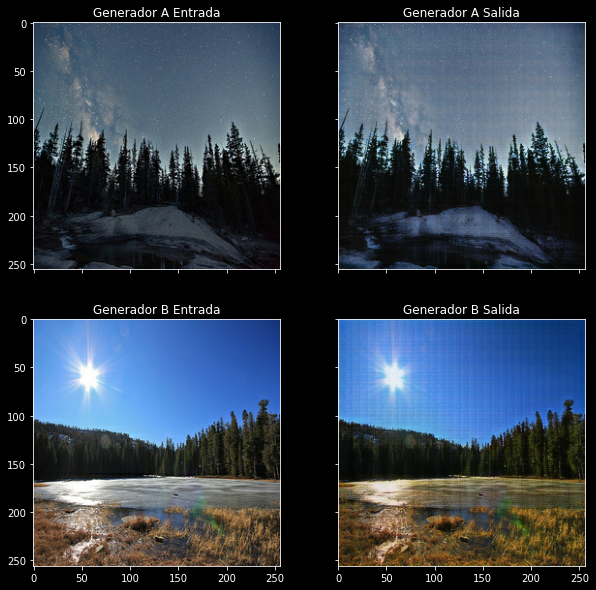

Tiempo tomado para la epoca 27 indice del lote 0 es 0.19720172882080078 segundos

discriminador A:  1.4117395
discriminador B:  1.4244816
generador: 2.1585097312927246



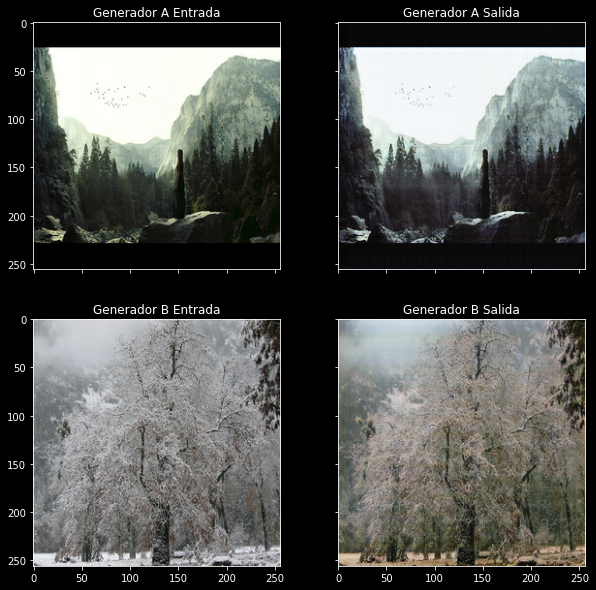

Tiempo tomado para la epoca 28 indice del lote 0 es 0.19196724891662598 segundos

discriminador A:  1.4234717
discriminador B:  1.4093738
generador: 1.970469355583191



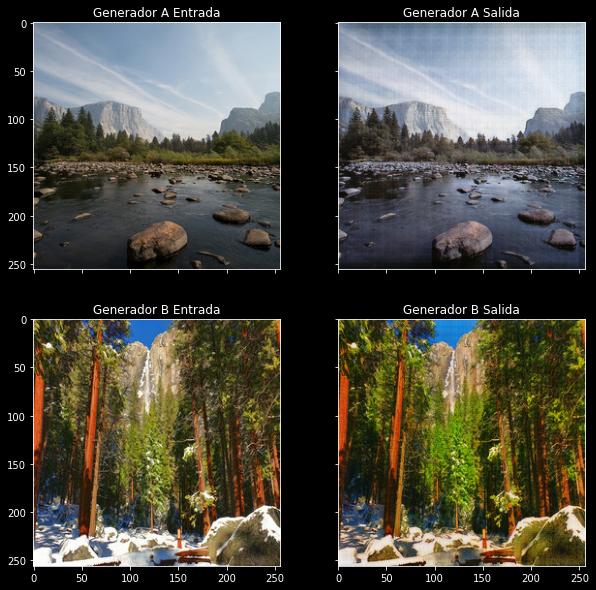

Tiempo tomado para la epoca 29 indice del lote 0 es 0.1886434555053711 segundos

discriminador A:  1.3901086
discriminador B:  1.4053329
generador: 1.9754666090011597



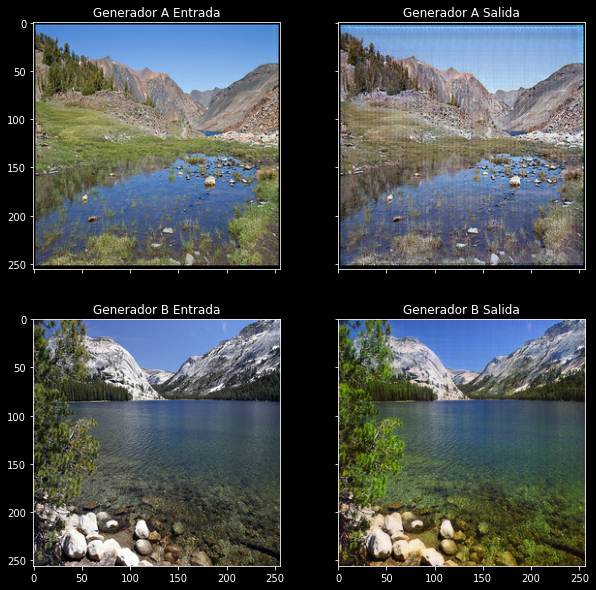

Tiempo tomado para la epoca 30 indice del lote 0 es 0.1916365623474121 segundos

discriminador A:  1.4037013
discriminador B:  1.4126285
generador: 1.9304865598678589



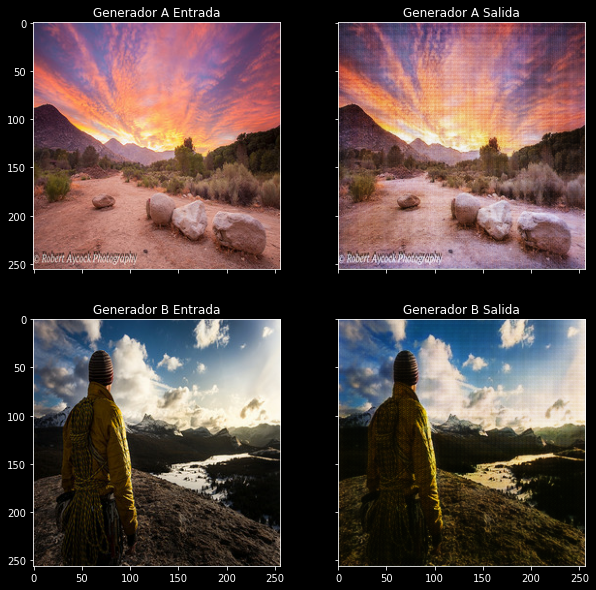

Tiempo tomado para la epoca 31 indice del lote 0 es 0.18970155715942383 segundos

discriminador A:  1.3856487
discriminador B:  1.3942105
generador: 2.142258882522583



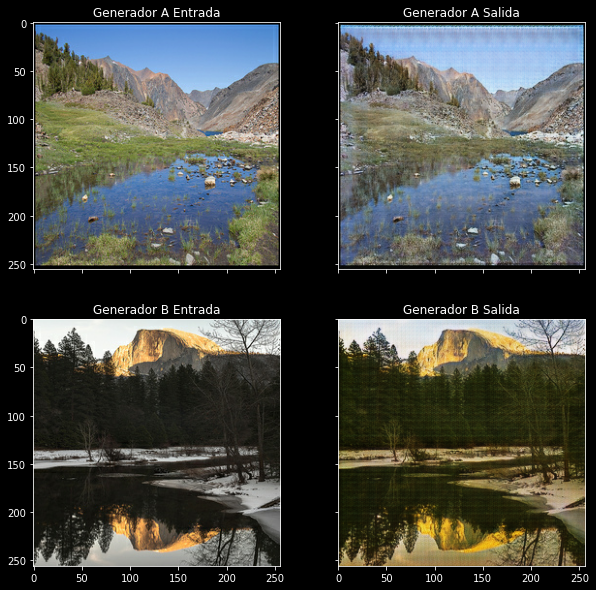

Tiempo tomado para la epoca 32 indice del lote 0 es 0.19400238990783691 segundos

discriminador A:  1.3844825
discriminador B:  1.3825716
generador: 2.242234230041504



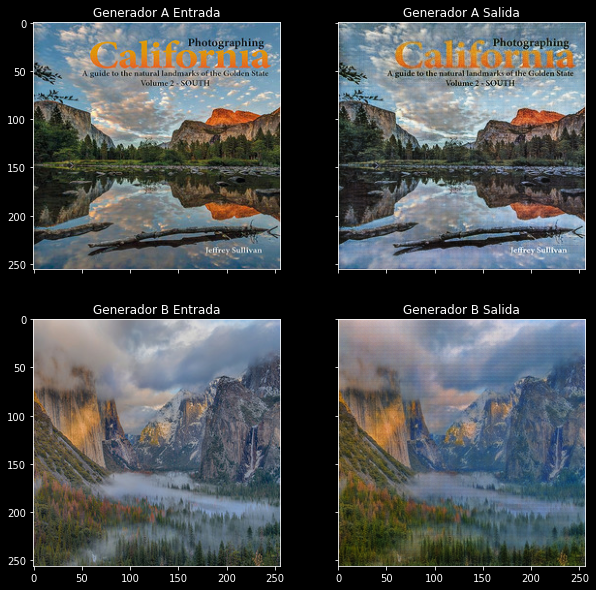

Tiempo tomado para la epoca 33 indice del lote 0 es 0.18887782096862793 segundos

discriminador A:  1.387131
discriminador B:  1.3957214
generador: 2.1943132877349854



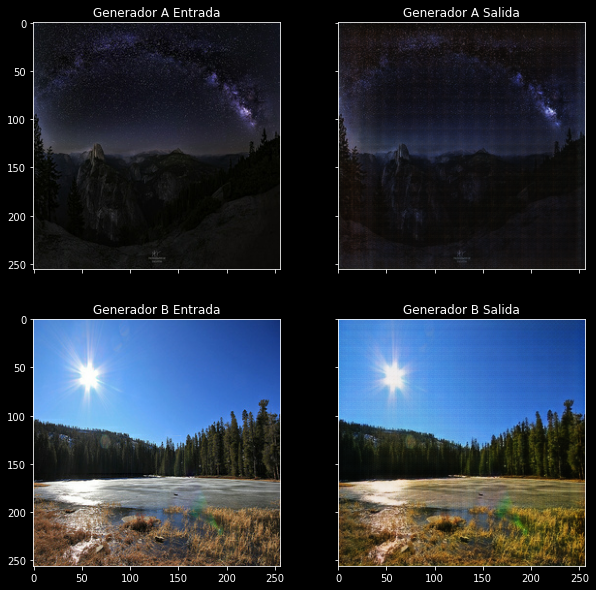

Tiempo tomado para la epoca 34 indice del lote 0 es 0.18857955932617188 segundos

discriminador A:  1.3741189
discriminador B:  1.4041804
generador: 2.250253677368164



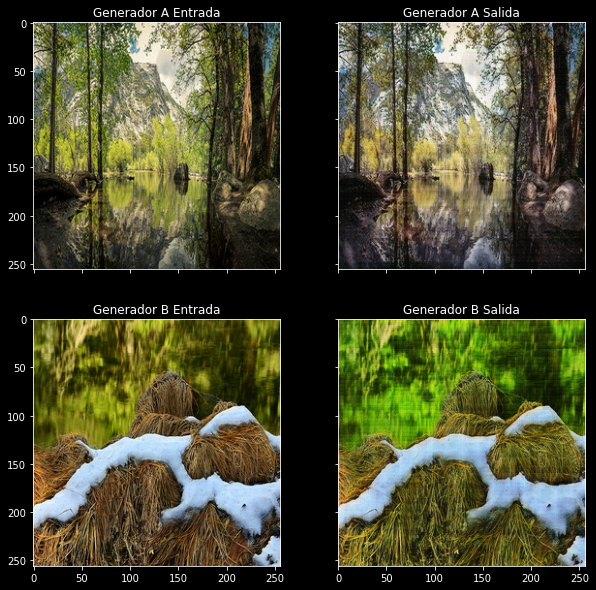

Tiempo tomado para la epoca 35 indice del lote 0 es 0.18816876411437988 segundos

discriminador A:  1.3622983
discriminador B:  1.3586233
generador: 2.313786506652832



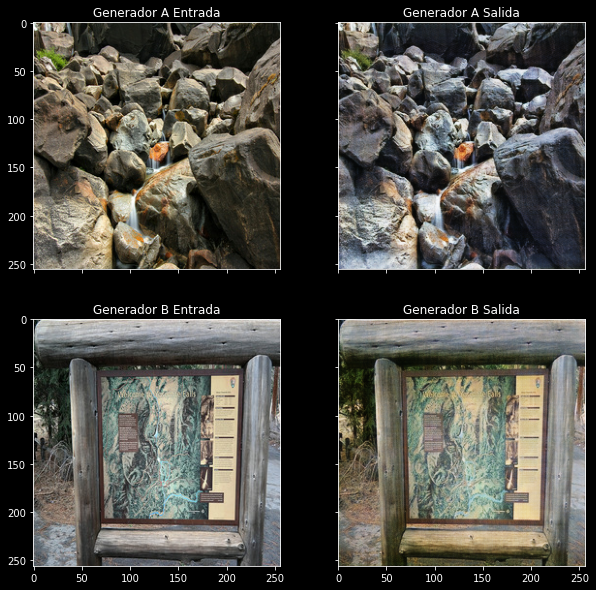

Tiempo tomado para la epoca 36 indice del lote 0 es 0.1897289752960205 segundos

discriminador A:  1.3821261
discriminador B:  1.3840642
generador: 2.0332729816436768



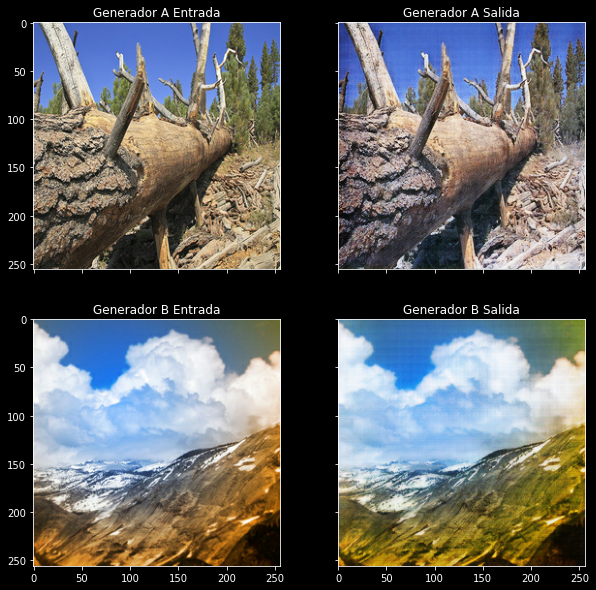

Tiempo tomado para la epoca 37 indice del lote 0 es 0.19103312492370605 segundos

discriminador A:  1.3474164
discriminador B:  1.3786929
generador: 2.371196985244751



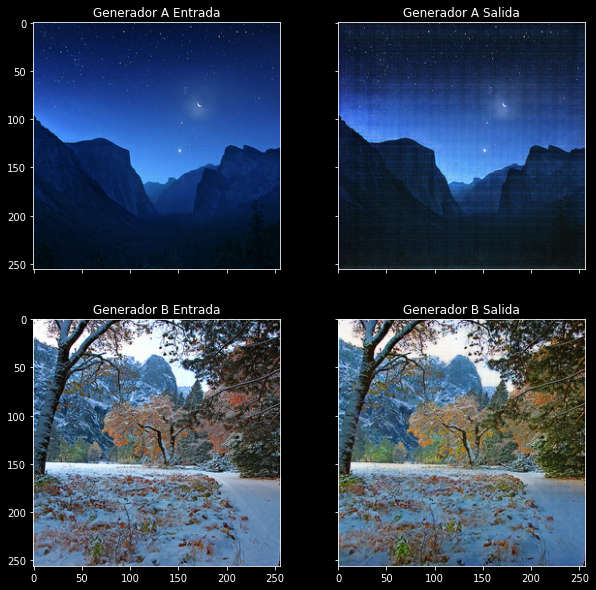

Tiempo tomado para la epoca 38 indice del lote 0 es 0.19221806526184082 segundos

discriminador A:  1.3622693
discriminador B:  1.3685822
generador: 2.444085121154785



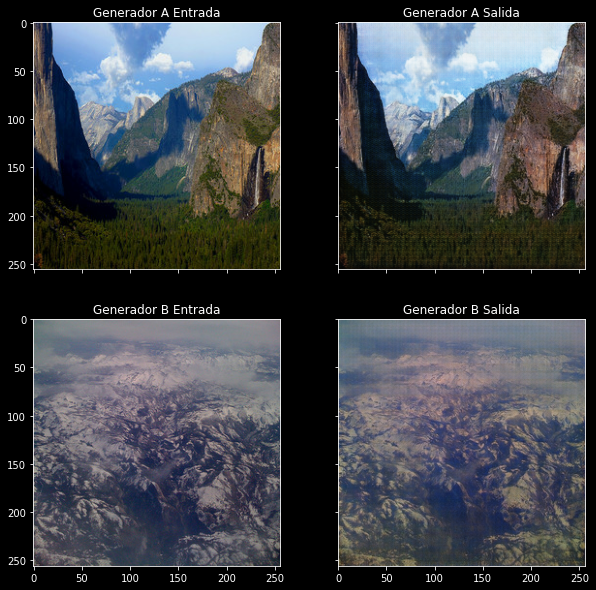

Tiempo tomado para la epoca 39 indice del lote 0 es 0.1939711570739746 segundos

discriminador A:  1.3624358
discriminador B:  1.3728483
generador: 2.606812000274658



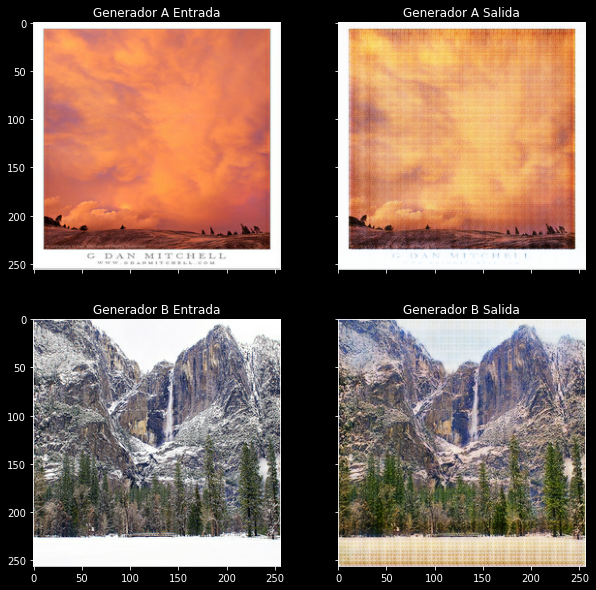

Tiempo tomado para la epoca 40 indice del lote 0 es 0.19114160537719727 segundos

discriminador A:  1.4116268
discriminador B:  1.3812952
generador: 2.0963642597198486



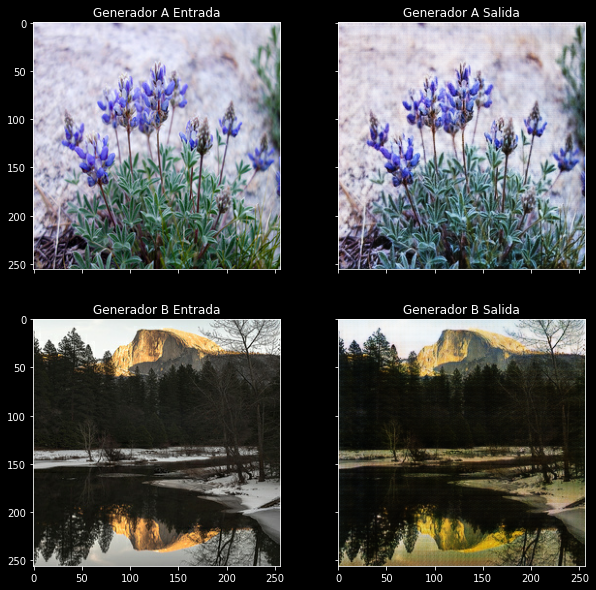

Tiempo tomado para la epoca 41 indice del lote 0 es 0.19212651252746582 segundos

discriminador A:  1.3975616
discriminador B:  1.400669
generador: 2.220877170562744



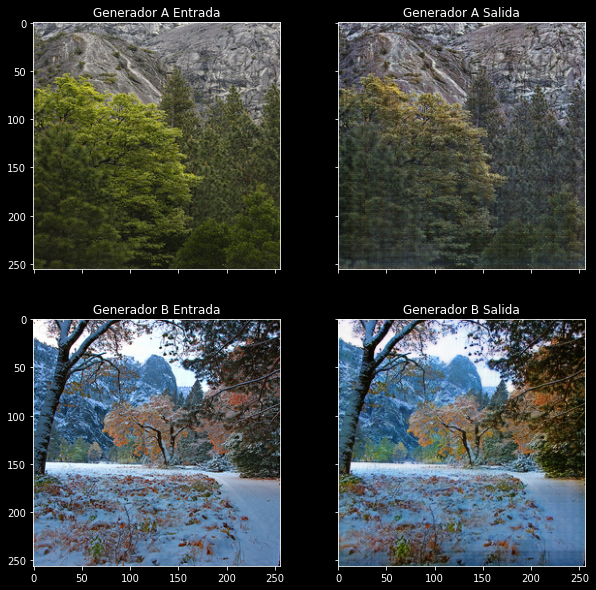

Tiempo tomado para la epoca 42 indice del lote 0 es 0.19041085243225098 segundos

discriminador A:  1.4158169
discriminador B:  1.4082663
generador: 2.190983533859253



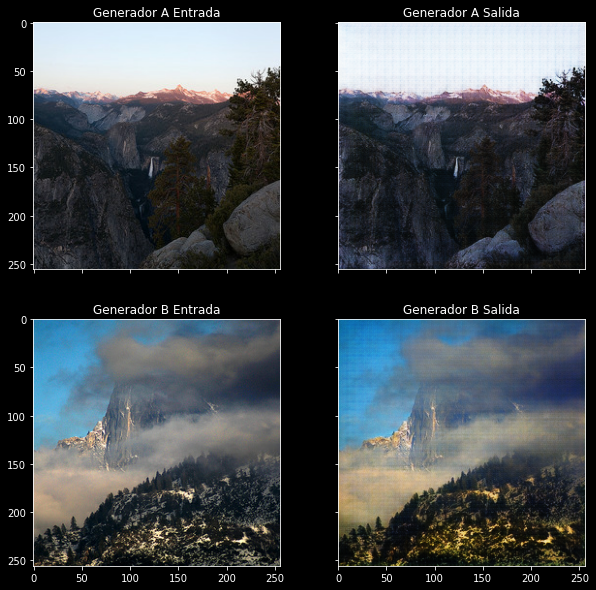

Tiempo tomado para la epoca 43 indice del lote 0 es 0.1881403923034668 segundos

discriminador A:  1.4479789
discriminador B:  1.4426223
generador: 1.6759344339370728



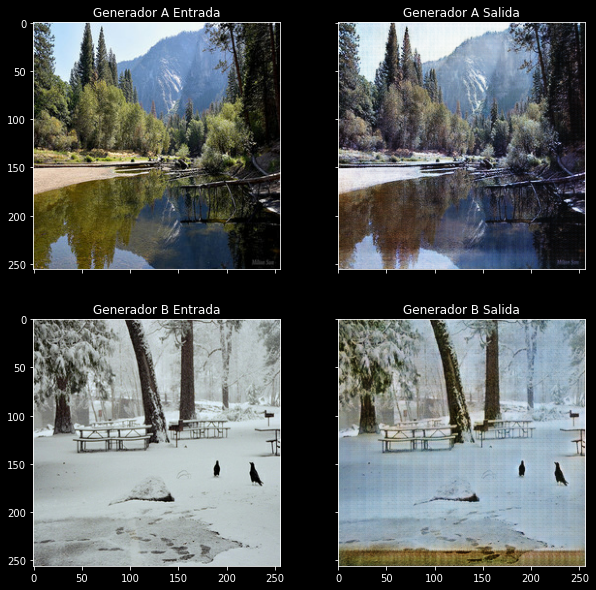

Tiempo tomado para la epoca 44 indice del lote 0 es 0.19152164459228516 segundos

discriminador A:  1.3204068
discriminador B:  1.4263324
generador: 2.0883281230926514



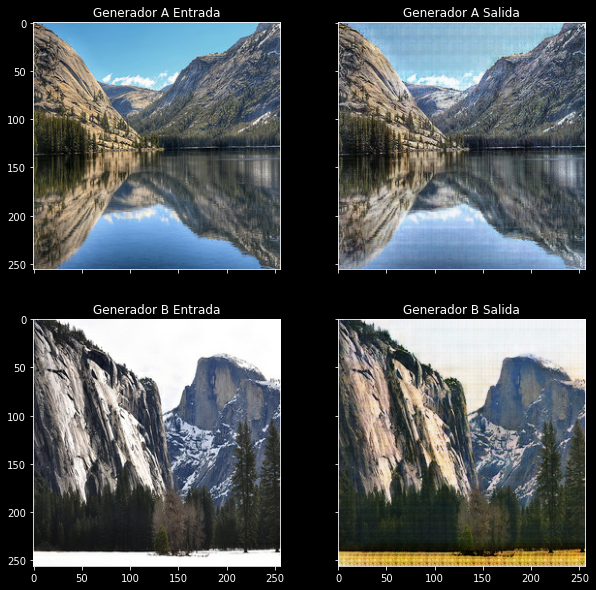

Tiempo tomado para la epoca 45 indice del lote 0 es 0.18999290466308594 segundos

discriminador A:  1.3786926
discriminador B:  1.3720809
generador: 2.2508721351623535



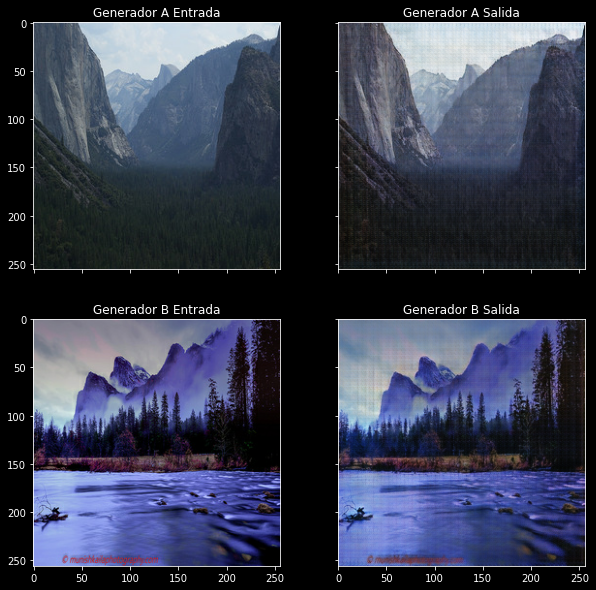

Tiempo tomado para la epoca 46 indice del lote 0 es 0.18927884101867676 segundos

discriminador A:  1.350452
discriminador B:  1.348
generador: 2.297802448272705



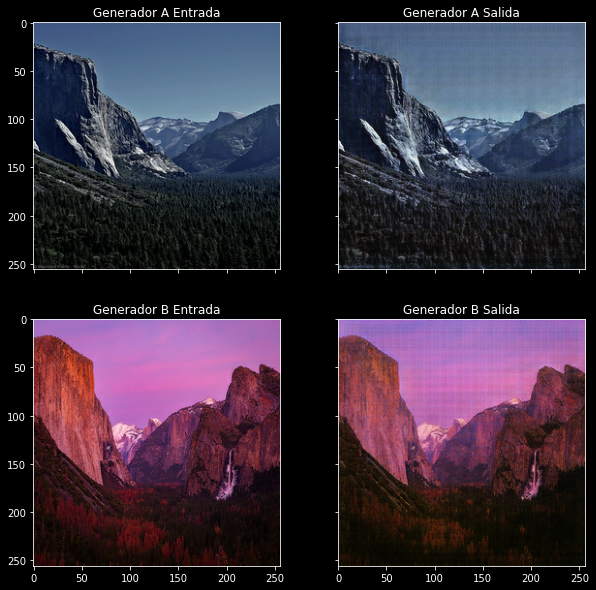

Tiempo tomado para la epoca 47 indice del lote 0 es 0.191009521484375 segundos

discriminador A:  1.3218331
discriminador B:  1.3612611
generador: 2.3238344192504883



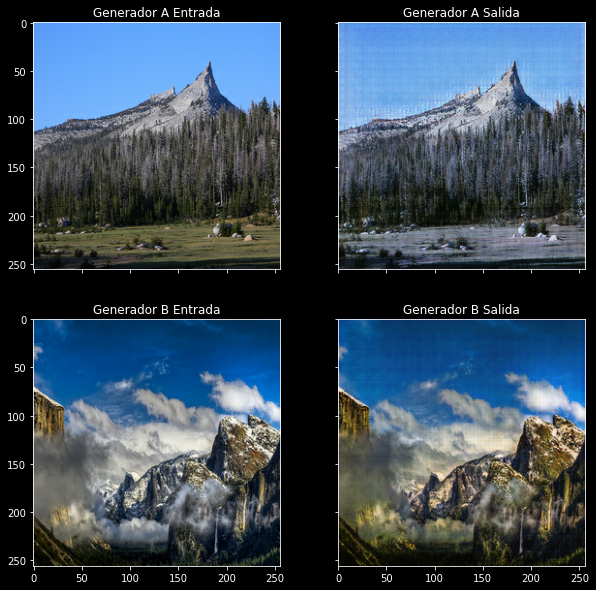

Tiempo tomado para la epoca 48 indice del lote 0 es 0.18991470336914062 segundos

discriminador A:  1.3573238
discriminador B:  1.3554395
generador: 2.438258171081543



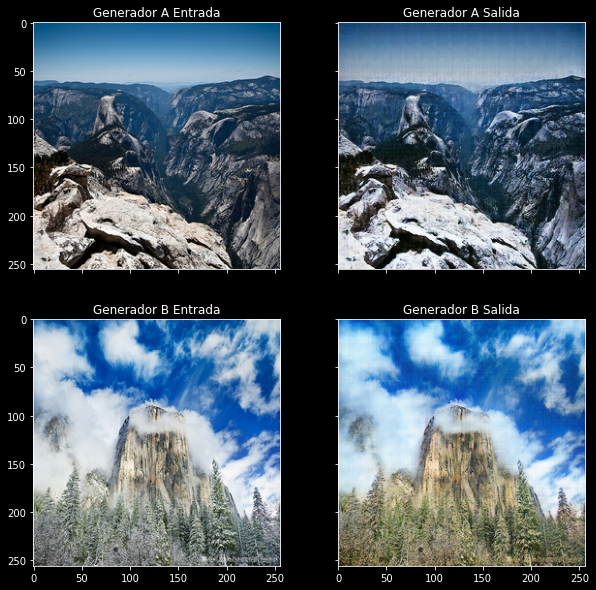

Tiempo tomado para la epoca 49 indice del lote 0 es 0.18872499465942383 segundos

discriminador A:  1.406674
discriminador B:  1.384918
generador: 1.9446409940719604



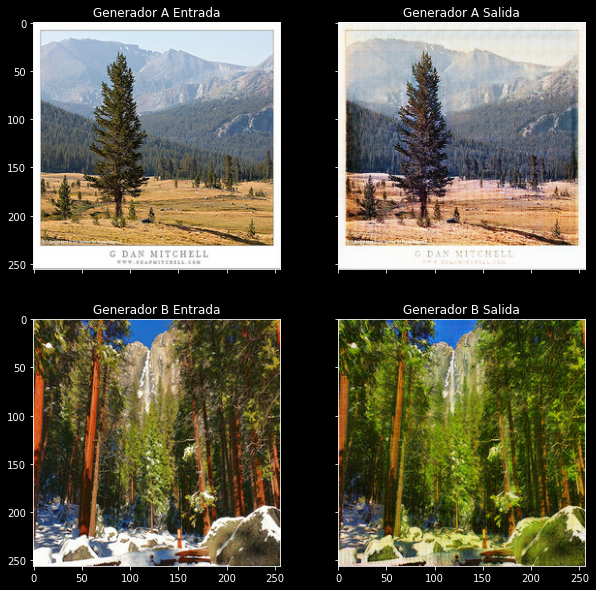

In [ ]:
entrenar(train_A, train_B, epocas)

## <center><b>Capítulo 7: Incrustación de palabras</b></center>
Primero veremos la idea que hay detrás de las incrustaciones de palabras, y luego las dos primeras implementaciones: Word2Vec y GloVe. Aprenderemos a construir incrustaciones de palabras desde cero utilizando gensim en nuestro propio corpus, y navegar por el espacio de incrustación que hemos creado.

También aprenderemos a utilizar incrustaciones de terceros como punto de partida para nuestras propias tareas de PNL, como la detección de spam, es decir, aprender a detectar automáticamente correos electrónicos no solicitados y no deseados.

### <center><b>Representaciones distribuidas</b></center>
Las representaciones distribuidas intentan captar el significado de una palabra considerando sus relaciones con otras palabras en su contexto. La idea que subyace a la hipótesis distribuida se recoge en esta cita de J. R. Firth, un lingüista que que propuso por primera vez esta idea:

_"Conocerás una palabra por la compañía que tiene"._

¿Cómo funciona esto? A modo de ejemplo, consideremos el siguiente par de frases:

_París es la capital de Francia._

_Berlín es la capital de Alemania._ 

Incluso si no tenemos conocimientos de geografía mundial, la pareja de frases implica algún tipo de relación entre las entidades París, Francia, Berlín y Alemania que podría representarse como:

"París" es a "Francia" como "Berlín" es a "Alemania"

Las representaciones distribuidas se basan en la idea de que existe alguna transformación 𝜙 tal que

$𝜙("París") - 𝜙("Francia") ≈ 𝜙("Berlín") - 𝜙("Alemania")$

En otras palabras, un espacio de incrustación distribuido es aquel en el que las palabras que se utilizan en contextos similares están cerca unas de otras. Por lo tanto, la similitud entre los vectores de palabras en este espacio correspondería aproximadamente a la similitud semántica entre palabras.

Por ejemplo, "crucial" es prácticamente un sinónimo, y es fácil ver cómo las palabras "histórico" o "valioso" podrían ser sustituidas en ciertas situaciones

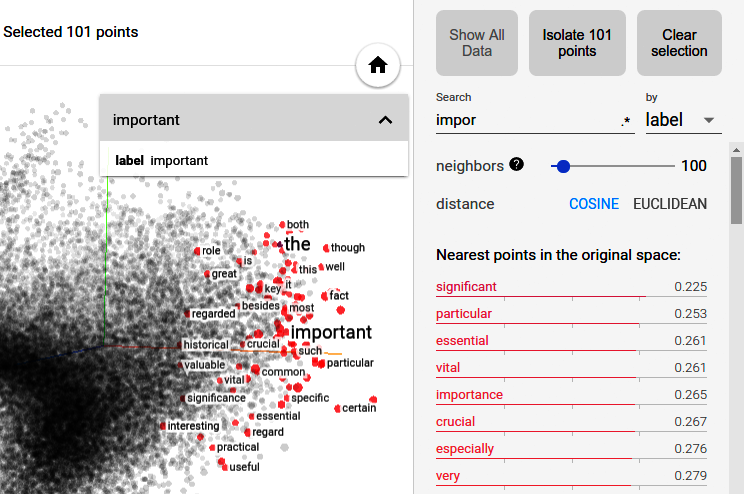

### <center><b>Incrustaciones estáticas</b></center>
Las incrustaciones estáticas son el tipo más antiguo de incrustación de palabras. Las incrustaciones se se generan a partir de un gran corpus, pero el número de palabras, aunque grande, es finito. Una incrustación estática es como un diccionario en el que las palabras son las claves y el vector correspondiente es el valor. Si hay que buscar una palabra cuya incrustación no está en el corpus original, no hay suerte. Además, una palabra tiene la misma incrustación independientemente de cómo se utilice, por lo que las incrustaciones estáticas no pueden abordar el problema de la polisemia, es decir, las palabras con múltiples significados.

### <center><b>Word2Vec</b></center>
Los modelos conocidos como Word2Vec fueron creados por primera vez en 2013 por un equipo de investigadores de Google dirigido por Tomas Mikolov. Los modelos son autosupervisados, es decir, son modelos supervisados que dependen de la estructura del lenguaje natural para proporcionar datos de entrenamiento etiquetados. 

Las dos arquitecturas de Word2Vec son las siguientes
- Bolsa continua de palabras (CBOW)
- Omitir el programa (Skip-gram)

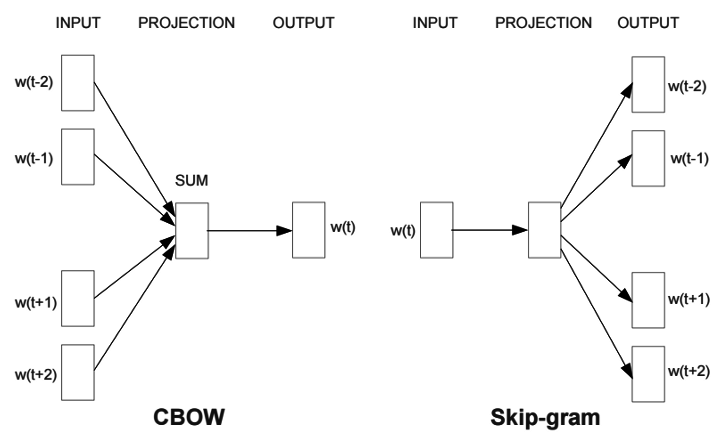

### Ejemplo

In [ ]:
dataset = api.load('text8')
modelo_wv = Word2Vec(dataset)
modelo_wv.save('/content/text8-word2vec.bin')

In [ ]:
# Definiendo metodo de impresion de más similar
def imprime_mas_similar(conf_pares_palabra, k):
  for i, (palabra, conf) in enumerate(conf_pares_palabra):
    print('{:.3f} {:s}'.format(conf, palabra))

    if (i >= k - 1):
      break

  if (k < len(conf_pares_palabra)):
    print('...')

In [ ]:
# Definiendo el modelo
modelo_wv_exp = KeyedVectors.load('/content/text8-word2vec.bin')
vectores_palabra = modelo_wv_exp.wv

In [ ]:
# Obteniendo palabras en el vocabulario
palabras = vectores_palabra.vocab.keys()
print([x for i, x in enumerate(palabras) if i < 10])
assert('king' in palabras)

print('Número de palabras similares a "King"')
imprime_mas_similar(vectores_palabra.most_similar('king'), 5)

['anarchism', 'originated', 'as', 'a', 'term', 'of', 'abuse', 'first', 'used', 'against']
Número de palabras similares a "King"
0.734 prince
0.718 emperor
0.703 throne
0.700 queen
0.694 kings
...


In [ ]:
print('# vector aritmético con palabras (Levy and Goldberg)')
print('# francia + berlin - parin = ?')
imprime_mas_similar(vectores_palabra.most_similar_cosmul(
    positive= ['france', 'berlin'], negative= ['paris']), 1)

# vector aritmético con palabras (Levy and Goldberg)
# francia + berlin - parin = ?
0.966 germany
...


In [ ]:
print('Encuentra la palabra que no coincida con el conjunto de palabras')
print('[hindus, parsis, singapore, christians]')
print(vectores_palabra.doesnt_match(
    ['hindus', 'parsis', 'singapore', 'christians']))

Encuentra la palabra que no coincida con el conjunto de palabras
[hindus, parsis, singapore, christians]
singapore


/usr/local/lib/python3.7/dist-packages/gensim/models/keyedvectors.py:895: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  vectors = vstack(self.word_vec(word, use_norm=True) for word in used_words).astype(REAL)


In [ ]:
print('Similitud entre palabras')
for palabra in ['woman', 'dog', 'whale', 'tree']:
  print('Similitud({:s}, {:s}) = {:.3f}'.format(
      'man', palabra, vectores_palabra.similarity('man', palabra)))

Similitud entre palabras
Similitud(man, woman) = 0.753
Similitud(man, dog) = 0.438
Similitud(man, whale) = 0.254
Similitud(man, tree) = 0.283


In [ ]:
print('#Similar por palabra')
print(imprime_mas_similar(vectores_palabra.similar_by_word('singapore'), 5))

#Similar por palabra
0.890 malaysia
0.842 philippines
0.834 indonesia
0.816 zambia
0.815 bahamas
...
None


In [ ]:
print('Distancia entre vectores')
print('Distancia(singapore, malaysia) = {:.3f}'.format(
    vectores_palabra.distance('singapore', 'malaysia')))

Distancia entre vectores
Distancia(singapore, malaysia) = 0.110


In [ ]:
vector_song = vectores_palabra['song']
print('Vector resultante obtenido directamente, forma:', vector_song.shape)

Vector resultante obtenido directamente, forma: (100,)


In [ ]:
vector_song_2 = vectores_palabra.word_vec('song', use_norm= True)
print('Vector resultante obtenido usando word_vec, forma: ', 
      vector_song_2.shape)

Vector resultante obtenido usando word_vec, forma:  (100,)


## <center><b>Capítulo 8: Redes Neuronales Recurrentes</b></center>
Las RNN son muy flexibles y se han utilizado para resolver problemas como el reconocimiento del habla, el lenguaje, la traducción automática, el análisis de sentimientos y el subtitulado de imágenes, por de imágenes, por nombrar algunos. Las RNN aprovechan la naturaleza secuencial de su entrada. Las entradas secuenciales pueden ser ser texto, voz, series temporales y cualquier otra cosa en la que la aparición de un elemento en una secuencia dependa de los elementos que le preceden. En este capítulo, veremos ejemplos de varias RNN, y aprenderemos a implementarlas con TensorFlow 2.0.

### <center><b>La célula básica de la RNN</b></center>
Las redes neuronales tradicionales de perceptrón multicapa suponen que todas las entradas son independientes unas de otras. Esta suposición no es cierta para muchos tipos de de datos secuenciales. Por ejemplo, las palabras de una frase, las notas musicales de una composición las cotizaciones bursátiles a lo largo del tiempo, o incluso las moléculas de un compuesto, son ejemplos de secuencias en las que un elemento mostrará una dependencia de los elementos anteriores.

Las células RNN incorporan esta dependencia al tener un estado oculto, o memoria, que que contiene la esencia de lo que se ha visto hasta ahora. El valor del estado oculto en cualquier El valor del estado oculto en cualquier momento es una función del valor del estado oculto en el paso de tiempo anterior, y el valor de la entrada en el paso de tiempo actual, es decir:

<center>$ℎ_𝑡 = 𝜙(ℎ_{𝑡-1}, 𝑋_𝑡)$</center>

Aquí, $h_t$ y $h_{t-1}$ son los valores de los estados ocultos en el tiempo $t$ y $t-1$ respectivamente, y $x_t$ es el valor de la entrada en el tiempo $t$. Obsérvese que la ecuación es recursiva, es decir, $h_{t-1}$ puede representarse en términos de $h_{t-2}$ y $x_{t-1}$, y así sucesivamente, hasta el principio de la secuencia. Así es como las RNN codifican e incorporan información de secuencias arbitrariamente largas.

### <center><b>Variantes de células RNN</b></center>

**Memoria a corto plazo (LSTM)**

La LSTM es una variante de la célula SimpleRNN que es capaz de aprender dependencias a largo plazo. Las LSTM fueron propuestas por primera vez por Hochreiter y SchmidHuber y perfeccionadas por muchos otros investigadores. Funcionan bien en una gran variedad de problemas y son la variante de RNN más utilizada.

**Unidad recurrente cerrada (GRU)**

La GRU es una variante de la LSTM y fue introducida por Cho. Mantiene la resistencia de la LSTM al problema del gradiente de fuga, pero su estructura interna es más simple y, por lo tanto, es más rápida de entrenar, ya que se necesitan menos cálculos para realizar actualizaciones de su estado oculto.

**Peephole LSTM **

La Peephole LSTM es una variante de la LSTM propuesta por primera vez por Gers y Schmidhuber. Añade "mirillas" a las puertas de entrada, olvido y salida, para que puedan ver el estado anterior de la célula ct-1. Las ecuaciones para calcular el estado oculto ht, en el tiempo t, a partir del estado oculto ht-1 en el paso de tiempo anterior, en una LSTM con mirilla se muestran a continuación. 

### <center><b>Variantes de RNN</b></center>

**RNNs Bidireccionales**

Que son esencialmente dos RNN apiladas una encima de la otra, una leyendo la entrada de izquierda a derecha, y la otra leyendo la entrada de derecha a izquierda. La salida en cada paso de tiempo se basará en el estado oculto de ambas RNN. Las RNN bidireccionales permiten a la red poner el mismo énfasis en el principio y en el final de la secuencia, y suelen dar lugar a mejoras de rendimiento.

**RNN con estado**

Las RNN también pueden ser de estado, lo que significa que pueden mantener el estado a través de lotes durante el entrenamiento. Es decir, el estado oculto calculado para un lote de datos de entrenamiento se se utilizará como estado oculto inicial para el siguiente lote de datos de entrenamiento. Sin embargo, esto debe establecerse explícitamente, ya que las RNN de TensorFlow 2.0 (tf.keras) no tienen estado por por defecto, y restablece el estado después de cada lote. Configurar una RNN para que tenga estado significa que puede construir el estado a través de su secuencia de entrenamiento e incluso mantener ese estado cuando hace predicciones.

### <center><b>Topologías RNN</b></center>

Hemos visto ejemplos de cómo las arquitecturas MLP y CNN pueden componerse para para formar redes más complejas. Las RNN ofrecen otro grado de libertad, ya que permiten una secuencia de entrada y salida. Esto significa que las celdas de las RNN pueden disponerse de diferentes maneras para construir redes que se adapten a resolver diferentes tipos de problemas. La figura 4 muestra cinco configuraciones diferentes de entradas, capas ocultas y salidas, representadas por cuadros rojos, verdes y azules respectivamente:

De ellas, la primera (uno a uno) no es interesante desde el punto de vista del procesamiento de secuencias, ya que puede implementarse como una simple red Dense con una entrada y una salida.

El caso de uno a muchos tiene una sola entrada y da como resultado una secuencia. Un ejemplo de este tipo de red Una red de este tipo podría ser una red capaz de generar etiquetas de texto a partir de imágenes que contengan breves descripciones de texto sobre distintos aspectos de la imagen. Una red de este tipo se entrenaría con una imagen de entrada y con secuencias de texto etiquetadas que representaran las etiquetas de la imagen:

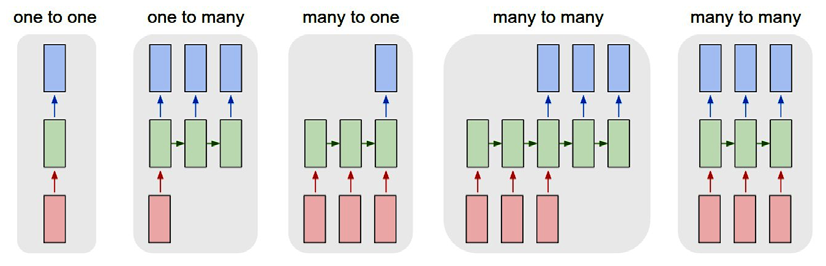

### Ejemplo: Muchos a uno - Análisis de sentimiento

In [ ]:
# Creando funciones para:
# limpiar los archivos logs
# descargar y leer el dataset

def limpiar_logs(directorio_datos):
  directorio_logs = os.path.join(directorio_datos, "logs")
  shutil.rmtree(directorio_logs, ignore_errors=True)
  return directorio_logs

'''
El conjunto de datos se proporciona como un archivo zip, que se expande en una 
carpeta que contiene tres archivos de frases etiquetadas, uno por cada 
proveedor, con una frase y una etiqueta por línea, con la frase y la etiqueta 
separadas por el carácter de tabulación. Primero descargamos el archivo zip 
y luego analizamos los archivos en una lista de pares (frase, etiqueta)
'''
def descargar_y_leer(url):
  archivo_local = url.split('/')[-1]
  archivo_local = archivo_local.replace("%20", " ")
  p = tf.keras.utils.get_file(archivo_local, url, extract=True, cache_dir=".")
  carpeta_local = os.path.join("datasets", archivo_local.split('.')[0])
  oraciones_etiquetadas = []

  for archivo_etiquetado in os.listdir(carpeta_local):
    if archivo_etiquetado.endswith("_labelled.txt"):
      with open(os.path.join(carpeta_local, archivo_etiquetado), "r") as f:
        for line in f:
          oracion, etiqueta = line.strip().split('\t')
          oraciones_etiquetadas.append((oracion, etiqueta))
                
  return oraciones_etiquetadas

In [ ]:
# descargamos y leemos los datos en estructuras
frases_etiquetadas = descargar_y_leer(
    "https://archive.ics.uci.edu/ml/machine-learning-databases/00331/sentiment%20labelled%20sentences.zip")
frases = [s for (s, l) in frases_etiquetadas]
etiquetas = [int(l) for (s, l) in frases_etiquetadas]

Nuestro objetivo es entrenar el modelo para que, dada una frase como entrada, aprenda a predecir el sentimiento correspondiente proporcionado en la etiqueta. Cada frase es una secuencia de palabras. Sin embargo, para introducirla en el modelo, tenemos que convertirla en una secuencia de enteros. Cada número entero de la secuencia señalará una palabra. El mapeo de enteros a palabras para nuestro corpus se denomina vocabulario. Así, en necesitamos tokenizar las frases y producir un vocabulario. Esto se hace con el siguiente código siguiente código:

In [ ]:
tokenizador = tf.keras.preprocessing.text.Tokenizer()
tokenizador.fit_on_texts(sentences)
tamano_vocabulario = len(tokenizador.word_counts)

print("Tamaño del vocabulario: {:d}".format(tamano_vocabulario))

Tamaño del vocabulario: 5271


In [ ]:
palabra_a_idx = tokenizador.word_index
idx_a_palabra = {v:k for (k, v) in palabra_a_idx.items()}

Nuestro vocabulario consta de 5271 palabras únicas. Es posible reducir el tamaño más pequeño eliminando las palabras que aparecen menos de un número determinado de veces, que se puede encontrar inspeccionando el diccionario tokenizer.word_counts. En estos En estos casos, tenemos que añadir 1 al tamaño del vocabulario para la entrada UNK (desconocida), que que se utilizará para reemplazar cada palabra que no se encuentre en el vocabulario.

También construimos diccionarios de búsqueda para convertir de palabra a índice de palabras y a la inversa. El primer diccionario es útil durante el entrenamiento, para construir secuencias enteras para alimentar la red. El segundo diccionario se utiliza para convertir de índice de palabras a palabra en nuestro código de predicción.

Cada frase puede tener un número diferente de palabras. Nuestro modelo nos exigirá que proporcionemos secuencias de enteros de idéntica longitud para cada frase. Con el fin de Para cumplir con este requisito, es habitual elegir una longitud de secuencia máxima que sea lo suficientemente grande como para acomodar la mayoría de las frases del conjunto de entrenamiento. Las frases de Las frases más cortas se rellenan con ceros y las más largas se truncan. más largas se truncarán. Una forma fácil de elegir un buen valor para la longitud máxima de la secuencia es longitud de la secuencia es observar la longitud de la frase (en número de palabras) en diferentes posiciones de percentil:

In [ ]:
secuencia_longitudes = np.array([len(s.split()) for s in frases])
print([(p, np.percentile(secuencia_longitudes, p)) for p 
       in [75, 80, 90, 95, 99, 100]])

[(75, 16.0), (80, 18.0), (90, 22.0), (95, 26.0), (99, 36.0), (100, 71.0)]


Como puede verse, la longitud máxima de las frases es de 71 palabras, pero el 99% de las frases son inferiores a 36 palabras. Si elegimos un valor de 64, por ejemplo, deberíamos poder de las frases. 

Los bloques de código anteriores pueden ejecutarse interactivamente varias veces para elegir valores adecuados de tamaño de vocabulario y longitud máxima de secuencia, respectivamente. En nuestro ejemplo, hemos elegido mantener todas las palabras (por lo que ```tamano_vacabulario``` = 5271), y hemos hemos fijado nuestro ```secuencia_long_max``` en 64. 

Nuestro siguiente paso es crear un conjunto de datos que nuestro modelo pueda consumir. Primero utilizamos nuestro tokenizador entrenado para convertir cada frase de una secuencia de palabras (```frases```) a una secuencia de enteros (```frases_como_enteros```), donde cada entero correspondiente es el índice de la palabra en el ```tokenizador.word_index```. A continuación, se trunca y con ceros. Las etiquetas también se convierten en una matriz NumPy ```etiquetas_como_enteros```, y finalmente, combinamos los tensores ```frases_como_enteros``` y ```etiquetas_como_enteros``` para formar un conjunto de datos TensorFlow:

In [ ]:
secuencia_long_max = 64
# create dataset
frases_como_enteros = tokenizador.texts_to_sequences(sentences)
frases_como_enteros = tf.keras.preprocessing.sequence.pad_sequences(
    frases_como_enteros, maxlen=secuencia_long_max)
etiquetas_como_enteros = np.array(etiquetas)
dataset = tf.data.Dataset.from_tensor_slices(
    (frases_como_enteros, etiquetas_como_enteros))

Queremos reservar 1/3 del conjunto de datos para la evaluación. De los datos restantes, utilizaremos un 10% como conjunto de datos de validación en línea que el modelo utilizará para medir su propio progreso durante el entrenamiento, y el resto como conjunto de datos de entrenamiento. Por último, creamos lotes de 64 frases para cada conjunto de datos:

In [ ]:
dataset = dataset.shuffle(10000)
tamano_test = len(frases) // 3
tamano_valor = (len(frases) - tamano_test) // 10
dataset_test = dataset.take(tamano_test)
valor_dataset = dataset.skip(tamano_test).take(tamano_valor)
dataset_entrenamiento = dataset.skip(tamano_test + tamano_valor)

tamano_lote = 64
dataset_entrenamiento = dataset_entrenamiento.batch(tamano_lote)
valor_dataset = valor_dataset.batch(tamano_lote)
dataset_test = dataset_test.batch(tamano_lote)

A continuación definimos nuestro modelo. Como puede ver, el modelo es bastante sencillo, cada frase de entrada es una secuencia de enteros de tamaño max_seqlen (64). Esto se introduce en una capa de incrustación que convierte cada palabra en un vector dado por el tamaño del vocabulario + 1. La palabra adicional es para tener en cuenta el entero de relleno 0 que fue introducido durante la llamada ```pad_sequences()``` anterior. El vector en cada uno de los 64 pasos de tiempo se introducen en una capa LSTM bidireccional, que convierte cada palabra en un vector de tamaño (64,). La salida de la LSTM en cada paso de tiempo se introduce en una capa Dense que produce un vector de tamaño (64,) con activación ReLU. La salida de esta capa La salida de esta capa densa se introduce en otra capa densa, que produce un vector de (1,) en cada paso de tiempo, modulado a través de una activación sigmoidea.

El modelo se compila con la función de pérdida de entropía cruzada binaria y el optimizador Adam, y luego se entrena durante 10 épocas:

In [ ]:
class SentimentAnalysisModel(tf.keras.Model):
  def __init__(self, vocab_size, max_seqlen, **kwargs):
    super(SentimentAnalysisModel, self).__init__(**kwargs)
    self.embedding = tf.keras.layers.Embedding(
        vocab_size, max_seqlen)
    self.bilstm = tf.keras.layers.Bidirectional(
        tf.keras.layers.LSTM(max_seqlen)
    )
    self.dense = tf.keras.layers.Dense(64, activation="relu")
    self.out = tf.keras.layers.Dense(1, activation="sigmoid")

    
  def call(self, x):
    x = self.embedding(x)
    x = self.bilstm(x)
    x = self.dense(x)
    x = self.out(x)
    return x

In [ ]:
modelo = SentimentAnalysisModel(tamano_vocabulario + 1, secuencia_long_max)
modelo.build(input_shape=(tamano_lote, secuencia_long_max))
modelo.summary()

Model: "sentiment_analysis_model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      multiple                  337408    
_________________________________________________________________
bidirectional_2 (Bidirection multiple                  66048     
_________________________________________________________________
dense_4 (Dense)              multiple                  8256      
_________________________________________________________________
dense_5 (Dense)              multiple                  65        
Total params: 411,777
Trainable params: 411,777
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# compilar modelo
modelo.compile(loss="binary_crossentropy", optimizer="adam", 
               metrics=["accuracy"])

# entrenar modelo
ubicacion_data = "./data"
ubicacion_logs = os.path.join("./logs")
archivo_mejor_modelo = os.path.join(ubicacion_data, "best_model.h5")
checkpoint = tf.keras.callbacks.ModelCheckpoint(archivo_mejor_modelo, 
                                save_weights_only=True, save_best_only=True)
tensorboard = tf.keras.callbacks.TensorBoard(log_dir=ubicacion_logs)
numero_epocas = 10
historia = modelo.fit(dataset_entrenamiento, epochs=numero_epocas,
   validation_data=val_dataset, callbacks=[checkpoint, tensorboard])

Epoch 1/10
29/29 [==============================] - 5s 64ms/step - loss: 0.6923 - accuracy: 0.5291 - val_loss: 0.6704 - val_accuracy: 0.7300
Epoch 2/10
29/29 [==============================] - 0s 16ms/step - loss: 0.6339 - accuracy: 0.7365 - val_loss: 0.4594 - val_accuracy: 0.8150
Epoch 3/10
29/29 [==============================] - 0s 14ms/step - loss: 0.3907 - accuracy: 0.8480 - val_loss: 0.2441 - val_accuracy: 0.9200
Epoch 4/10
29/29 [==============================] - 0s 14ms/step - loss: 0.2325 - accuracy: 0.9078 - val_loss: 0.2024 - val_accuracy: 0.9350
Epoch 5/10
29/29 [==============================] - 0s 15ms/step - loss: 0.1415 - accuracy: 0.9510 - val_loss: 0.0987 - val_accuracy: 0.9700
Epoch 6/10
29/29 [==============================] - 0s 15ms/step - loss: 0.0959 - accuracy: 0.9684 - val_loss: 0.0521 - val_accuracy: 0.9800
Epoch 7/10
29/29 [==============================] - 0s 16ms/step - loss: 0.0629 - accuracy: 0.9782 - val_loss: 0.0730 - val_accuracy: 0.9850
Epoch 8/10
29

Nuestra llamada de retorno al punto de control ha guardado el mejor modelo basado en el valor más bajo de la pérdida de validación, y ahora podemos recargarlo para evaluarlo contra nuestro conjunto de pruebas retenido:

In [ ]:
mejor_modelo = SentimentAnalysisModel(tamano_vocabulario + 1, 
                                      secuencia_long_max)
mejor_modelo.build(input_shape=(tamano_lote, secuencia_long_max))
mejor_modelo.load_weights(archivo_mejor_modelo)
mejor_modelo.compile( loss="binary_crossentropy", optimizer="adam",
   metrics=["accuracy"])

La forma más sencilla de evaluar un modelo con un conjunto de datos es utilizar la llamada model.
```evaluate()```:

In [ ]:
perdida_prueba, exactitud_test = mejor_modelo.evaluate(dataset_test)
print("Perdida en prueba: {:.3f}, Exactitud del test: {:.3f}".format(
    perdida_prueba, exactitud_test))

16/16 [==============================] - 1s 6ms/step - loss: 0.0292 - accuracy: 0.9958
Perdida en prueba: 0.027, Exactitud del test: 0.997


También podemos utilizar ```model.predict()``` para recuperar nuestras predicciones y compararlas individualmente con las etiquetas y utilizar herramientas externas (de scikit-learn, por ejemplo) para calcular nuestros resultados:

In [ ]:
etiquetas, predicciones = [], []
idx_a_palabra[0] = "PAD"
es_primer_lote = True

for test_lote in dataset_test:
  entradas_b, etiquetas_b = test_lote
  prediccion_lote = mejor_modelo.predict(entradas_b)
  predicciones.extend([(1 if p > 0.5 else 0) for p in prediccion_lote])
  etiquetas.extend([l for l in etiquetas_b])

  if es_primer_lote:
    for rid in range(entradas_b.shape[0]):
      palabras = [idx_a_palabra[idx] for idx in entradas_b[rid].numpy()]
      palabras = [w for w in palabras if w != "PAD"]
      frase = " ".join(palabras)
      print("{:d}\t{:d}\t{:s}".format(etiquetas[rid], predicciones[rid], frase))
    es_primer_lote = False

print("Score de exactitud: {:.3f}".format(accuracy_score(
    etiquetas, predicciones)))
print("Matriz de confusión")
print(confusion_matrix(etiquetas, predicciones))

0	0	avoid this establishment
0	0	avoid at all cost
1	1	i'll put this gem up against any movie in terms of screenplay cinematography acting post production editing directing or any other aspect of film making
1	1	you can even take self portraits with the outside exterior display very cool
1	1	great bluetooth
1	1	not only did the software do a great job of this i could also make my own ringtones form my existing cds without an internet connection
0	0	the sound quality for the device is unacceptable unless you are in a really quiet area you almost hear nothing
0	0	that's how i'd describe this painfully dreary time waster of a film
1	1	i'd love to go back
1	1	dessert panna cotta was amazing
0	0	the staff are now not as friendly the wait times for being served are horrible no one even says hi for the first 10 minutes
0	0	it was so boring
0	0	this is the first phone i've had that has been so cheaply made
0	0	bt50 battery junk
0	0	improper description i had to return it
0	0	it also had a new 

## <center><b>Capítulo 9: Autoencoders</b></center>
Los autocodificadores son una clase de red neuronal que intenta recrear la entrada como su objetivo utilizando la retropropagación. Un autocodificador consta de dos partes: un codificador y un decodificador. El codificador lee la entrada y la comprime en una representación compacta. representación compacta, y el decodificador leerá la representación compacta y recreará la entrada a partir de ella. En otras palabras, el autocodificador intenta aprender la función de identidad minimizando el error de reconstrucción. Tienen una capacidad inherente para aprender una representación compacta de los datos. Están en el centro de las redes de creencias profundas y encuentran aplicaciones en la reconstrucción de imágenes, clustering, traducción automática y mucho más.

### <center><b>Autoencoders Vanilla</b></center>
El autoencoder Vanilla, propuesto por Hinton en su artículo de 2006 Reducing the Dimensionality of Data with Neural Networks, consta de una sola capa oculta. El número de neuronas en la capa oculta es menor que el número de neuronas en la capa de entrada (o salida). 

Esto produce un efecto de cuello de botella en el flujo de información en la red. La capa oculta intermedia también se llama "capa cuello de botella". El aprendizaje en el autocodificador consiste en desarrollar una representación compacta de la señal de entrada en la capa oculta para que la capa de salida pueda reproducir fielmente la entrada original.

En el siguiente diagrama se puede ver la arquitectura del autocodificador Vanilla:

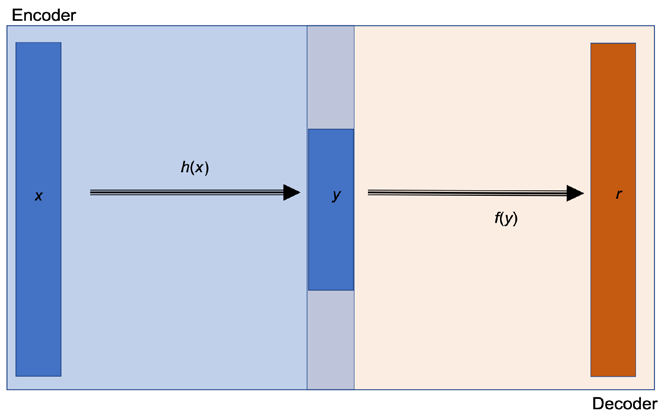

### <center><b>Autocodificador disperso</b></center>
El autoencoder vainilla funciona más bien como una red de identidad; simplemente reconstruye la entrada. El énfasis está en reconstruir la imagen a nivel de píxel, y la única restricción es el número de unidades en la capa de cuello de botella.
Aunque es interesante, la reconstrucción a nivel de píxel no garantiza que la red aprenda características abstractas del conjunto de datos. Podemos garantizar que una red aprenda características abstractas del conjunto de datos añadiendo más restricciones.

En los autocodificadores dispersos, se añade un término de penalización disperso al error de reconstrucción.
Esto trata de asegurar que menos unidades en la capa de cuello de botella se disparen en un momento dado.
Podemos incluir la penalización dispersa dentro de la propia capa del codificador. En el siguiente código, puede ver que la capa Dense del codificador tiene ahora un parámetro adicional, activity_regularizer

El regularizador de actividad trata de reducir la salida de la capa. Reducirá tanto los pesos como el sesgo de la capa totalmente conectada para asegurar que la salida sea lo más pequeña posible. TensorFlow soporta tres tipos de activity_regularizer:
- ```l1```: Aquí la actividad se calcula como la suma de valores absolutos
- ```l2```: Aquí la actividad se calcula como la suma de los valores al cuadrado
- ```l1_l2```: Incluye los términos L1 y L2

### <center><b>Autocodificadores de eliminación de ruido</b></center>

Los dos autocodificadores anteriores son ejemplos de autocodificadores incompletos, porque la capa oculta en ellos tiene una dimensionalidad menor en comparación con la capa de entrada (salida). Los autocodificadores de eliminación de ruido pertenecen a la clase de autocodificadores sobrecompletos, porque funcionan mejor cuando las dimensiones de la capa oculta son mayores que las de la capa de entrada.

Un autocodificador de eliminación de ruido aprende a partir de una entrada corrupta (con ruido); alimenta a su red de codificación con la entrada con ruido, y luego la imagen reconstruida del decodificador se compara con la entrada original. La idea es que esto ayude a la red a aprender cómo denotar una entrada. Ya no se limitará a hacer comparaciones por píxel, sino que para desentrañar aprenderá también la información de los píxeles vecinos.

Un autocodificador de eliminación de ruido tiene dos diferencias principales con respecto a otros autocodificadores: en primer lugar, ```n_oculto```, el número de unidades ocultas en la capa de cuello de botella es mayor que el número de unidades en la capa de entrada, ```m```, es decir, ```n_ocultas``` > ```m```. 
 En segundo lugar, la entrada del codificador es una entrada corrupta. 

### <center><b>Autocodificador apilado </b></center>

Hasta ahora nos hemos limitado a los autocodificadores con una sola capa oculta. Podemos construir autocodificadores profundos apilando muchas capas tanto del codificador como del decodificador; un autocodificador de este tipo se denomina autocodificador apilado. Las características extraídas extraídas por un codificador se pasan al siguiente codificador como entrada. El autocodificador apilado puede ser entrenado como una red completa con el objetivo de minimizar el error de error de reconstrucción. O bien, cada red individual de codificadores/decodificadores puede ser preentrenada utilizando el método no supervisado que aprendiste antes, y luego la red completa puede la red completa. Cuando la red autocodificadora profunda es una red convolucional, la llamamos autocodificador convolucional.

### Ejemplo: Autoencoder Convolucional

In [ ]:
# Especificamos nuestros hiperparámetros
np.random.seed(11)
tf.random.set_seed(11)
tamano_lote = 128
maximo_de_epocas = 50
filtros = [32, 32, 16]

Leemos los datos y los preprocesamos. Una vez más, se puede observar una ligera variación del código anterior, especialmente en la forma en que estamos añadiendo ruido y luego limitar el rango entre [0-1]. Lo hacemos porque en este caso, en lugar de la pérdida de error cuadrático medio, utilizaremos la pérdida de entropía cruzada binaria y la salida final del decodificador pasará por la activación sigmoidea, restringiéndola entre [0-1]:

In [ ]:
(x_entrenamiento, _), (x_test, _) = K.datasets.mnist.load_data()
x_entrenamiento = x_entrenamiento / 255.
x_test = x_test / 255.
x_entrenamiento = np.reshape(x_entrenamiento, (len(x_entrenamiento),28, 28, 1))
x_test = np.reshape(x_test, (len(x_test), 28, 28, 1))
ruido = 0.5
x_entrenamiento_ruidosa = x_entrenamiento + ruido * np.random.normal(loc=0.0, 
                                      scale=1.0, size = x_entrenamiento.shape)
x_test_ruidoso = x_test + ruido * np.random.normal(loc=0.0, scale=1.0, 
                                                 size=x_test.shape)
x_entrenamiento_ruidosa = np.clip(x_entrenamiento_ruidosa, 0, 1)
x_test_ruidoso = np.clip(x_test_ruidoso, 0, 1)
x_entrenamiento_ruidosa = x_entrenamiento_ruidosa.astype('float32')
x_test_ruidoso = x_test_ruidoso.astype('float32')

11493376/11490434 [==============================] - 0s 0us/step


Definamos ahora nuestro codificador. El codificador consta de tres capas convolucionales, cada una de ellas seguida de una capa de agrupación máxima. Como estamos utilizando el conjunto de datos MNIST, la forma de la imagen de entrada es de 28 × 28 (un solo canal) y la imagen de salida tiene un tamaño de 4 × 4 (y como la última capa convolucional tiene 16 filtros, la imagen tiene 16 canales)

In [ ]:
class Encoder(K.layers.Layer):
  def __init__(self, filters):
    super(Encoder, self).__init__()
    self.conv1 = Conv2D(filters=filters[0], kernel_size=3, strides=1,
                        activation='relu', padding='same')
    self.conv2 = Conv2D(filters=filters[1], kernel_size=3, strides=1,
                        activation='relu', padding='same')
    self.conv3 = Conv2D(filters=filters[2], kernel_size=3, strides=1,
                        activation='relu', padding='same')
    self.pool = MaxPooling2D((2, 2), padding='same')
          
   
  def call(self, input_features):
    x = self.conv1(input_features)
    x = self.pool(x)
    x = self.conv2(x)
    x = self.pool(x)
    x = self.conv3(x)
    x = self.pool(x)
    return x

A continuación viene el decodificador. Es exactamente lo contrario del codificador en el diseño, y en lugar de max pooling estamos utilizando upsampling para aumentar el tamaño de nuevo. Fíjate en las declaraciones de impresión comentadas: puedes usarlas para entender cómo se modifica la forma después de cada paso. También observa que tanto el codificador como el decodificador siguen siendo clases basadas en la clase TensorFlow Keras Layers, pero ahora tienen múltiples capas dentro de ellas.

In [ ]:
class Decoder(K.layers.Layer):
  def __init__(self, filters):
    super(Decoder, self).__init__()
    self.conv1 = Conv2D(filters=filters[2], kernel_size=3, strides=1, 
                        activation='relu', padding='same')
    self.conv2 = Conv2D(filters=filters[1], kernel_size=3, strides=1, 
                        activation='relu', padding='same')
    self.conv3 = Conv2D(filters=filters[0], kernel_size=3, strides=1, 
                        activation='relu', padding='valid')
    self.conv4 = Conv2D(1, 3, 1, activation='sigmoid', padding='same')
    self.upsample = UpSampling2D((2, 2))


  def call(self, encoded):
    x = self.conv1(encoded)
    #print("dx1", x.shape)
    x = self.upsample(x)
    #print("dx2", x.shape)
    x = self.conv2(x)
    x = self.upsample(x)
    x = self.conv3(x)
    x = self.upsample(x)
    return self.conv4(x)

Combinamos el codificador y el decodificador para hacer un modelo de autocodificador.
Esto sigue siendo exactamente igual que antes:

In [ ]:
class Autoencoder(K.Model):
  def __init__(self, filters):
    super(Autoencoder, self).__init__()
    self.encoder = Encoder(filters)
    self.decoder = Decoder(filters)


  def call(self, input_features):
    encoded = self.encoder(input_features)
    reconstructed = self.decoder(encoded)
    return reconstructed

Ahora instanciamos nuestro modelo, luego especificamos la entropía cruzada binaria como la función de pérdida y Adam como el optimizador en el método ```compile()```. A continuación, ajustamos el modelo al conjunto de datos de entrenamiento:

In [ ]:
modelo = Autoencoder(filtros)
modelo.compile(loss='binary_crossentropy', optimizer='adam')
perdida = modelo.fit(x_entrenamiento_ruidosa, x_entrenamiento, 
                 validation_data=(x_test_ruidoso, x_test), 
                 epochs=maximo_de_epocas, batch_size=tamano_lote)

Epoch 1/50
469/469 [==============================] - 6s 9ms/step - loss: 0.2735 - val_loss: 0.1497
Epoch 2/50
469/469 [==============================] - 4s 8ms/step - loss: 0.1456 - val_loss: 0.1311
Epoch 3/50
469/469 [==============================] - 4s 8ms/step - loss: 0.1302 - val_loss: 0.1226
Epoch 4/50
469/469 [==============================] - 4s 8ms/step - loss: 0.1222 - val_loss: 0.1178
Epoch 5/50
469/469 [==============================] - 4s 8ms/step - loss: 0.1179 - val_loss: 0.1140
Epoch 6/50
469/469 [==============================] - 4s 8ms/step - loss: 0.1147 - val_loss: 0.1125
Epoch 7/50
469/469 [==============================] - 4s 8ms/step - loss: 0.1125 - val_loss: 0.1102
Epoch 8/50
469/469 [==============================] - 4s 8ms/step - loss: 0.1110 - val_loss: 0.1086
Epoch 9/50
469/469 [==============================] - 4s 8ms/step - loss: 0.1092 - val_loss: 0.1074
Epoch 10/50
469/469 [==============================] - 4s 8ms/step - loss: 0.1083 - val_loss: 0.1069

Se puede ver la curva de pérdidas a medida que se entrena el modelo; en 50 épocas la pérdida se redujo a 0,0985

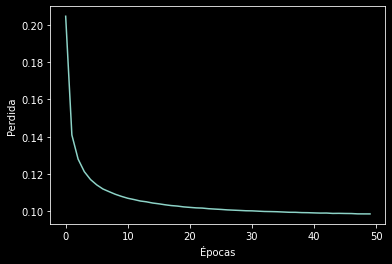

In [ ]:
plt.plot(range(maximo_de_epocas), perdida.history['loss'])
plt.xlabel('Épocas')
plt.ylabel('Perdida')
plt.show()

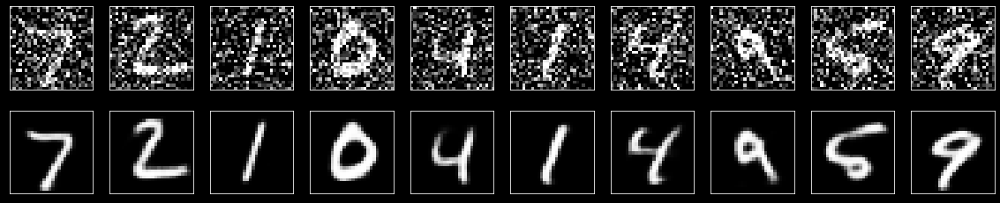

In [ ]:
# Ver las imágenes reconstruidas del las imagenes de entrada ruidosas
numero = 10  # how many digits we will display
plt.figure(figsize=(20, 4))

for indice in range(numero):
  # muestra las imagenes originales
  ax = plt.subplot(2, numero, indice + 1)
  plt.imshow(x_test_ruidoso[indice].reshape(28, 28), cmap='gray')
  ax.get_xaxis().set_visible(False)
  ax.get_yaxis().set_visible(False)

  # muestra la reconstruccion
  ax = plt.subplot(2, numero, indice + 1 + numero)
  plt.imshow(tf.reshape(modelo(x_test_ruidoso)[indice], (28, 28)), cmap='gray')
  ax.get_xaxis().set_visible(False)
  ax.get_yaxis().set_visible(False)
plt.show()

## <center><b>Capítulo 10: Aprendizaje no supervisado</b></center>
A diferencia del aprendizaje supervisado, en el que el conjunto de datos de entrenamiento está formado por la de entrada y las etiquetas deseadas, el aprendizaje no supervisado se ocupa del caso en el que el modelo sólo se le proporciona la entrada. El modelo aprende la distribución de entrada inherente por sí mismo, sin ninguna etiqueta deseada que lo guíe. La agrupación y la reducción de la dimensionalidad son las dos técnicas de aprendizaje no supervisado más utilizadas. En este capítulo aprenderemos sobre diferentes técnicas de aprendizaje automático y NN para ambas. Cubriremos las técnicas necesarias para el clustering y la reducción de la dimensionalidad dimensionalidad, y entraremos en los detalles de las máquinas de Boltzmann, y finalmente la implementación de dichas técnicas con TensorFlow. Los conceptos de conceptos cubiertos serán extendidos para construir Máquinas de Boltzmann Restringidas (RBMs)

### <center><b>Análisis de componentes principales</b></center>

El análisis de componentes principales (ACP) es la técnica estadística multivariante más popular multivariante para la reducción de la dimensionalidad. Analiza los datos de entrenamiento que constan de varias variables dependientes, que en general están interrelacionadas, y extrae información importante de los datos de entrenamiento en forma de un conjunto de nuevas variables ortogonales ortogonales denominadas componentes principales. Podemos realizar el ACP mediante dos métodos o bien utilizando la descomposición de los valores propios o bien utilizando la descomposición de los valores singulares (SVD).

El PCA reduce los datos de entrada n-dimensionales a datos de entrada r-dimensionales, donde $r<n$. En términos más sencillos, el PCA consiste en trasladar el origen y realizar una rotación del eje de forma que uno de los ejes (eje principal) tenga la mayor varianza con los puntos de datos. Se obtiene un conjunto de datos de dimensiones reducidas a partir del conjunto de datos original realizando esta transformación y eliminando los ejes ortogonales con baja varianza. Aquí empleamos el método SVD para la reducción de la dimensionalidad del PCA. Consideremos X, los datos n-dimensionales con p puntos, es decir, X es una matriz de tamaño p × n. Desde el álgebra lineal sabemos que cualquier matriz real puede ser descompuesta utilizando la descomposición del valor singular:

<center>$X = U \Sigma V^T$</center>

Donde U y V son matrices ortonormales (es decir, U.UT = V.VT = 1) de tamaño p × p y n × n respectivamente. Σ es una matriz diagonal de tamaño p × n. La matriz U se llama matriz singular izquierda, y V la matriz singular derecha, y Σ , la matriz diagonal, contiene los valores singulares de X como sus elementos diagonales. Aquí asumimos que la matriz X está centrada. Las columnas de la matriz V son los componentes principales, y las columnas de 𝑈Σ son los datos transformados por componentes principales.

Ahora para reducir las dimensiones de los datos de n a k (donde k < n) seleccionaremos las primeras k columnas de U y la parte superior izquierda k × k de Σ . El producto de las dos nos da nuestra matriz de dimensiones reducidas:

<center>$Y_k = U\Sigma_k$</center>

### <center><b>Mapas autoorganizados</b></center>

Tanto k-means como PCA pueden agrupar los datos de entrada; sin embargo, no mantienen la relación topológica. En esta sección consideraremos los mapas autoorganizados (SOM), a veces conocidos como redes Kohonen o Winner take all units (WTU). Mantienen la relación topológica. Los SOM son un tipo de red neuronal muy especial, inspirada en una característica distintiva del cerebro humano. En nuestro cerebro, las diferentes entradas sensoriales se representan de forma topológicamente ordenada. A diferencia de otras redes neuronales, las neuronas no están conectadas entre sí mediante pesos, sino que influyen en el aprendizaje de las demás. El aspecto más importante de las SOM es que las neuronas representan las entradas aprendidas de forma topográfica. Fueron propuestas por Tuevo Kohonen en 1989.

En los SOM, las neuronas suelen colocarse en los nodos de un entramado (1D o 2D). También son posibles dimensiones más altas, pero en la práctica se utilizan raramente. Cada neurona de la red está conectada a todas las unidades de entrada mediante una matriz de pesos. El siguiente diagrama muestra un SOM de 6 × 8 (48 neuronas) y 5 entradas. Para mayor claridad, sólo se muestran los vectores de peso que conectan todas las entradas a una neurona. En este caso, cada neurona tendrá siete elementos, lo que resulta en una matriz de pesos combinada de tamaño (40 × 5):

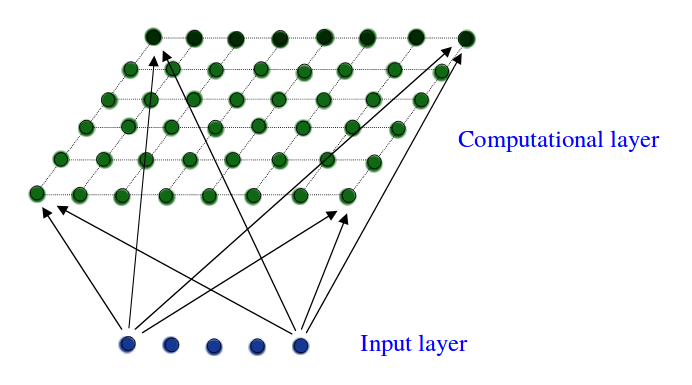

### <center><b>Máquinas de Boltzmann restringidas</b></center>

La RBM es una red neuronal de dos capas: la primera se llama capa visible y la segunda capa se llama capa oculta. Se denominan redes neuronales superficiales porque sólo tienen dos capas de profundidad. Fueron propuestas por primera vez en 1986 por Paul Smolensky (las llamó Redes de Armonía) y posteriormente por Geoffrey Hinton, que en 2006 propuso la Divergencia Contrastiva (CD) como método para entrenarlas. Todas las neuronas de la capa visible están conectadas a todas las neuronas de la capa oculta, pero hay una restricción: ninguna neurona de la misma capa puede estar conectada. Todas las neuronas del RBM son de naturaleza binaria. 

Los RBM pueden utilizarse para la reducción de la dimensionalidad, la extracción de características y el filtrado y el filtrado colaborativo. El entrenamiento de los RBM puede dividirse en tres partes: paso hacia delante el paso hacia atrás y la comparación.

### Ejemplo: Mapas Autoorganizados

El componente principal del código es nuestra clase WTU. La función ```__init__``` de la clase inicializa varios hiperparámetros de nuestro SOM, las dimensiones de nuestra red 2D (m, n), el número de características en la entrada (dim), el radio de vecindad (sigma), los pesos iniciales y la información topográfica:

In [ ]:
# Define the Winner Take All units
class WTU(object):
    
       
  def __init__(self, m, n, dim, num_iterations, eta = 0.5, sigma = None):
    '''
    m x n: La dimensión del entramado 2D en el que se disponen las neuronas
    dim: Dimensión de los datos de entrenamiento de entrada
    num_iterations: Número total de iteraciones de entrenamiento
    eta: Tasa de aprendizaje
    sigma: El radio de la función de vecindad.
    '''    
    self._m = m
    self._n = n
    self._neighbourhood = []
    self._topography = []
    self._num_iterations = int(num_iterations) 
    self._learned = False
    self.dim = dim
    
    self.eta = float(eta)
       
    if sigma is None:
      # Radio constante
      sigma = max(m,n)/2.0
    else:
      sigma = float(sigma)
    self.sigma = sigma    
        
    print('Network created with dimensions',m,n)
        
    # Weight Matrix and the topography of neurons
    self._W = tf.random.normal([m*n, dim], seed = 0)
    self._topography = np.array(list(self._neuron_location(m, n)))
            
               
  '''
  La función más importante de la clase es la función train(), en la que 
  utilizamos el algoritmo de Kohonen, tal y como se ha comentado 
  anteriormente, para encontrar las unidades ganadoras y, a continuación, 
  actualizar los pesos basándonos en la función de vecindad:
  '''      
  def training(self,x, i):
    m = self._m
    n= self._n 
    
    # Encontrar el ganador y su ubicación
    d = tf.sqrt(tf.reduce_sum(tf.pow(self._W - tf.stack([x for i in range(m*n)]),2),1))
    self.WTU_idx = tf.argmin(d,0)
    
    slice_start = tf.pad(tf.reshape(self.WTU_idx, [1]),np.array([[0,1]]))
    self.WTU_loc = tf.reshape(tf.slice(self._topography, slice_start,[1,2]), [2])
    
    
    # Cambiar la tasa de aprendizaje y el radio en función de las iteraciones
    learning_rate = 1 - i/self._num_iterations
    _eta_new = self.eta * learning_rate
    _sigma_new = self.sigma * learning_rate
    
    
    # Cálculo de la función de vecindad
    distance_square = tf.reduce_sum(tf.pow(tf.subtract(
        self._topography, tf.stack([self.WTU_loc for i in range(m * n)])), 2), 1)
    neighbourhood_func = tf.exp(tf.negative(tf.math.divide(tf.cast(
        distance_square, "float32"), tf.pow(_sigma_new, 2))))
    
    # Multiplicar la tasa de aprendizaje con la función de vecindad
    eta_into_Gamma = tf.multiply(_eta_new, neighbourhood_func)
    
    # Dale forma para que se pueda multiplicar para calcular dW
    weight_multiplier = tf.stack([tf.tile(tf.slice(
        eta_into_Gamma, np.array([i]), np.array([1])), [self.dim])
        for i in range(m * n)])
    delta_W = tf.multiply(weight_multiplier,
        tf.subtract(tf.stack([x for i in range(m * n)]),self._W))
    new_W = self._W + delta_W
    self._W = new_W
            

  '''
  La función fit() es una función de ayuda que llama a la función train() 
  y almacena la cuadrícula del centroide para facilitar su recuperación:
  '''         
  def fit(self, X):
    for i in range(self._num_iterations):
      for x in X:
        self.training(x,i)

    # Almacenar una cuadrícula de centroides para facilitar su recuperación
    centroid_grid = [[] for i in range(self._m)]
    self._Wts = list(self._W)
    self._locations = list(self._topography)

    for i, loc in enumerate(self._locations):
        centroid_grid[loc[0]].append(self._Wts[i])

    self._centroid_grid = centroid_grid
    self._learned = True


  '''
  Luego hay algunas funciones más de ayuda para encontrar el ganador y 
  generar un entramado 2D de neuronas, y una función para asignar vectores 
  de entrada a las neuronas correspondientes en el entramado 2D:
  '''
  def winner(self, x):
    idx = self.WTU_idx,self.WTU_loc
    return idx
           
  def _neuron_location(self,m,n):
    for i in range(m):
      for j in range(n):
        yield np.array([i,j])
              
              
  def get_centroids(self): 
    if not self._learned:
      raise ValueError("SOM no esta entrenado aun")
    return self._centroid_grid

  def map_vects(self, X):
    if not self._learned:
      raise ValueError("SOM no esta entrenado aun")

    to_return = []
    for vect in X:
      min_index = min([i for i in range(len(self._Wts))],
                        key=lambda x: np.linalg.norm(vect -
                                                     self._Wts[x]))
      to_return.append(self._locations[min_index])

    return to_return

In [ ]:
# También necesitaremos normalizar los datos de entrada, así que creamos una 
# función para hacerlo:
def normalize(df):
    result = df.copy()
    for feature_name in df.columns:
        max_value = df[feature_name].max()
        min_value = df[feature_name].min()
        result[feature_name] = (df[feature_name] - min_value) / (max_value - min_value)
    return result.astype(np.float32)

In [ ]:
# Leamos los datos. Los datos contienen los valores de los canales Rojo, Verde 
# y Azul. Vamos a normalizarlos:
# La ultima columna de los datos es una etiqueta
df = pd.read_csv('https://raw.githubusercontent.com/PacktPublishing/Deep-Learning-with-TensorFlow-2-and-Keras/master/Chapter%2010/colors.csv')  # The last column of data file is a label
data = normalize(df[['R', 'G', 'B']]).values
name = df['Color-Name'].values
n_dim = len(df.columns) - 1

In [ ]:
# Data para entrenamiento
colors = data
color_names = name

In [ ]:
# Ahora creamor nuestro SOM y lo entrenamos
som = WTU(30, 30, n_dim, 400, sigma=10.0)
som.fit(colors)

Network created with dimensions 30 30


In [ ]:
# Obtenemos la malla de salida
image_grid = som.get_centroids()

In [ ]:
# Mapeamos colores para las neuronas cercanas
mapped = som.map_vects(colors)

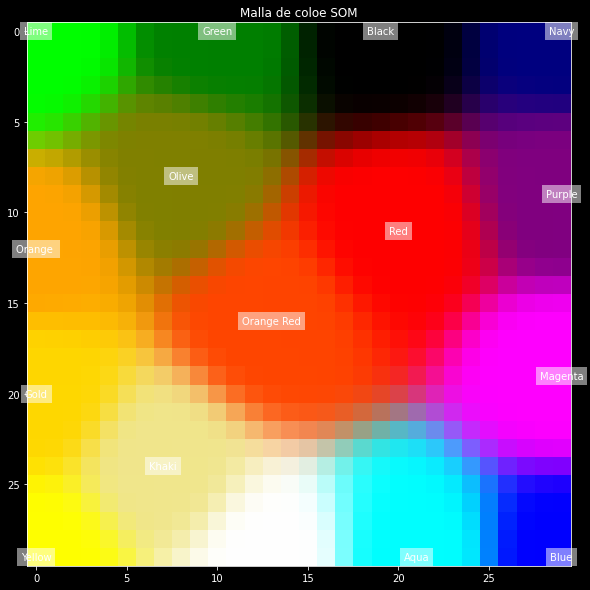

In [ ]:
# Plot
figura =plt.figure(figsize=(10, 10))
plt.imshow(image_grid)
plt.title('Malla de coloe SOM')
for i, m in enumerate(mapped):
  plt.text(m[1], m[0], color_names[i], ha='center', va='center',
             bbox=dict(facecolor='white', alpha=0.5, lw=0))

## <center><b>Capítulo 11: Aprendizaje por refuerzo</b></center>
El aprendizaje por refuerzo es muy diferente de los modelos de aprendizaje supervisado y no supervisado que hemos realizado en capítulos anteriores. Partiendo de una pizarra limpia (es decir, sin información previa), el agente de RL puede pasar por múltiples etapas de aciertos y ensayos, y aprender a alcanzar un objetivo, todo ello la única entrada es la retroalimentación del entorno. Las últimas investigaciones en RL de OpenAI parecen sugerir que la competencia continua puede ser una causa de la evolución de la inteligencia. Muchos profesionales del aprendizaje profundo creen que la RL desempeñará un papel importante en el gran sueño de la IA: La Inteligencia General Artificial (AGI)

### <center><b>Introducción a OpenAI Gym</b></center>

Como se ha mencionado anteriormente, el ensayo y error es un componente importante de cualquier algoritmo de RL. Por lo tanto, tiene sentido entrenar nuestro agente RL primero en un entorno simulado.

Hoy en día existe un gran número de plataformas que pueden ser utilizadas para la creación de un entorno. Algunas de las más populares son

- **OpenAI Gym**: Contiene una colección de entornos que podemos utilizar para entrenar a nuestros agentes de RL. En este capítulo utilizaremos la interfaz de OpenAI Gym.
- **Unity ML-Agents SDK**: Permite a los desarrolladores transformar los juegos y simulaciones creados con el editor de Unity en entornos en los que se pueden entrenar agentes inteligentes utilizando DRL, estrategias evolutivas u otros métodos de aprendizaje automático a través de una API de Python fácil de usar. Funciona con TensorFlow y ofrece la posibilidad de entrenar agentes inteligentes para juegos 2D/3D y VR/AR. Puedes saber más sobre él aquí: https://github.com/Unity-Technologies/ml-agents.
- **Gazebo**: En Gazebo podemos construir mundos tridimensionales con simulación basada en la física. Gazebo junto con Robot Operating System (ROS) y la interfaz OpenAI Gym es gym-gazebo y puede ser utilizado para entrenar agentes RL. Para saber más sobre esto, puedes consultar el libro blanco: https://arxiv.org/abs/1608.05742.
- **Entorno de aprendizaje Blender**: Es una interfaz de Python para el motor de juegos Blender, y también funciona sobre OpenAI Gym. Tiene como base Blender: un software gratuito de modelado 3D con un motor de juegos integrado. Esto proporciona un conjunto de herramientas fácil de usar y potente para crear juegos. Proporciona una interfaz para el motor de juegos de Blender, y los propios juegos se diseñan en Blender. Así podemos crear el entorno virtual personalizado para entrenar a un agente de RL en un problema específico (https://github.com/LouisFoucard/gym-blender).
- **Malmö**: Construida por el equipo de Microsoft, Malmö es una plataforma para la experimentación e investigación de la IA construida sobre Minecraft. Ofrece una sencilla API para crear tareas y misiones. Puedes saber más sobre el Proyecto Malmo aquí: https://www.microsoft.com/enus/research/project/projectmalmo/.

### <center><b>Redes Q profundas</b></center>

Las redes Q profundas, abreviadas DQN, son redes neuronales de aprendizaje profundo diseñadas para aproximar la función Q (función valor-estado), es uno de los algoritmos de algoritmos de aprendizaje por refuerzo basados en valores. El modelo fue propuesto por DeepMind de Google en NIPS 2013, en el artículo titulado Playing Atari with Deep Reinforcement Learning. La contribución más importante de este trabajo fue que  el espacio de estados en bruto directamente como entrada a la red; las características de entrada no se  no fueron creadas a mano como se hizo en implementaciones anteriores de RL. Además, pudieron entrenar al agente con exactamente la misma arquitectura para jugar a diferentes juegos Atari y obtener resultados los resultados más avanzados.

### <center><b>Gradiente de política determinista profunda</b></center>

DQN y sus variantes han tenido mucho éxito en la resolución de problemas en los que el espacio de estado es continuo y el espacio de acción es discreto. Por ejemplo, en los juegos de Atari, el espacio de entrada consiste en píxeles en bruto, pero las acciones son discretas - [arriba, abajo, izquierda, derecha, no-op]. ¿Cómo resolvemos un problema con un espacio de acción continuo? Por ejemplo, digamos que un agente RL que conduce un coche necesita girar sus ruedas: esta acción tiene un espacio de acción continuo Una forma de manejar esta situación es discretizando el espacio de acción y continuando con DQN o sus variantes. Sin embargo, una solución mejor sería utilizar un algoritmo de gradiente de política. En los métodos de gradiente de política, la política 𝜋(𝐴|𝑆) se aproxima directamente. 

### Ejemplo: 

In [ ]:
# Creamos nuestro entorno Gym
nombre_entorno = 'Breakout-v0'
entorno = gym.make(nombre_entorno)

A continuación, ejecutaremos el juego, paso a paso, eligiendo una acción al azar, durante 300 pasos o hasta que el juego termine (lo que ocurra antes). El espacio de estado del entorno (observación) se guarda en cada paso en los marcos de la lista

In [ ]:
# array para almacenar el espacio de estado en cada paso
marcos = [] 

entorno.reset()
listo = False

for _ in range(300): 
  marcos.append(entorno.render(mode='rgb_array'))
  obs, premio, listo, _ = entorno.step(entorno.action_space.sample())

  if listo:
    break

Ahora viene la parte de combinar todos los fotogramas como una imagen gif usando Matplotlib Animation. Creamos un objeto imagen, patch, y luego definimos una función que establece los datos de la imagen en un índice de fotogramas determinado. La función es utilizada por la clase Matplotlib Animation para crear una animación, que finalmente guardamos en el archivo ```random_agent.gif```

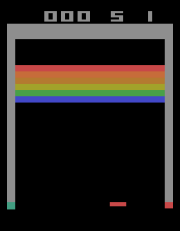

In [ ]:
parche = plt.imshow(marcos[0])
plt.axis('off')

def animate(i):
  parche.set_data(marcos[i])

animacion = animation.FuncAnimation(plt.gcf(), animate, frames=len(marcos), 
                               interval=10)

animacion.save('random_agent.gif', writer='pillow')

Normalmente, un agente RL requiere muchos pasos para un entrenamiento adecuado, y como resultado no es factible almacenar el espacio de estados en cada paso. En su lugar, podemos optar por almacenar después de cada 500º paso (o cualquier otro número que se desee) en el algoritmo anterior. OpenAI Gym proporciona la clase Wrapper para guardar el juego como un vídeo. Para ello, tenemos que necesitamos primero importar wrappers, luego crear el entorno, y finalmente usar Monitor.

Por defecto, se guardará el vídeo de 1, 8, 27, 64, (números de episodio con cubos perfectos), y así sucesivamente y luego cada 1.000 episodios; cada entrenamiento, por defecto, se guarda en una carpeta. El código para hacer esto es

In [ ]:
entorno = gym.make("Breakout-v0")
entorno = gym.wrappers.Monitor(entorno, 'recording', force=True)
observacion = entorno.reset()

for _ in range(1000):
  #env.render()
  action = entorno.action_space.sample() # your agent here (this takes random actions)
  observacion, premio, listo, info = entorno.step(action)

  if listo:
    observacion = entorno.reset()

entorno.close()

## <center><b>Capítulo 12: Tensorflow y la nube</b></center>
Los algoritmos de IA requieren amplios recursos informáticos. Con la disponibilidad de un gran número de plataformas en la nube que ofrecen sus servicios a precios competitivos, la computación en nube ofrece una solución rentable. En este capítulo, hablaremos de tres principales proveedores de plataformas en la nube que ocupan la mayor parte de la cuota de mercado: Amazon Web Services (AWS), Microsoft Azure y Google Cloud Platform. Además, una vez que hayas entrenado tu modelo en la nube, puedes utilizar TensorFlow Extended (TFX) para trasladar tu modelo a producción.

### <center><b>Aprendizaje profundo en la nube</b></center>

Hubo un tiempo en el que, si querías trabajar en el campo del aprendizaje profundo, necesitabas desembolsar miles de dólares para obtener la infraestructura necesaria para entrenar tu modelo de aprendizaje profundo. Ya no es así. Hoy en día, un gran número de proveedores de servicios en la nube pública ofrecen servicios de computación en la nube asequibles. El entrenamiento de su modelo de aprendizaje profundo (DL) en la nube ofrece varias ventajas:
- **Asequibilidad**: La mayoría de los proveedores de servicios en la nube ofrecen una serie de opciones de suscripción opciones de suscripción; puede elegir desde suscripciones mensuales hasta opciones de pago por uso. de pago por uso. La mayoría también ofrece crédito gratuito para los nuevos usuarios.
- **Flexibilidad**: Ya no estás atado a una ubicación física; puedes conectarte a la nube desde cualquier lugar físico y continuar con su trabajo.
- **Escalabilidad**: A medida que crecen sus necesidades, puede escalar sus recursos en la nube tan simplemente solicitando un aumento de cuota o un cambio de modelo de suscripción.
- **Sin complicaciones**: A diferencia de su sistema personal, donde todo, desde la elección del hardware hasta la instalación de las dependencias de software es su responsabilidad, los servicios en la nube ofrecen soluciones preparadas en forma de imágenes del sistema imágenes. Las imágenes vienen instaladas con todos los paquetes que pueda necesitar para entrenar su modelo de aprendizaje profundo.
- **Soporte de idiomas**: Todos los servicios son compatibles con una variedad de lenguajes informáticos. Puedes escribir tu código en tu lenguaje favorito.
- **API para el despliegue**: La mayoría de los servicios en la nube también te permiten incrustar tu modelo de aprendizaje profundo directamente en las aplicaciones y en la web.

En función de los servicios ofrecidos, la plataforma en la nube puede clasificarse como
- **Infraestructura como servicio (IaaS)**: En este caso, el proveedor de servicios sólo proporciona la infraestructura física; cosas como las máquinas virtuales, los centros de centros de almacenamiento de datos.
- **Plataforma como servicio (PaaS)**: En este caso, el proveedor de servicios proporciona un entorno de ejecución de ejecución, tanto de hardware como de software, para el desarrollo y desarrollo y despliegue de aplicaciones. Por ejemplo, servidores web y centros de datos.
- **Software as a Service (SaaS)**: Aquí, el proveedor de servicios proporciona una aplicación de software como servicio, por ejemplo, Microsoft Office 365 o los cuadernos interactivos Jupyter disponibles en la nube.

### <center><b>Microsoft Azure</b></center>

Microsoft Azure ofrece servicios PaaS y SaaS. La plataforma Azure proporciona  un sinfín de servicios: máquinas virtuales, redes, almacenamiento e incluso soluciones de IoT. Para acceder a estos servicios, es necesario abrir una cuenta en Azure. Necesitará una dirección de correo electrónico para hacerlo. Vaya al sitio: https://azure.microsoft.com/en-in/ para abrir su cuenta. La plataforma Azure también ofrece integración con GitHub, así que si ya tienes una cuenta de GitHub puedes usarla para iniciar sesión. 



### <center><b>Servicios web de Amazon (AWS)</b></center>

Desde 2006, Amazon comenzó a ofrecer su infraestructura en la nube a las empresas, bajo el nombre de Amazon Web Services. AWS ofrece una amplia gama de productos globales basados en la nube basados en la nube. Incluyen instancias de computación, servicios de almacenamiento, bases de datos, análisis redes, herramientas móviles y para desarrolladores, IoT, herramientas de gestión, seguridad y aplicaciones empresariales. Estos servicios están disponibles bajo demanda con opciones de precios de pago por uso o suscripciones mensuales. Hay más de 140 servicios de AWS que ofrecen almacenamiento de datos, directorios, herramientas de implementación y entrega de contenido, por nombrar algunos. 

Antes de utilizar AWS, es necesario abrir una cuenta. Si ya tiene una cuenta puedes iniciar sesión con ella, si no, visita http://aws.amazon.com y haz clic en Create una cuenta AWS para crear una nueva cuenta.

Puedes conocer todos los servicios que ofrece AWS a través de este enlace: https://docs.aws.amazon.com/index.html?nc2=h_ql_doc_do. Repasemos ahora algunos de los servicios importantes de AWS que podemos utilizar los ingenieros/investigadores dee learning:
- **Elastic Compute Cloud (EC2)**: Proporciona ordenadores virtuales. Puedes configurar el hardware y el software según tus necesidades de infraestructura. Tienes la opción de elegir entre configuraciones de CPU, GPU, almacenamiento, red e imagen de disco. En la siguiente sección hablaremos de cómo crear una instancia EC2 para el aprendizaje profundo.
- **Lambda**: El servicio de computación sin servidor que ofrece Amazon. Te permite ejecutar código sin aprovisionar ni gestionar servidores. Sólo tienes que pagar por el tiempo de computación que consumes - no hay cargo cuando tu código no está no se está ejecutando. Permite ejecutar código para prácticamente cualquier tipo de aplicación o servicio backend, con cero requisitos de administración.
- **Elastic Beanstalk**: Proporciona servicios rápidos y eficientes para el despliegue monitorización y escalado de su aplicación.
- **AWS IoT**: Permite conectar y gestionar dispositivos en la nube.
- **SageMaker**: Una plataforma para desarrollar y desplegar modelos de aprendizaje automático de aprendizaje automático. Con sus modelos ML preconstruidos, permite entrenar y desplegar algoritmos de ML con facilidad. Más adelante en este capítulo aprenderemos a utilizar el Jupyter Notebook integrado de SageMaker para entrenar nuestro modelo en la nube.

### <center><b>Plataforma en la nube de Google (GCP)</b></center>

Desde la infraestructura informática hasta la gestión del software, GCP ofrece un conjunto de servicios de computación en la nube. Una lista completa de todos los servicios ofrecidos por GCP está disponible aquí: https://cloud.google.com/docs/. La nube de Google ofrece la misma infraestructura que utiliza para sus productos de usuario final, como Gmail, Google Search y YouTube. Además de CPUs y GPUs, GCP también ofrece una selección de TPUs.

Algunos de los servicios de interés para un científico e ingeniero de aprendizaje profundo son (según se define en la documentación más reciente de Google GCP)

- **Compute Engine** (https://cloud.google.com/compute/docs/): Compute Engine permite crear y ejecutar máquinas virtuales en la infraestructura de Google. 

- **Contenedores de aprendizaje profundo** (https://cloud.google.com/ai-platform/deep-learning-containers/docs/): AI Platform Deep Learning Containers te proporciona entornos consistentes y de rendimiento optimizado para ayudarte a crear prototipos e implementar flujos de trabajo rápidamente.

- **App Engine** (https://cloud.google.com/appengine/docs/Engine): App Engine es una plataforma totalmente gestionada y sin servidor para desarrollar y alojar aplicaciones web a escala. 

- **Cloud Functions** (https://cloud.google.com/functions/docs/ concepts/overview): Google Cloud Functions es un entorno de ejecución sin servidor para construir y conectar servicios en la nube. 

- **Cloud IoT Core** (https://cloud.google.com/iot/docs/): Google
Cloud Internet of Things (IoT) Core es un servicio totalmente gestionado para conectar y gestionar de forma segura dispositivos IoT, desde unos pocos hasta millones. 

- **Cloud AutoML** (https://cloud.google.com/automl/docs/): Cloud AutoML pone a su disposición la potencia del aprendizaje automático incluso si conocimientos limitados sobre el aprendizaje automático.

### <center><b>Nube de IBM</b></center>

Con unos 190 servicios en la nube, IBM permite crear una cuenta de forma gratuita con un crédito de 200 dólares (no se necesitan tarjetas). Se puede abrir una cuenta dando su correo electrónico y algunos datos adicionales: https://cloud.ibm.com/registration. Lo mejor de la nube de IBM es que proporciona acceso a Watson Studio, donde se puede aprovechar la API de Watson y utilizar sus modelos preentrenados para construir y desplegar aplicaciones. También ofrece Watson Machine Learning, que permite construir modelos de aprendizaje profundo desde cero.

Ahora que hemos cubierto algunos proveedores de servicios en la nube, echemos un vistazo a las máquinas virtuales que podemos utilizar en estas nubes.

## <center><b>Capítulo 13: Tensorflow para dispositivos mobiles, IoT y Tensorflow.js</b></center>

### <center><b>TensorFlow Mobile</b></center>

TensorFlow Mobile es un marco de trabajo para producir código en iOS y Android. La idea clave es tener una plataforma que permita tener modelos ligeros que no consuman demasiados recursos del dispositivo como la batería o la memoria. Ejemplos típicos de aplicaciones son el reconocimiento de imágenes en el dispositivo, el reconocimiento de voz o el reconocimiento de gestos. TensorFlow Mobile fue bastante popular hasta 2018, pero luego fue progresivamente menos adoptado en favor de TensorFlow Lite.

### <center><b>TensorFlow Lite</b></center>

TensorFlow Lite es una plataforma ligera diseñada por TensorFlow. Esta plataforma está enfocada a dispositivos móviles y embebidos como Android, iOS y Raspberry PI. El objetivo principal es permitir la inferencia de aprendizaje automático directamente en el dispositivo, poniendo mucho esfuerzo en tres características principales (1) tamaño binario y de modelo pequeño para ahorrar en memoria, (2) bajo consumo de energía para ahorrar en la batería, y (3) baja latencia para la eficiencia. No hace falta decir que la batería y la memoria son dos recursos importantes para los dispositivos móviles e integrados. Para conseguir estos objetivos, Lite utiliza una serie de técnicas como la cuantificación, los FlatBuffers, el intérprete móvil y el convertidor móvil, que vamos a revisar brevemente en las siguientes secciones.

### <center><b>Modelos preentrenados en TensorFlow Lite</b></center>

En muchos casos de uso interesantes, es posible utilizar un modelo preentrenado que ya es adecuado para la computación móvil. Este es un campo de investigación activo con nuevas propuestas que llegan prácticamente cada mes. TensorFlow Lite viene con un conjunto de modelos listos para usar (https://www.tensorflow.org/lite/models/). A partir de octubre de 2019, estos incluyen:
- **Clasificación de imágenes**: Se utiliza para identificar múltiples clases de objetos como lugares, plantas, animales, actividades y personas.
- **Detección de objetos**: Se utiliza para detectar múltiples objetos con cajas delimitadoras.
- **Estimación de poses**: Se utiliza para estimar poses con una o varias personas.
- **Respuesta inteligente**: Se utiliza para crear sugerencias de respuesta para los mensajes de conversacionales.
- **Segmentaciones**: Identifica la forma de los objetos junto con etiquetas semánticas para personas, lugares, animales y muchas clases adicionales.
- **Transferencias de estilo**: Sirve para aplicar estilos artísticos a cualquier imagen.
- **Clasificación de textos**: Se utiliza para asignar diferentes categorías al contenido textual.
- **Preguntas y respuestas**: Permite responder a las preguntas de los usuarios. usuarios.

### <center><b>Tensorflow.js</b></center>
TensorFlow.js es una librería JavaScript para modelos de aprendizaje automático que puede funcionar tanto en modo vainilla como a través de Node.js.

#### <center><b>Tensorflow.js Vanilla</b></center>

TensorFlow.js es una biblioteca de JavaScript para entrenar y utilizar modelos de aprendizaje automático (ML) en un navegador. Se deriva de deeplearn.js, una biblioteca de código abierto, acelerada por hardware para hacer profundo Learning (DL) en JavaScript, y ahora es a biblioteca complementaria de TensorFlow.

El uso más común de TensorFlow.js es hacer que los modelos ML/DL preentrenados disponibles en el navegador. Esto puede ayudar en situaciones en las que puede no ser factible enviar los datos del cliente al servidor debido al ancho de banda de la red o a problemas de seguridad. Sin embargo, TensorFlow.js es una plataforma de ML de pila completa, y es posible construir y construir y entrenar un modelo ML/DL desde cero, así como ajustar un modelo preentrenado existente con nuevos datos del cliente.


### Ejemplos:

Para ver ejemplos del funcionamiento de Tensorflow.js, visita: https://www.tensorflow.org/js/demos

## <center><b>Capítulo 14: Una introducción de AutoML</b></center>


### <center><b>¿Qué es AutoML?</b></center>

Hoy en día, uno de los principales objetivos de la investigación en inteligencia artificial es conseguir la Inteligencia Artificial General (AGI): la inteligencia de una máquina que puede entender  y aprender automáticamente cualquier tipo de trabajo o actividad que pueda hacer un ser humano. Sin embargo, la realidad era muy diferente antes de que se iniciara la investigación y las aplicaciones industriales de AutoML. De hecho, antes de AutoML, el diseño de arquitecturas de aprendizaje profundo era muy similar a la artesanía, es decir, la actividad o el pasatiempo de hacer artículos decorativos a mano.

Tomemos, por ejemplo, la tarea de reconocer el cáncer de mama a partir de radiografías. Después de leer los capítulos anteriores, probablemente pensará que una tubería de aprendizaje profundo creada mediante la composición de varias CNN puede ser una herramienta adecuada para este propósito.

Probablemente sea una buena intuición para empezar. El problema es que no es fácil explicar a los usuarios de su modelo por qué una composición particular de CNNs funciona bien en el ámbito de la detección del cáncer de mama. Lo ideal es proporcionar herramientas de aprendizaje profundo fácilmente accesibles a los expertos del dominio (en este caso, profesionales de la medicina) sin que profesionales de la medicina) sin que dicha herramienta requiera una sólida formación en aprendizaje automático.

El otro problema es que no es fácil entender si hay o no variantes (por ejemplo, diferentes composiciones) del modelo original elaborado manualmente manualmente que puedan lograr mejores resultados. Lo ideal es proporcionar herramientas de aprendizaje profundo para explorar el espacio de variantes (por ejemplo, diferentes composiciones) de una manera de una manera más principista y automática.

Así pues, la idea central de AutoML es reducir la pronunciada curva de aprendizaje y los enormes de aprendizaje automático haciendo que todo el proceso de aprendizaje automático de extremo a extremo sea más automático. Para ello, asumimos que la página web AutoML consiste en tres macro-pasos: preparación de datos, ingeniería de de datos, la ingeniería de características y la generación automática de modelos. 

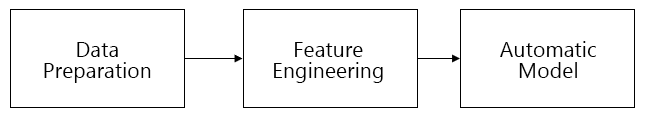

#### <center><b>Preparación automática de los datos</b></center>

La primera etapa de un proceso típico de aprendizaje automático consiste en la preparación de los datos. Hay dos aspectos principales que deben tenerse en cuenta: la limpieza de datos y la síntesis de datos. 

- La limpieza de datos consiste en mejorar la calidad de los datos mediante la comprobación de los tipos de datos erróneos, los valores que faltan y los errores, y mediante la aplicación de la normalización de datos, la bucketización, el escalado y la codificación. Una canalización AutoML robusta debería automatizar todos estos pasos mundanos, pero extremadamente importantes, en la medida de lo posible.

- La síntesis de datos consiste en generar datos sintéticos mediante el aumento para el entrenamiento, evaluación y validación. Normalmente, este paso es específico del dominio. Por ejemplo, hemos visto hemos visto cómo generar imágenes sintéticas similares a las de CIFAR10 mediante operaciones de recorte, rotación, cambio de tamaño y volteo. También se puede pensar en generar imágenes o vídeos adicionales mediante GAN y utilizar el conjunto de datos sintéticos aumentados para el entrenamiento. En el caso del texto, es posible entrenar las RNN para generar texto sintético o adoptar más técnicas de PLN, como BERT, seq2seq o Transformers, para anotar o traducir el texto a otros idiomas y luego volver a traducirlo al original: otra forma de aumento específica del dominio.

#### <center><b>Ingeniería de características automática</b></center>

La ingeniería de características es el segundo paso de un proceso típico de aprendizaje automático. Consta de tres pasos principales: selección de características, construcción de características y construcción de características y el mapeo de características. Veamos cada una de ellas:

- La selección de características tiene como objetivo seleccionar un subconjunto de características significativas descartando descartando las que contribuyen poco a la tarea de aprendizaje. En este contexto, significativo depende realmente de la aplicación y del dominio de su problema específico. problema específico.
- La construcción de características tiene como objetivo construir nuevas características derivadas, partiendo de las básicas. Con frecuencia, esta técnica se utiliza para permitir una mejor generalización y tener una representación más rica de los datos.
- La extracción de características tiene como objetivo alterar el espacio de características original mediante una función de mapeo. Esto puede implementarse de múltiples maneras; por ejemplo, puede utilizar autocodificadores, PCA o clustering.

#### <center><b>Generación automática de modelos</b></center>

La generación del modelo y el ajuste de los hiperparámetros es el tercer paso típico de un
de un proceso de aprendizaje automático.

La generación de modelos consiste en crear un modelo adecuado para resolver tareas específicas. Por ejemplo, es probable que utilice CNN para el reconocimiento visual, y que utilice RNN para el análisis de series temporales o para secuencias. Por supuesto, son posibles muchas variantes posibles, cada una de las cuales se elabora manualmente mediante un proceso de prueba y error, y funciona para dominios muy específicos.

El ajuste de los hiperparámetros se lleva a cabo una vez que el modelo se ha elaborado manualmente. Este proceso Este proceso suele ser muy costoso desde el punto de vista informático y puede cambiar significativamente la calidad de los resultados de forma positiva. calidad de los resultados de forma positiva. Esto se debe a que el ajuste de los hiperparámetros puede ayudar a optimizar aún más nuestro modelo.

La generación automática de modelos es el objetivo final de cualquier proceso de AutoML. ¿Cómo ¿Cómo se puede conseguir? Un enfoque consiste en generar el modelo combinando un conjunto de operaciones primitivas que incluyen la convolución, la agrupación, la concatenación conexiones, redes neuronales recurrentes, autocodificadores, y prácticamente todos los modelos de aprendizaje profundo que hemos encontrado a lo largo de este libro. Estas operaciones  constituyen un espacio de búsqueda (normalmente muy grande) que hay que explorar, y el objetivo es  hacer esta exploración tan eficiente como sea posible. En la jerga de AutoML, la exploración se llama llamada NAS, o Búsqueda de Arquitectura Neural.

#### <center><b>Google Cloud AutoML</b></center>

Cloud AutoML (https://cloud.google.com/automl/) es un conjunto completo de productos para el procesamiento de imágenes, vídeos y textos. A partir de finales de 2019, la suite está formada por los siguientes componentes, que no requieren que se conozca cómo las redes de aprendizaje profundo redes de aprendizaje profundo están conformadas internamente:

**Tablas AutoML**
- Permite construir e implementar automáticamente modelos de aprendizaje automático de última generación
de aprendizaje automático de última generación sobre datos estructurados utilizados para la clasificación supervisada general
y regresión supervisadas generales (véanse los capítulos 1, 2 y 3).

**AutoML Visión**
- AutoML Vision: Le permite entrenar modelos de aprendizaje automático para clasificar sus imágenes según sus propias etiquetas definidas.
- AutoML Detección de Objetos: Permite construir automáticamente un modelo personalizado para detectar objetos en una imagen con cuadros delimitadores y etiquetas, y luego desplegarlo en la nube o en el borde.

**AutoML Lenguaje Natural**
- Clasificación de texto AutoML: Se utiliza para construir automáticamente un modelo de aprendizaje para clasificar el contenido en un conjunto de categorías personalizado.
- AutoML Análisis de Sentimiento: Se utiliza para construir automáticamente un modelo de aprendizaje automático para analizar el sentimiento expresado en el texto.
- Extracción de entidades AutoML: Se utiliza para construir automáticamente un modelo de aprendizaje automático para reconocer un conjunto personalizado de entidades dentro del texto.
- API de lenguaje natural en la nube: Utiliza el modelo preentrenado de Google para la clasificación general de contenidos, el análisis de sentimientos y el reconocimiento de entidades.

**Inteligencia de vídeo AutoML**
- Clasificación de AutoML Video Intelligence: Se utiliza para construir automáticamente un modelo personalizado para clasificar imágenes, y luego desplegarlo en la nube o en el borde.

**Traducción AutoML**
- Traducción AutoML: Construido sobre la potente API de traducción de Google con las palabras, frases y modismos que necesites.

## <center><b>Capítulo 15: Las matemáticas detrás del Aprendizaje Profundo</b></center>

### <center><b>Derivadas y gradientes en todas partes</b></center>

Las derivadas son una poderosa herramienta matemática. Vamos a utilizar las derivadas y los gradientes para optimizar nuestra red. Veamos la definición. La derivada de una función y = f(x) de una variable x es una medida de la velocidad a la que cambia el valor y de la función con respecto al cambio de la variable x. Si x e y son números reales, y si la gráfica de f se representa contra x, la derivada es la "pendiente" de esta gráfica en cada punto.

El gradiente es una generalización de la derivada para múltiples variables. Obsérvese que la derivada de una función de una sola variable es una función de valor escalar, mientras que el gradiente de una función de varias variables es una función de valor vectorial. El gradiente de gradiente se denota con un delta invertido ∇ , y se llama del. o nabla del alfabeto griego. Esto tiene sentido ya que delta indica el cambio en una variable, y el gradiente es el cambio en todas las variables. 

### <center><b>Funciones de activación</b></center>

**Derivada de la sigmoidea**

Recordemos que la sigmoide se define como:

<center>$𝜎(𝑧)=1/1+𝑒^{-z}$</center>

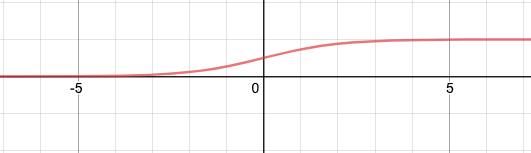

**Derivada de tanh**

Recordemos que la función arctan se define como:

<center>$than(z) = (e^z-e^{-z})/(e^z+e^{-z})$</center>

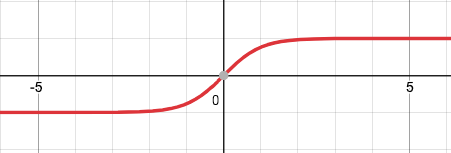

**Derivada de ReLU**

La función ReLU se define como:

<center>$f(x) = max(0, x)$</center>

La derivada de ReLU es:

<center>$$f'(x) = \left\{ \begin{array}{lcc} 1,\; \text{si} \;x>0 \\ 0,\; \text{if} \; \text{de otra manera} \end{array} \right.$$</center>

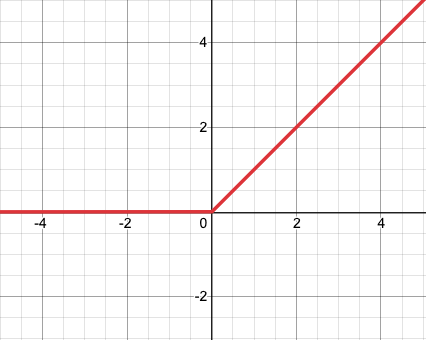


### <center><b>Retropropagación</b></center>
La retropropagación puede describirse como una forma de corregir progresivamente corregir los errores tan pronto como se detectan. Para reducir los errores cometidos por una red neuronal, debemos entrenar la red. El entrenamiento necesita un conjunto de datos que incluya los valores de entrada y el correspondiente valor de salida real. Queremos utilizar la red para predecir la salida lo más cerca posible del valor de salida verdadero. La intuición clave del algoritmo de retropropagación es actualizar los pesos de las conexiones basándose en el error medido en la(s) neurona(s) de salida. En el resto de esta sección, explicaremos cómo formalizar esta intuición.

Cuando se inicia la retropropagación, todos los pesos tienen alguna asignación aleatoria. A continuación, la red se activa para cada entrada del conjunto de entrenamiento: los valores se propagan hacia adelante desde la etapa de entrada, a través de las etapas ocultas, hasta la etapa de salida, donde se realiza una predicción.

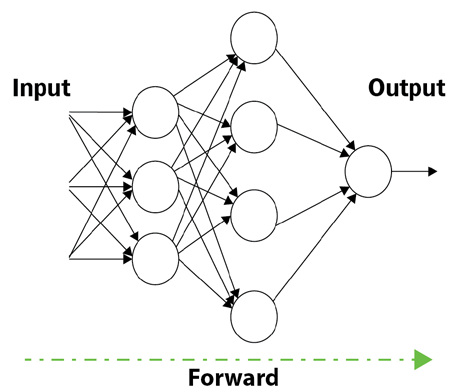

La forma más fácil de pensar en el backtracking es propagar el error hacia atrás, utilizando un algoritmo optimizador apropiado como el descenso de gradiente para ajustar los pesos de la red neuronal con el objetivo de reducir el error.

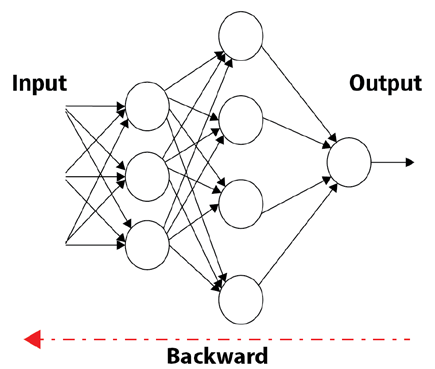

### <center><b>Pensando en la retropropagación y las redes de convección</b></center>

En esta sección queremos dar una intuición detrás de la retropropagación y las redes de convolución. Para simplificar, nos centraremos en un ejemplo de convolución con una entrada X de tamaño 3 × 3, un único filtro W de tamaño 2 × 2 sin relleno, zancada 1 y sin dilatación. La generalización se deja como ejercicio.

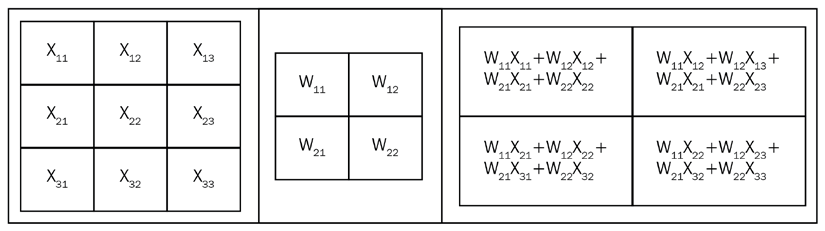

Siguiendo la intuición, ahora podemos centrar nuestra atención en el paso hacia atrás de la capa actual. La suposición clave es que recibimos una señal retropropagada $\frac{\partial L}{\partial h_{ij}}$ como entrada, y necesitamos calcular $\frac{\partial L}{\partial w_{ij}}$ y $\frac{\partial L}{\partial x_{ij}}$. Este cálculo se deja como un ejercicio, pero tenga en cuenta que cada peso en el filtro contribuye a cada píxel en el mapa de salida o, en otras palabras, cualquier cambio en un peso de un filtro afecta a todos los píxeles de salida.

### <center><b>Pensando en la retropropagación y en las RNNs</b></center>

La ecuación básica para una RNN es $s_t = tahn(U_{𝑥𝑡} + W_{𝑠𝑡-1})$, la predicción final es $𝑦_𝑡 = softmax(V_{S_t})$ en el paso $t$, el valor correcto es $y_t$, y el error E es la entropía cruzada. Aquí U, V, W son parámetros de aprendizaje utilizados para las ecuaciones de las RNNs. La idea central es que el error total es sólo la suma de los errores en cada paso de tiempo. 

### <center><b>Una nota sobre TensorFlow y la diferenciación automática diferenciación</b></center>

TensorFlow puede calcular automáticamente las derivadas, una característica llamada Automatic Diferenciación Automática. Esto se consigue utilizando la regla de la cadena. Cada nodo en el Cada nodo en el gráfico computacional tiene una operación de gradiente adjunta para calcular las derivadas de la entrada con respecto a la salida. Después, los gradientes con respecto a los parámetros se calculan automáticamente durante la retropropagación.

La diferenciación automática es una característica muy importante porque no es necesario codificar a mano nuevas variaciones de la retropropagación para cada nuevo modelo de una red neuronal. Esto permite una iteración rápida y ejecutar muchos experimentos con mayor rapidez.

## <center><b>Capítulo 16: Unidad de procesamiento tensorial</b></center>

Este capítulo presenta la Unidad de Procesamiento de Tensores (TPU), un chip especial desarrollado en Google para la ejecución ultrarrápida de operaciones matemáticas de de redes neuronales. Al igual que las Unidades de Procesamiento Gráfico (GPU), la idea aquí es tener un procesador especial centrado únicamente en operaciones matriciales muy rápidas, sin soporte para todas las demás operaciones que normalmente soportan las Unidades Centrales de Procesamiento (CPU). Sin embargo, la mejora adicional de las TPU consiste en eliminar del chip cualquier soporte de hardware para las operaciones gráficas normalmente presentes en las GPU (rasterización mapeo de texturas, operaciones de memoria intermedia, etc.). Piense en una TPU como un coprocesador especial para el aprendizaje profundo, centrado en operaciones matriciales o tensoriales. operaciones tensoriales. En este capítulo vamos a comparar las CPU y las GPU con las tres generaciones de TPUs y los TPUs Edge. Todos estos aceleradores están disponibles a partir de noviembre de 2019.

### <center><b>CPUs y GPUs</b></center>

Probablemente estés algo familiarizado con el concepto de CPU, un chip de propósito general que se encuentra en cada ordenador, tableta y smartphone. Las CPU se encargan de todos los cálculos: desde los controles lógicos hasta la aritmética, pasando por las operaciones de registro, las operaciones con la memoria y mucho más. Las CPU están sujetas a la conocida ley de Moore, que establece que el número de transistores en un circuito integrado denso se duplica aproximadamente cada dos años.

Una de las mejoras vino de la mano de las llamadas GPU: chips de propósito especial que son perfectos para operaciones gráficas rápidas como la multiplicación de matrices, la rasterización manipulación de la memoria intermedia, mapeo de texturas y muchas otras. Además de gráficos por ordenador en los que se aplican multiplicaciones matriciales a los píxeles de las imágenes, las GPU también resultaron ser un gran complemento para el aprendizaje profundo. Esta es una curiosa historia de serendipia: un gran ejemplo de una tecnología creada para un objetivo y que luego conoce éxito asombroso en un ámbito que no tiene nada que ver con el que se concibió originalmente. originalmente.

### <center><b>TPUs</b></center>

Google decidió que necesitaba algo completamente nuevo; algo que permitiera multiplicar por 10 el rendimiento sin un aumento significativo del coste. Así nació la TPU v1. Lo impresionante es que sólo se tardó 15 meses desde el diseño inicial hasta la producción. Puedes encontrar más detalles sobre esta historia en Jouppi et al., 2014 donde también se informa de un informe detallado sobre diferentes cargas de trabajo de inferencia vistas en Google en 2013.

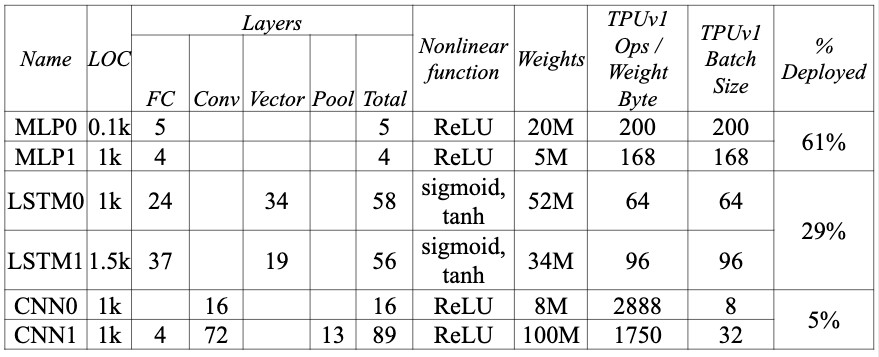

### <center><b>TPU de primera generación</b></center>

La primera generación de TPU (TPU v1) se anunció en mayo de 2016 en Google I/O. La TPU v1 admite la multiplicación de matrices utilizando aritmética de 8 bits. La TPU v1 está especializada en la inferencia del aprendizaje profundo, pero no funciona para el entrenamiento. Para el entrenamiento es necesario realizar operaciones de punto flotante, como se comenta en los siguientes párrafos. Una función clave de TPU es la multiplicación matricial "sistólica". Veamos qué significa esto. Recordemos que el núcleo del aprendizaje profundo es un producto central $Y=X*W$, donde, por ejemplo, la operación básica para calcular $Y[i,0]$ es:

<center>$𝑌[𝑖, 0] = 𝑋[𝑖, 0] ∗ 𝑊[0,0] + 𝑋[𝑖, 1] ∗ 𝑊[1,0] + ⋯ + 𝑋[𝑖, 𝑛] ∗ 𝑊[𝑛, 0]$</center>

La multiplicación matricial "sistólica" permite calcular múltiples valores de Y[i, j] en en paralelo. Los datos fluyen de forma coordinada y, de hecho, en medicina el término "sistólica" se refiere a las contracciones del corazón y a cómo la sangre fluye rítmicamente en nuestras venas. Aquí sistólica se refiere al flujo de datos que pulsa dentro de la TPU. Se puede demostrar que un algoritmo de multiplicación sistólica es menos costoso que el de fuerza bruta. La TPU v1 tiene una Unidad de Multiplicación de Matrices (MMU) que ejecuta multiplicaciones sistólicas en 256×256 núcleos, de modo que se pueden calcular 64l.000 multiplicaciones en paralelo en una sola toma. Además, la TPU v1 se encuentra en un bastidor y no es accesible directamente. En su lugar, una CPU actúa como anfitrión controlando la transferencia de datos y enviando órdenes a la TPU para realizar multiplicaciones tensoriales, para calcular convoluciones y para aplicar funciones de activación.

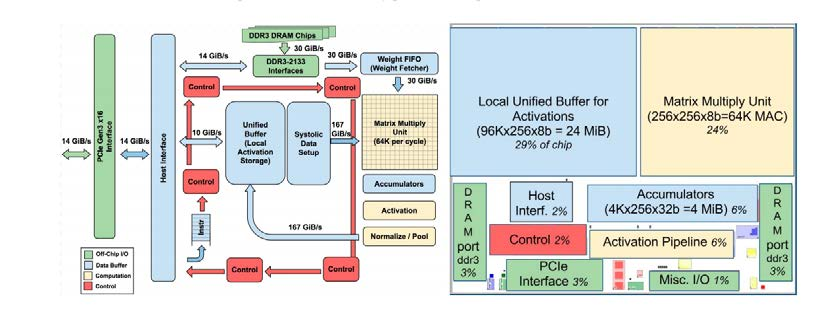

### <center><b>TPU de segunda generación</b></center>

Las TPU de segunda generación (TPU2) se anunciaron en 2017. En este caso, el ancho de banda de la memoria aumenta a 600 GB/s y el rendimiento alcanza los 45 TFLOPS. 4 TPU2 se disponen en un módulo con un rendimiento de 180 TFLOPS. A continuación, 64 módulos se agrupan en un pod con 11,5 PFLOPS de rendimiento. Las TPU2 adoptan la aritmética de punto flotante y, por tanto, son adecuadas tanto para el entrenamiento como para la inferencia.

La TPU2 cuenta con una MMU para las multiplicaciones matriciales de 128x128 núcleos y una Vector (VPU) para todas las demás tareas, como la aplicación de activaciones. La VPU se encarga de los cálculos de float32 e int32. La MXU, por su parte, opera en un formato de precisión mixta de 16-32 bits en coma flotante.

Cada chip de la TPU v2 tiene dos núcleos, y en cada placa se montan hasta 4 chips. En TPU v2, Google adoptó un nuevo modelo de punto flotante llamado bfloat 16. La idea es sacrificar algo de resolución pero seguir siendo muy bueno para el aprendizaje profundo. Esta reducción en la resolución le permite mejorar el rendimiento de las TPU v2, que son más eficientes desde el punto de vista energético que la v1. De hecho, se puede demostrar que una mantisa más pequeña ayuda a a reducir el área física del silicio y la potencia del multiplicador. Por lo tanto, el bfloat16 utiliza el mismo formato estándar de punto flotante de precisión simple IEEE 754, pero trunca el campo de la mantisa de 23 bits a sólo 7 bits. La conservación de los bits del exponente permite el formato para mantener el mismo rango que la precisión simple de 32 bits. Esto permite una conversión relativamente más sencilla entre los dos tipos de datos.

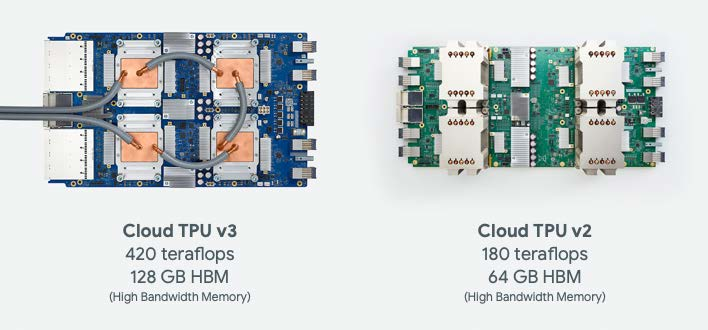

### <center><b>TPU de tercera generación</b></center>

Las TPU de tercera generación (TPU3) se anunciaron en 2018. Las TPU3 son 2 veces más rápidas que las TPU2 y están agrupadas en vainas 4 veces más grandes. En total, se trata de un aumento de rendimiento de 8x. Los pods de TPU v3 en la nube pueden ofrecer más de 100 PetaFLOPS de potencia de cálculo. 

La placa TPU v3 tiene 4 chips TPU, 8 núcleos y refrigeración líquida. Google ha adoptado un hardware de interconexión de ultra alta velocidad derivado de la tecnología de los superordenadores para conectar miles de TPUs con una latencia muy baja. Cada vez que un parámetro se actualiza en una sola TPU, todas las demás son informadas a través de un algoritmo de reducción de todo, típicamente adoptado para la computación en paralelo. Por lo tanto, se puede pensar en TPU v3 como uno de los superordenadores más rápidos disponibles en la actualidad para operaciones matriciales y tensoriales con miles de TPUs en su interior.

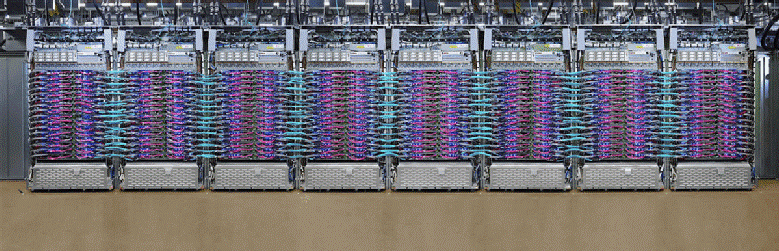



In [ ]:
!wget -nc https://raw.githubusercontent.com/brpy/colab-pdf/master/colab_pdf.py
from colab_pdf import colab_pdf
colab_pdf('/content/drive/MyDrive/Colab Notebooks/CIC/1 semestre/Matemáticas para las ciencias de la computación/Tarea 6.ipynb')

File ‘colab_pdf.py’ already there; not retrieving.





Extracting templates from packages: 100%
